In [1]:
!pip install tensorflow
!pip install xgboost
!pip install shap
!pip install keras 


Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


Defaulting to user installation because normal site-packages is not writeable


In [2]:
!pip install pydot 
!pip install graphviz

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [3]:
from datetime import datetime as dt
from sklearn.metrics import roc_curve, auc ,roc_auc_score
import numpy as np
import pandas as pd
import shap
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report
from scipy import signal
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
import keras 
from tensorflow.keras.models import Sequential 
from tensorflow.keras.utils import to_categorical
from keras.layers import Activation, Dense
from sklearn.model_selection import train_test_split
import tensorflow.compat.v1.keras.backend as K
import tensorflow as tf
tf.compat.v1.disable_eager_execution()
tf.compat.v1.disable_v2_behavior()
from tensorflow.keras.utils import plot_model

Instructions for updating:
non-resource variables are not supported in the long term


In [4]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_fscore_support
import matplotlib.pyplot as plt
from itertools import cycle
from sklearn import metrics

In [5]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
  # Restrict TensorFlow to only use the first GPU
  try:
    tf.config.set_visible_devices(gpus[0], 'GPU')
    logical_gpus = tf.config.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPU")
  except RuntimeError as e:
    # Visible devices must be set before GPUs have been initialized
    print(e)

In [6]:
base = '/home/r.islam/code/dataset5user/'
Intencity = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]

class EEG:
    def __init__(self, participant):
        self.int = {}
        self.delta = {}
        self.theta = {}
        self.alpha = {}
        self.beta = {}
        self.gamma = {}

        for I in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]:
            self.int[I] = np.loadtxt(base +'Participant '+str(participant)+'/Cubes for spectra/Backgr_int_'+str(I)+'_type_0.4.dat')
            delta_signal = np.empty(self.int[I].shape)
            theta_signal =  np.empty(self.int[I].shape)
            alpha_signal = np.empty(self.int[I].shape)
            beta_signal = np.empty(self.int[I].shape)
            gamma_signal = np.empty(self.int[I].shape)
            for c in range(self.int[I].shape[1]):
                delta_signal[:,c], theta_signal[:,c],alpha_signal[:, c], beta_signal[:, c],gamma_signal[:,c] = self.fir_filtering(I, c)
            self.delta[I] = delta_signal
            self.theta[I] = theta_signal
            self.alpha[I] = alpha_signal
            self.beta[I] = beta_signal 
            self.gamma[I] = gamma_signal
    def fir_filtering(self, I, c):
        filter_delta = signal.firwin(400, [1.0, 4.0], pass_zero=False, fs=250)
        filter_theta = signal.firwin(400, [5.0, 8.0], pass_zero=False, fs=250)
        filter_alpha = signal.firwin(400, [8.0, 12.0], pass_zero=False, fs=250)
        filter_beta = signal.firwin(400, [13.0, 30.0], pass_zero=False, fs=250)
        filter_gamma = signal.firwin(400, [31.0, 45.0], pass_zero=False, fs=250)
        res_delta = signal.convolve(self.int[I][:, c], filter_delta, mode='same')
        res_theta = signal.convolve(self.int[I][:, c], filter_theta, mode='same')
        res_alpha = signal.convolve(self.int[I][:, c], filter_alpha, mode='same')
        res_beta = signal.convolve(self.int[I][:, c], filter_beta, mode='same')
        res_gamma = signal.convolve(self.int[I][:, c], filter_gamma, mode='same')
        return res_delta,res_theta, res_alpha,res_beta,res_gamma 

In [7]:

def createdataframe(signal_fiq):
  global Intencity
  tem_signal = []
  print(signal_fiq)
  for p in range(1, 6):
    eeg_person = EEG(p)
    for i in Intencity:
      for ch in range(0,31):
        S = 'tem_signal.append(np.append(eeg_person.'+signal_fiq+'.get(i)[:,ch][0:15000],i))' 
        eval(S)
    

  return pd.DataFrame(tem_signal) 

In [8]:
def shap_explaner(model,X_test):
  shap.initjs()
  e = shap.DeepExplainer(model, X_test)
  shap_values = e.shap_values(X_test[1:5])
  return shap.summary_plot(shap_values,X_test)

In [9]:
def removecolunm(ytext):
  return np.delete(to_categorical(ytext.astype(int).to_numpy()), 0, 1)

In [10]:
def ROC_plot(y_test,y_score):
    n_classes = 10




# Compute ROC curve and ROC area for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
    fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    colors = cycle(['blue', 'red', 'green', 'teal','hotpink','blue','coral','tan','navy','gold'])
    for i, color in zip(range(n_classes), colors):
        plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))
    plt.plot([0, 1], [0, 1], 'k--', lw=2)
    plt.xlim([-0.05, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic for multi-class data')
    plt.legend(loc="lower right")
    plt.show()
    return 0

In [11]:
# Creating a function to report confusion metrics
def confusion_metrics (conf_matrix):
  
    
    print(conf_matrix)
# save confusion matrix and slice into four pieces
    TP = conf_matrix[1][1]
    TN = conf_matrix[0][0]
    FP = conf_matrix[0][1]
    FN = conf_matrix[1][0]
    
    fp = conf_matrix.sum(axis=0) - np.diag(conf_matrix) 
    fn = conf_matrix.sum(axis=1) - np.diag(conf_matrix)
    tp = np.diag(conf_matrix)
    tn = conf_matrix.sum() - (FP + FN + TP)
    print('True Positives:', TP,tp)
    print('True Negatives:', TN,tn)
    print('False Positives:', FP,fp)
    print('False Negatives:', FN,fn)
    
    # calculate accuracy
    conf_accuracy = (float (TP+TN) / float(TP + TN + FP + FN))
    
    # calculate mis-classification
    conf_misclassification = 1- conf_accuracy
    
    # calculate the sensitivity
    conf_sensitivity = (TP / float(TP + FN))
    # calculate the specificity
    conf_specificity = (TN / float(TN + FP))
    
    # calculate precision
    conf_precision = (TN / float(TN + FP))
    # calculate f_1 score
    conf_f1 = 2 * ((conf_precision * conf_sensitivity) / (conf_precision + conf_sensitivity))
    print('-'*50)
    print(f'Accuracy: {round(conf_accuracy,2)}') 
    print(f'Mis-Classification: {round(conf_misclassification,2)}') 
    print(f'Sensitivity: {round(conf_sensitivity,2)}') 
    print(f'Specificity: {round(conf_specificity,2)}') 
    print(f'Precision: {round(conf_precision,2)}')
    print(f'f_1 Score: {round(conf_f1,2)}') 
    return 0

In [12]:
def report(y_score,y_test_original,y_pred):
    S = set(y_test_original) 
    print ("Current level"+str(S))
#    print("confusion matrix \n\n", confusion_matrix(np.argmax(y_score, axis=1).tolist(),y_test_original.tolist()))
#    print("\naccuracy score= ",accuracy_score(np.argmax(y_pred, axis=1).tolist(),y_test_original.tolist()))
#    print("\nclassification report\n")
#    print(classification_report(np.argmax(y_pred, axis=1).tolist(),y_test_original.tolist()))
    res = []
    for l in S:
        try:
            prec,recall,_,_ = precision_recall_fscore_support(np.array(y_test_original.tolist())==l,
                                                      np.array(np.argmax(y_score, axis=1).tolist())==l,
                                                      pos_label=True,average=None,zero_division=0)
            res.append([l,recall[0],recall[1]])
        except (RuntimeError, TypeError, NameError): 
            pass 
    print("\n",pd.DataFrame(res,columns = ['class','sensitivity','specificity']))
    
    return 0

In [13]:

def modelidea(sin,R,opt):
    start = dt.now()
    RT = R
    if R=='rule':
        R='relu'
        RT ='relu'
    elif R =='tanh':
        R = 'tanh'
        RT = 'tanh'
    elif R == 'mix':
        R = 'tanh'
        RT = 'relu'
    elif R == 'umix':
        R = 'relu'
        RT = 'tanh'
        
    print(R,RT)
    print("\n")
    print('Singal='+sin + ' layer='+ R + ' optimizer=' + opt)

    df_theta= createdataframe(sin)
    df_new = df_theta.copy()
    y = df_new.iloc[:,-1] *10 
    X = df_new.iloc[:, :-1]

    X_train, X_rem, y_train, y_rem = train_test_split(X,y, train_size=0.8,random_state=42) 
    X_valid, X_test, y_valid, y_test = train_test_split(X_rem,y_rem, test_size=0.5)

    y_test_original = y_test
 
    X_train = X_train.to_numpy()
    X_test = X_test.to_numpy()
    X_valid = X_valid.to_numpy()
    y_train = removecolunm(y_train)
    y_test = removecolunm(y_test)
    y_valid = removecolunm(y_valid)
    keras.backend.clear_session()
    model = Sequential()
    model.add(Dense(2500, input_shape= (X_train.shape[1],) ,activation=R))
    model.add(Dense(1000, activation=R))
    model.add(Dense(500, activation=RT))
    model.add(Dense(200, activation=R))
    model.add(Dense(100, activation=RT))
    model.add(Dense(50, activation=R))
    model.add(Dense(25, activation=RT))
    model.add(Dense(15, activation=R))
    model.add(Dense(10, activation='softmax'))
    model.compile(optimizer=opt,
             loss='categorical_crossentropy',
             metrics=['accuracy'])
    model.summary()


    callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=20) 

    history = model.fit(X_train,y_train, epochs=100, batch_size=10,verbose=2,validation_data=(X_valid,y_valid),callbacks=[callback])
    try:
        y_score = model.predict(X_test)
        running_secs = (dt.now() - start).seconds 
        print("\n\n\nTotal time = ",running_secs, "s for this model\n\n\n\n")
        classification_report_sin = classification_report(y_test, np.round(np.round(y_score,decimals= 1)))
#        plot_model(model, show_shapes=True, rankdir="LR")
        print(classification_report_sin)
        shap_explaner(model,X_test)
      #  y_score = model.predict(X_test)
        y_pred = y_score.tolist()
     #   classification_report_theta = classification_report(y_test, np.round(np.round(model.predict(y_score),decimals= 1)))
        running_secs = (dt.now() - start).seconds  
        
   #     confusion_metrics(metrics.confusion_matrix(np.argmax(y_test, axis=1), np.argmax(y_pred, axis=1)))
     #   plot_model(model, show_shapes=True, rankdir="LR")
      #  print(classification_report_theta , "\ninside\n\n")
    #    shap_explaner(model,X_test)
    
        res = []
        S = set(y_test_original)
        for l in S:
            try:
                prec,recall,_,_ = precision_recall_fscore_support(np.array(y_test_original.tolist())==l,
                                                      np.array(np.argmax(y_score, axis=1).tolist())==l,
                                                      pos_label=True,average=None,zero_division=0)
                res.append([l,recall[0],recall[1]])
            except :
                pass
        
        tem_res = pd.DataFrame(res,columns = ['class','sensitivity','specificity'])
        print(tem_res)
        print(tem_res.mean())
    

        plt.plot(history.history['acc'])
        plt.plot(history.history['loss'])
        plt.title('model accuracy')
        plt.ylabel('accuracy')
        plt.xlabel('epoch')
        plt.legend(['acc', 'loss'], loc='upper left')
        plt.show()


        plt.plot(history.history['val_acc'])
        plt.plot(history.history['val_loss'])
        plt.title('model accuracy validation')
        plt.ylabel('accuracy')
        plt.xlabel('epoch')
        plt.legend(['acc', 'loss'], loc='upper left')
        plt.show()
        
        
        
        print("\n\n\n\n")
        plt.plot(history.history['acc'])
        plt.plot(history.history['val_acc'])
        plt.title('model accuracy')
        plt.ylabel('accuracy')
        plt.xlabel('epoch')
        plt.legend(['train', 'val'], loc='upper left')
        plt.show()
        
        print("\n\n\n\n")
        
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.title('model loss')
        plt.ylabel('loss')
        plt.xlabel('epoch')
        plt.legend(['train', 'val'], loc='upper left')
        plt.show()
 #       print("confusion matrix \n\n", confusion_matrix(np.argmax(y_score, axis=1).tolist(),y_test_original.tolist()))
   #     print("\naccuracy score= ",accuracy_score(np.argmax(y_score, axis=1).tolist(),y_test_original.tolist()))
    #    print("\n\n\n\nfunction")
        ROC_plot(y_test,y_score)
    #    report(y_score,y_test_original, y_test)

        
        
    except ValueError as error:
        print(str(error))
        print('for  '+'Singal='+sin + ' layer='+ R + ' optimizer=' + opt)
        
    
    return 0

In [14]:
sig = ['delta','theta','alpha','beta','gamma'] 
layer = ['tanh','relu','mix','umix']
optimizer = ['rmsprop','adam','nadam','sgd','adadelta','adagrad','adamax','ftrl']

tanh tanh


Singal=delta layer=tanh optimizer=rmsprop
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 39s - loss: 0.3443 - acc: 0.9605 - val_loss: 0.3214 - val_acc: 0.9355
Epoch 3/100
1240/1240 - 40s - loss: 0.1250 - acc: 0.9927 - val_loss: 0.2155 - val_acc: 0.9484
Epoch 4/100
1240/1240 - 39s - loss: 0.0523 - acc: 0.9960 - val_loss: 0.1433 - val_acc: 0.9677
Epoch 5/100
1240/1240 - 39s - loss: 0.0329 - acc: 0.9944 - val_loss: 0.1442 - val_acc: 0.9677
Epoch 6/100
1240/1240 - 39s - loss: 0.0083 - acc: 1.0000 - val_loss: 0.1521 - val_acc: 0.9742
Epoch 7/100
1240/1240 - 39s - loss: 0.0108 - acc: 0.9984 - val_loss: 0.2048 - val_acc: 0.9742
Epoch 8/100
1240/1240 - 38s - loss: 0.0012 - acc: 1.0000 - val_loss: 0.2248 - val_acc: 0.9742
Epoch 9/100
1240/1240 - 39s - loss: 4.2155e-04 - acc: 1.0000 - val_loss: 0.2509 - val_acc: 0.9742
Epoch 10/100
1240/1240 - 39s - loss: 1.4676e-04 - acc: 1.0000 - val_loss: 0.2746 - val_acc: 0.9742
Epoch 11/100
1240/1240 - 39s - loss: 5.2336e-05 - acc: 1.0000 - val_loss: 0.2981 - val_acc: 0.9742
Epoch 12/100
1240/1240 - 39s - loss: 1.9110e-0

1240/1240 - 39s - loss: 8.6523e-10 - acc: 1.0000 - val_loss: 0.4177 - val_acc: 0.9742
Epoch 86/100
1240/1240 - 38s - loss: 1.1536e-09 - acc: 1.0000 - val_loss: 0.4178 - val_acc: 0.9742
Epoch 87/100
1240/1240 - 39s - loss: 6.7296e-10 - acc: 1.0000 - val_loss: 0.4180 - val_acc: 0.9742
Epoch 88/100
1240/1240 - 38s - loss: 1.0575e-09 - acc: 1.0000 - val_loss: 0.4181 - val_acc: 0.9742
Epoch 89/100
1240/1240 - 38s - loss: 8.6523e-10 - acc: 1.0000 - val_loss: 0.4183 - val_acc: 0.9742
Epoch 90/100
1240/1240 - 39s - loss: 9.6137e-10 - acc: 1.0000 - val_loss: 0.4184 - val_acc: 0.9742
Epoch 91/100
1240/1240 - 39s - loss: 8.6523e-10 - acc: 1.0000 - val_loss: 0.4186 - val_acc: 0.9742
Epoch 92/100
1240/1240 - 38s - loss: 9.6137e-10 - acc: 1.0000 - val_loss: 0.4187 - val_acc: 0.9742
Epoch 93/100
1240/1240 - 39s - loss: 9.6137e-10 - acc: 1.0000 - val_loss: 0.4189 - val_acc: 0.9742
Epoch 94/100
1240/1240 - 39s - loss: 7.6909e-10 - acc: 1.0000 - val_loss: 0.4190 - val_acc: 0.9742
Epoch 95/100
1240/1240 

keras is no longer supported, please use tf.keras instead.
Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


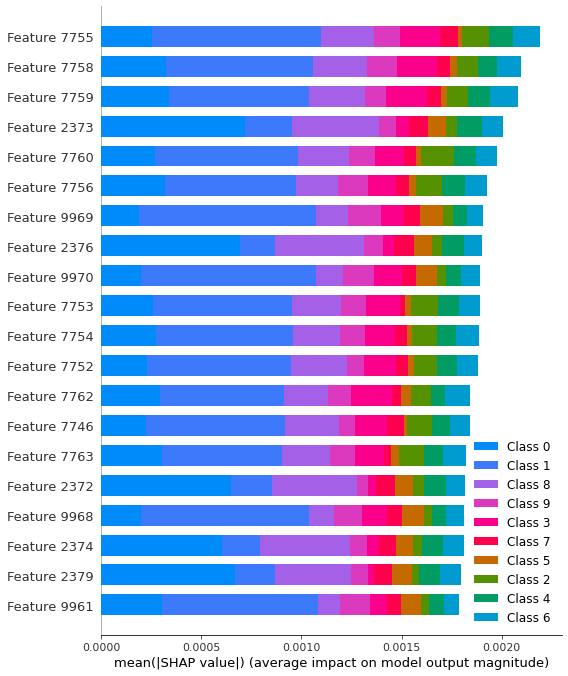

   class  sensitivity  specificity
0    1.0     0.859155          0.0
1    2.0     0.911765          0.0
2    3.0     0.888889          0.0
3    4.0     0.913043          0.0
4    5.0     0.909091          0.0
5    6.0     0.901408          0.0
6    7.0     0.886525          0.0
7    8.0     0.833333          0.0
8    9.0     0.878788          0.0
9   10.0     1.000000          0.0
class          5.5000
sensitivity    0.8982
specificity    0.0000
dtype: float64


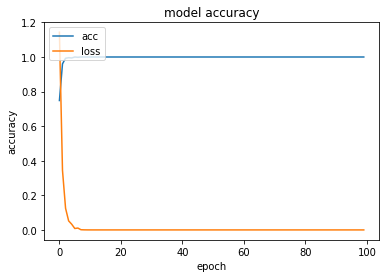

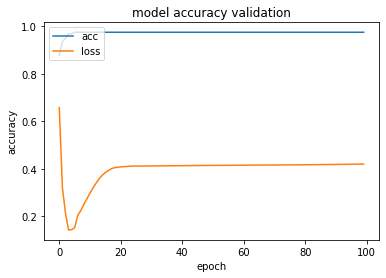

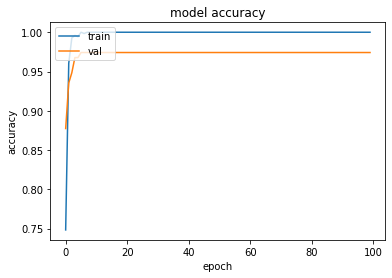

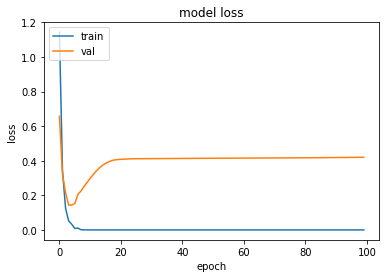

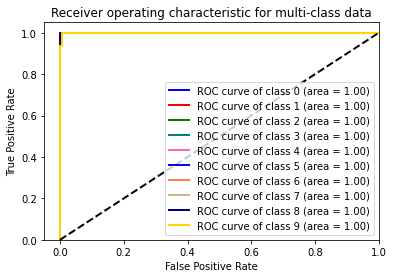

tanh tanh


Singal=delta layer=tanh optimizer=adam
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 16s - loss: 0.3668 - acc: 0.9734 - val_loss: 0.3774 - val_acc: 0.9355
Epoch 3/100
1240/1240 - 16s - loss: 0.1957 - acc: 0.9855 - val_loss: 0.2769 - val_acc: 0.9613
Epoch 4/100
1240/1240 - 16s - loss: 0.1426 - acc: 0.9831 - val_loss: 0.2373 - val_acc: 0.9548
Epoch 5/100
1240/1240 - 16s - loss: 0.0852 - acc: 0.9927 - val_loss: 0.2246 - val_acc: 0.9548
Epoch 6/100
1240/1240 - 16s - loss: 0.0976 - acc: 0.9806 - val_loss: 0.2826 - val_acc: 0.9355
Epoch 7/100
1240/1240 - 16s - loss: 0.0566 - acc: 0.9952 - val_loss: 0.1982 - val_acc: 0.9548
Epoch 8/100
1240/1240 - 16s - loss: 0.0293 - acc: 0.9992 - val_loss: 0.1848 - val_acc: 0.9677
Epoch 9/100
1240/1240 - 16s - loss: 0.0203 - acc: 1.0000 - val_loss: 0.1697 - val_acc: 0.9677
Epoch 10/100
1240/1240 - 16s - loss: 0.0168 - acc: 1.0000 - val_loss: 0.1621 - val_acc: 0.9677
Epoch 11/100
1240/1240 - 16s - loss: 0.0143 - acc: 1.0000 - val_loss: 0.1596 - val_acc: 0.9677
Epoch 12/100
1240/1240 - 16s - loss: 0.0123 - acc: 1.0000 

Epoch 87/100
1240/1240 - 16s - loss: 4.2869e-05 - acc: 1.0000 - val_loss: 0.2029 - val_acc: 0.9677
Epoch 88/100
1240/1240 - 16s - loss: 4.0262e-05 - acc: 1.0000 - val_loss: 0.2036 - val_acc: 0.9677
Epoch 89/100
1240/1240 - 16s - loss: 3.7831e-05 - acc: 1.0000 - val_loss: 0.2044 - val_acc: 0.9677
Epoch 90/100
1240/1240 - 16s - loss: 3.5539e-05 - acc: 1.0000 - val_loss: 0.2052 - val_acc: 0.9677
Epoch 91/100
1240/1240 - 16s - loss: 3.3397e-05 - acc: 1.0000 - val_loss: 0.2061 - val_acc: 0.9677
Epoch 92/100
1240/1240 - 16s - loss: 3.1371e-05 - acc: 1.0000 - val_loss: 0.2068 - val_acc: 0.9677
Epoch 93/100
1240/1240 - 16s - loss: 2.9474e-05 - acc: 1.0000 - val_loss: 0.2076 - val_acc: 0.9677
Epoch 94/100
1240/1240 - 16s - loss: 2.7698e-05 - acc: 1.0000 - val_loss: 0.2084 - val_acc: 0.9677
Epoch 95/100
1240/1240 - 16s - loss: 2.6025e-05 - acc: 1.0000 - val_loss: 0.2092 - val_acc: 0.9677
Epoch 96/100
1240/1240 - 16s - loss: 2.4455e-05 - acc: 1.0000 - val_loss: 0.2100 - val_acc: 0.9677
Epoch 97/1

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


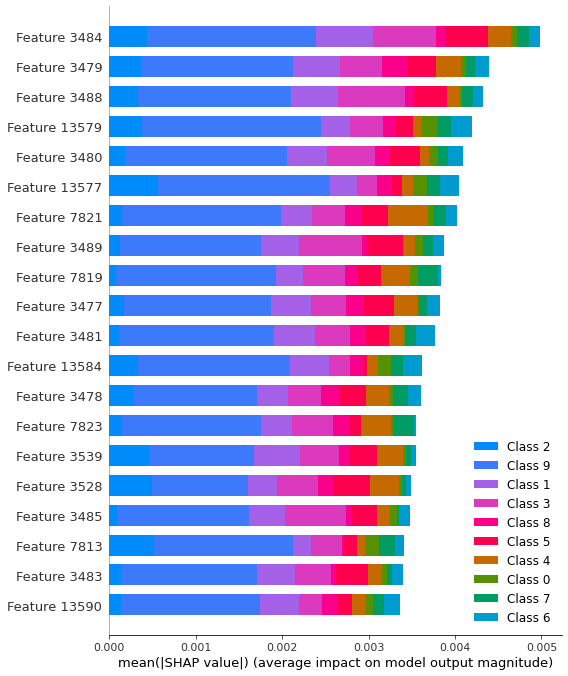

   class  sensitivity  specificity
0    1.0     0.811189          0.0
1    2.0     0.906977          0.0
2    3.0     0.867133          0.0
3    4.0     0.904412          0.0
4    5.0     0.881119          0.0
5    6.0     0.906475          0.0
6    7.0     0.914894          0.0
7    8.0     0.880282          0.0
8    9.0     0.905109          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.897759
specificity    0.000000
dtype: float64


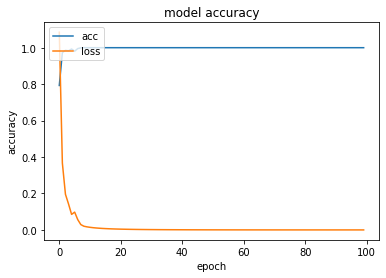

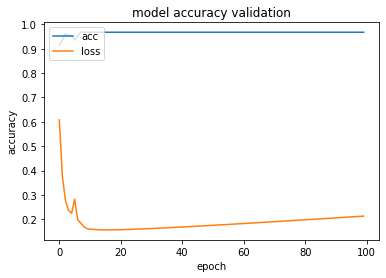

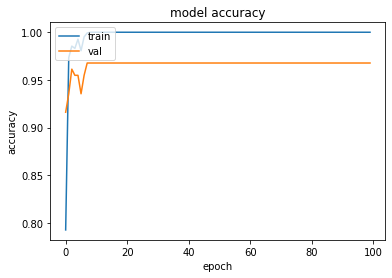

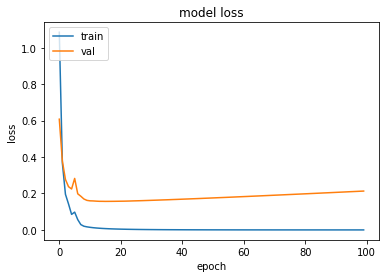

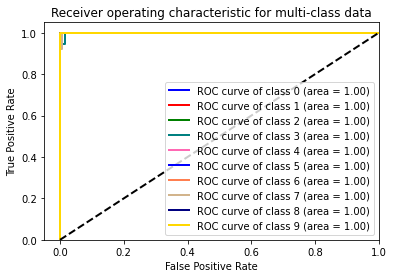

tanh tanh


Singal=delta layer=tanh optimizer=nadam
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 65s - loss: 0.3403 - acc: 0.9718 - val_loss: 0.2840 - val_acc: 0.9677
Epoch 3/100
1240/1240 - 65s - loss: 0.1820 - acc: 0.9815 - val_loss: 0.2234 - val_acc: 0.9419
Epoch 4/100
1240/1240 - 65s - loss: 0.1073 - acc: 0.9935 - val_loss: 0.1333 - val_acc: 0.9806
Epoch 5/100
1240/1240 - 65s - loss: 0.0767 - acc: 0.9952 - val_loss: 0.0885 - val_acc: 0.9806
Epoch 6/100
1240/1240 - 65s - loss: 0.0438 - acc: 1.0000 - val_loss: 0.0960 - val_acc: 0.9806
Epoch 7/100
1240/1240 - 65s - loss: 0.0277 - acc: 1.0000 - val_loss: 0.0828 - val_acc: 0.9871
Epoch 8/100
1240/1240 - 66s - loss: 0.0216 - acc: 1.0000 - val_loss: 0.0772 - val_acc: 0.9871
Epoch 9/100
1240/1240 - 65s - loss: 0.0176 - acc: 1.0000 - val_loss: 0.0729 - val_acc: 0.9871
Epoch 10/100
1240/1240 - 65s - loss: 0.0146 - acc: 1.0000 - val_loss: 0.0698 - val_acc: 0.9871
Epoch 11/100
1240/1240 - 65s - loss: 0.0123 - acc: 1.0000 - val_loss: 0.0670 - val_acc: 0.9871
Epoch 12/100
1240/1240 - 65s - loss: 0.0105 - acc: 1.0000 

Epoch 87/100
1240/1240 - 65s - loss: 3.5893e-05 - acc: 1.0000 - val_loss: 0.0651 - val_acc: 0.9871
Epoch 88/100
1240/1240 - 65s - loss: 3.3720e-05 - acc: 1.0000 - val_loss: 0.0653 - val_acc: 0.9871
Epoch 89/100
1240/1240 - 65s - loss: 3.1680e-05 - acc: 1.0000 - val_loss: 0.0654 - val_acc: 0.9871
Epoch 90/100
1240/1240 - 65s - loss: 2.9763e-05 - acc: 1.0000 - val_loss: 0.0656 - val_acc: 0.9871
Epoch 91/100
1240/1240 - 65s - loss: 2.7955e-05 - acc: 1.0000 - val_loss: 0.0657 - val_acc: 0.9871
Epoch 92/100
1240/1240 - 65s - loss: 2.6279e-05 - acc: 1.0000 - val_loss: 0.0659 - val_acc: 0.9871
Epoch 93/100
1240/1240 - 64s - loss: 2.4690e-05 - acc: 1.0000 - val_loss: 0.0660 - val_acc: 0.9871
Epoch 94/100
1240/1240 - 65s - loss: 2.3217e-05 - acc: 1.0000 - val_loss: 0.0662 - val_acc: 0.9871
Epoch 95/100
1240/1240 - 65s - loss: 2.1815e-05 - acc: 1.0000 - val_loss: 0.0663 - val_acc: 0.9871
Epoch 96/100
1240/1240 - 65s - loss: 2.0493e-05 - acc: 1.0000 - val_loss: 0.0665 - val_acc: 0.9871
Epoch 97/1

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


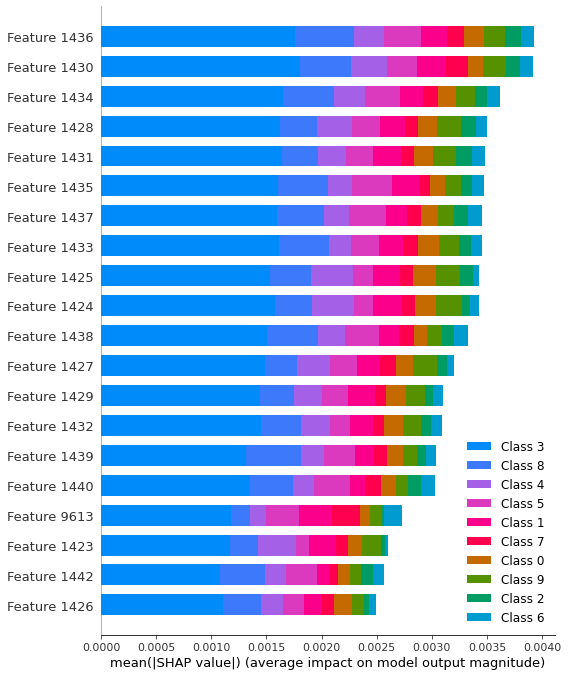

   class  sensitivity  specificity
0    1.0     0.858156          0.0
1    2.0     0.926471          0.0
2    3.0     0.888889          0.0
3    4.0     0.884892          0.0
4    5.0     0.855072          0.0
5    6.0     0.925926          0.0
6    7.0     0.883562          0.0
7    8.0     0.862319          0.0
8    9.0     0.911111          0.0
9   10.0     1.000000          0.0
class          5.50000
sensitivity    0.89964
specificity    0.00000
dtype: float64


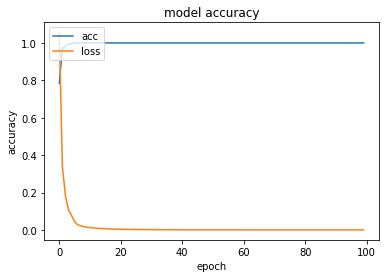

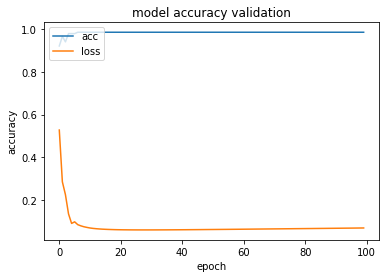

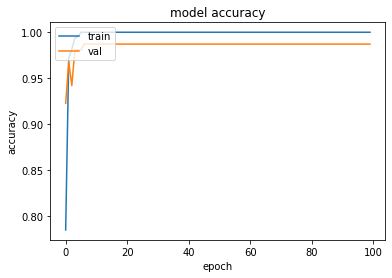

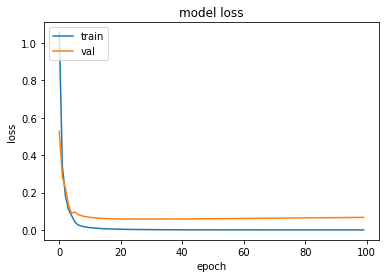

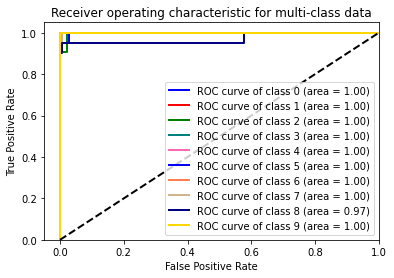

tanh tanh


Singal=delta layer=tanh optimizer=sgd
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________


`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 11s - loss: 0.5011 - acc: 0.9968 - val_loss: 0.4430 - val_acc: 0.9806
Epoch 3/100
1240/1240 - 11s - loss: 0.3162 - acc: 1.0000 - val_loss: 0.3313 - val_acc: 0.9871
Epoch 4/100
1240/1240 - 11s - loss: 0.2288 - acc: 1.0000 - val_loss: 0.2689 - val_acc: 0.9871
Epoch 5/100
1240/1240 - 11s - loss: 0.1781 - acc: 1.0000 - val_loss: 0.2265 - val_acc: 0.9871
Epoch 6/100
1240/1240 - 11s - loss: 0.1452 - acc: 1.0000 - val_loss: 0.1976 - val_acc: 0.9871
Epoch 7/100
1240/1240 - 11s - loss: 0.1221 - acc: 1.0000 - val_loss: 0.1759 - val_acc: 0.9871
Epoch 8/100
1240/1240 - 11s - loss: 0.1050 - acc: 1.0000 - val_loss: 0.1596 - val_acc: 0.9871
Epoch 9/100
1240/1240 - 11s - loss: 0.0918 - acc: 1.0000 - val_loss: 0.1463 - val_acc: 0.9871
Epoch 10/100
1240/1240 - 11s - loss: 0.0815 - acc: 1.0000 - val_loss: 0.1357 - val_acc: 0.9871
Epoch 11/100
1240/1240 - 11s - loss: 0.0731 - acc: 1.0000 - val_loss: 0.1269 - val_acc: 0.9871
Epoch 12/100
1240/1240 - 11s - loss: 0.0663 - acc: 1.0000 

Epoch 89/100
1240/1240 - 11s - loss: 0.0074 - acc: 1.0000 - val_loss: 0.0532 - val_acc: 0.9871
Epoch 90/100
1240/1240 - 11s - loss: 0.0073 - acc: 1.0000 - val_loss: 0.0531 - val_acc: 0.9871
Epoch 91/100
1240/1240 - 11s - loss: 0.0073 - acc: 1.0000 - val_loss: 0.0530 - val_acc: 0.9871
Epoch 92/100
1240/1240 - 11s - loss: 0.0072 - acc: 1.0000 - val_loss: 0.0529 - val_acc: 0.9871
Epoch 93/100
1240/1240 - 11s - loss: 0.0071 - acc: 1.0000 - val_loss: 0.0529 - val_acc: 0.9871
Epoch 94/100
1240/1240 - 11s - loss: 0.0070 - acc: 1.0000 - val_loss: 0.0528 - val_acc: 0.9871
Epoch 95/100
1240/1240 - 11s - loss: 0.0069 - acc: 1.0000 - val_loss: 0.0527 - val_acc: 0.9871
Epoch 96/100
1240/1240 - 11s - loss: 0.0069 - acc: 1.0000 - val_loss: 0.0526 - val_acc: 0.9871
Epoch 97/100
1240/1240 - 11s - loss: 0.0068 - acc: 1.0000 - val_loss: 0.0525 - val_acc: 0.9871
Epoch 98/100
1240/1240 - 11s - loss: 0.0067 - acc: 1.0000 - val_loss: 0.0524 - val_acc: 0.9871
Epoch 99/100
1240/1240 - 11s - loss: 0.0066 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


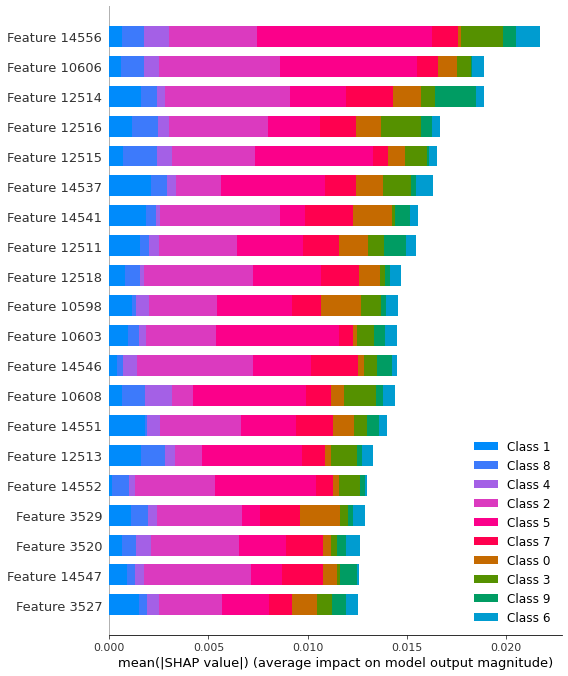

   class  sensitivity  specificity
0    1.0     0.821429          0.0
1    2.0     0.907692          0.0
2    3.0     0.874126          0.0
3    4.0     0.927007          0.0
4    5.0     0.888889          0.0
5    6.0     0.899281          0.0
6    7.0     0.886525          0.0
7    8.0     0.885714          0.0
8    9.0     0.913043          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.900371
specificity    0.000000
dtype: float64


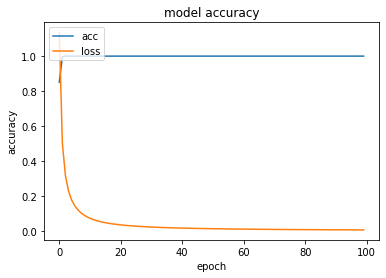

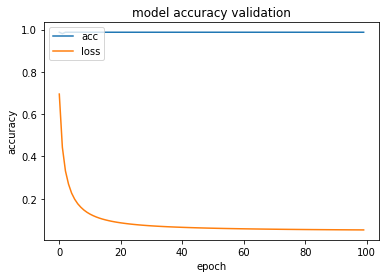

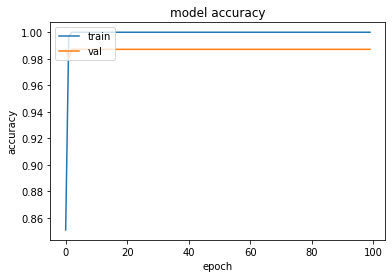

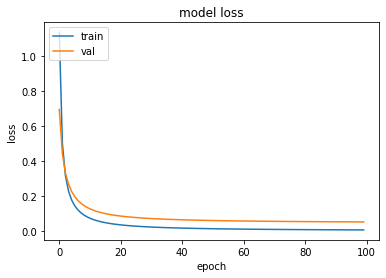

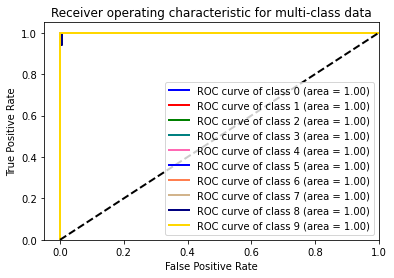

tanh tanh


Singal=delta layer=tanh optimizer=adadelta
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_____________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 25s - loss: 2.0710 - acc: 0.3185 - val_loss: 2.1861 - val_acc: 0.2065
Epoch 3/100
1240/1240 - 25s - loss: 1.9002 - acc: 0.4919 - val_loss: 2.0925 - val_acc: 0.2581
Epoch 4/100
1240/1240 - 25s - loss: 1.7652 - acc: 0.6468 - val_loss: 2.0082 - val_acc: 0.3484
Epoch 5/100
1240/1240 - 25s - loss: 1.6541 - acc: 0.7556 - val_loss: 1.9327 - val_acc: 0.4645
Epoch 6/100
1240/1240 - 25s - loss: 1.5604 - acc: 0.8444 - val_loss: 1.8635 - val_acc: 0.5484
Epoch 7/100
1240/1240 - 25s - loss: 1.4810 - acc: 0.9065 - val_loss: 1.7997 - val_acc: 0.6129
Epoch 8/100
1240/1240 - 25s - loss: 1.4119 - acc: 0.9411 - val_loss: 1.7410 - val_acc: 0.6645
Epoch 9/100
1240/1240 - 25s - loss: 1.3522 - acc: 0.9629 - val_loss: 1.6885 - val_acc: 0.7226
Epoch 10/100
1240/1240 - 25s - loss: 1.2995 - acc: 0.9774 - val_loss: 1.6404 - val_acc: 0.7742
Epoch 11/100
1240/1240 - 25s - loss: 1.2522 - acc: 0.9871 - val_loss: 1.5968 - val_acc: 0.8065
Epoch 12/100
1240/1240 - 25s - loss: 1.2103 - acc: 0.9952 

Epoch 89/100
1240/1240 - 21s - loss: 0.6239 - acc: 1.0000 - val_loss: 0.8216 - val_acc: 0.9613
Epoch 90/100
1240/1240 - 21s - loss: 0.6216 - acc: 1.0000 - val_loss: 0.8186 - val_acc: 0.9613
Epoch 91/100
1240/1240 - 21s - loss: 0.6194 - acc: 1.0000 - val_loss: 0.8156 - val_acc: 0.9613
Epoch 92/100
1240/1240 - 21s - loss: 0.6172 - acc: 1.0000 - val_loss: 0.8127 - val_acc: 0.9613
Epoch 93/100
1240/1240 - 21s - loss: 0.6151 - acc: 1.0000 - val_loss: 0.8098 - val_acc: 0.9613
Epoch 94/100
1240/1240 - 21s - loss: 0.6129 - acc: 1.0000 - val_loss: 0.8069 - val_acc: 0.9613
Epoch 95/100
1240/1240 - 21s - loss: 0.6108 - acc: 1.0000 - val_loss: 0.8040 - val_acc: 0.9613
Epoch 96/100
1240/1240 - 21s - loss: 0.6087 - acc: 1.0000 - val_loss: 0.8011 - val_acc: 0.9613
Epoch 97/100
1240/1240 - 21s - loss: 0.6065 - acc: 1.0000 - val_loss: 0.7981 - val_acc: 0.9613
Epoch 98/100
1240/1240 - 21s - loss: 0.6044 - acc: 1.0000 - val_loss: 0.7953 - val_acc: 0.9613
Epoch 99/100
1240/1240 - 21s - loss: 0.6024 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


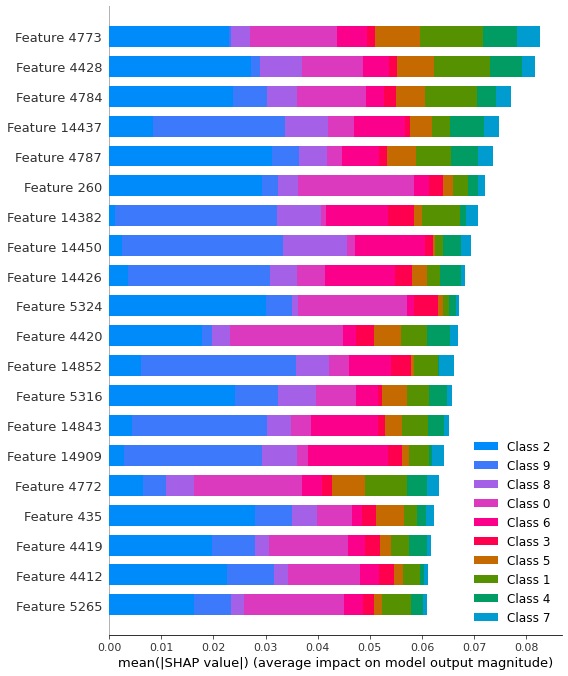

   class  sensitivity  specificity
0    1.0     0.818182     0.000000
1    2.0     0.930233     0.000000
2    3.0     0.869863     0.000000
3    4.0     0.903704     0.000000
4    5.0     0.880282     0.000000
5    6.0     0.920290     0.000000
6    7.0     0.895833     0.000000
7    8.0     0.850000     0.000000
8    9.0     0.917293     0.045455
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.898568
specificity    0.004545
dtype: float64


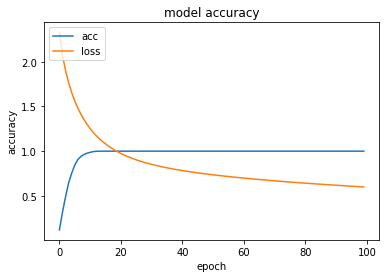

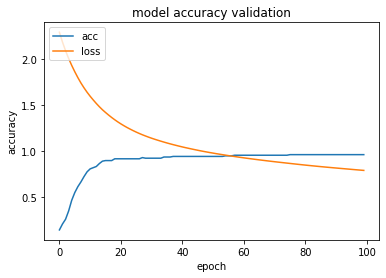

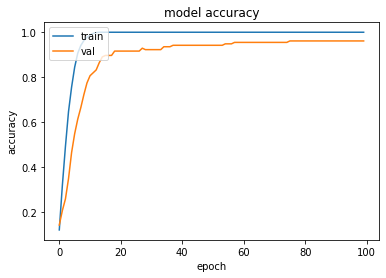

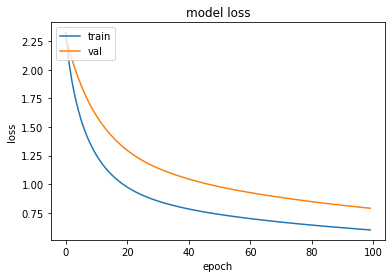

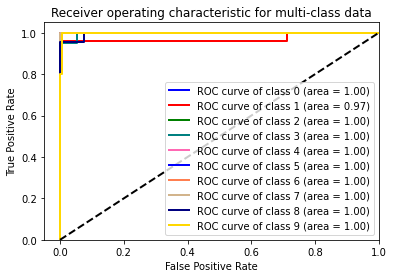

tanh tanh


Singal=delta layer=tanh optimizer=adagrad
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 17s - loss: 0.7295 - acc: 0.9984 - val_loss: 0.7524 - val_acc: 1.0000
Epoch 3/100
1240/1240 - 17s - loss: 0.5893 - acc: 1.0000 - val_loss: 0.6693 - val_acc: 1.0000
Epoch 4/100
1240/1240 - 17s - loss: 0.5195 - acc: 1.0000 - val_loss: 0.6150 - val_acc: 1.0000
Epoch 5/100
1240/1240 - 17s - loss: 0.4742 - acc: 1.0000 - val_loss: 0.5751 - val_acc: 1.0000
Epoch 6/100
1240/1240 - 17s - loss: 0.4407 - acc: 1.0000 - val_loss: 0.5429 - val_acc: 1.0000
Epoch 7/100
1240/1240 - 17s - loss: 0.4141 - acc: 1.0000 - val_loss: 0.5152 - val_acc: 1.0000
Epoch 8/100
1240/1240 - 17s - loss: 0.3918 - acc: 1.0000 - val_loss: 0.4915 - val_acc: 1.0000
Epoch 9/100
1240/1240 - 16s - loss: 0.3728 - acc: 1.0000 - val_loss: 0.4707 - val_acc: 1.0000
Epoch 10/100
1240/1240 - 17s - loss: 0.3562 - acc: 1.0000 - val_loss: 0.4520 - val_acc: 1.0000
Epoch 11/100
1240/1240 - 16s - loss: 0.3414 - acc: 1.0000 - val_loss: 0.4351 - val_acc: 1.0000
Epoch 12/100
1240/1240 - 17s - loss: 0.3282 - acc: 1.0000 

Epoch 89/100
1240/1240 - 17s - loss: 0.1022 - acc: 1.0000 - val_loss: 0.1413 - val_acc: 1.0000
Epoch 90/100
1240/1240 - 17s - loss: 0.1014 - acc: 1.0000 - val_loss: 0.1402 - val_acc: 1.0000
Epoch 91/100
1240/1240 - 17s - loss: 0.1006 - acc: 1.0000 - val_loss: 0.1392 - val_acc: 1.0000
Epoch 92/100
1240/1240 - 17s - loss: 0.0998 - acc: 1.0000 - val_loss: 0.1382 - val_acc: 1.0000
Epoch 93/100
1240/1240 - 17s - loss: 0.0991 - acc: 1.0000 - val_loss: 0.1372 - val_acc: 1.0000
Epoch 94/100
1240/1240 - 17s - loss: 0.0983 - acc: 1.0000 - val_loss: 0.1362 - val_acc: 1.0000
Epoch 95/100
1240/1240 - 17s - loss: 0.0975 - acc: 1.0000 - val_loss: 0.1352 - val_acc: 1.0000
Epoch 96/100
1240/1240 - 16s - loss: 0.0968 - acc: 1.0000 - val_loss: 0.1343 - val_acc: 1.0000
Epoch 97/100
1240/1240 - 17s - loss: 0.0961 - acc: 1.0000 - val_loss: 0.1333 - val_acc: 1.0000
Epoch 98/100
1240/1240 - 17s - loss: 0.0954 - acc: 1.0000 - val_loss: 0.1324 - val_acc: 1.0000
Epoch 99/100
1240/1240 - 17s - loss: 0.0947 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


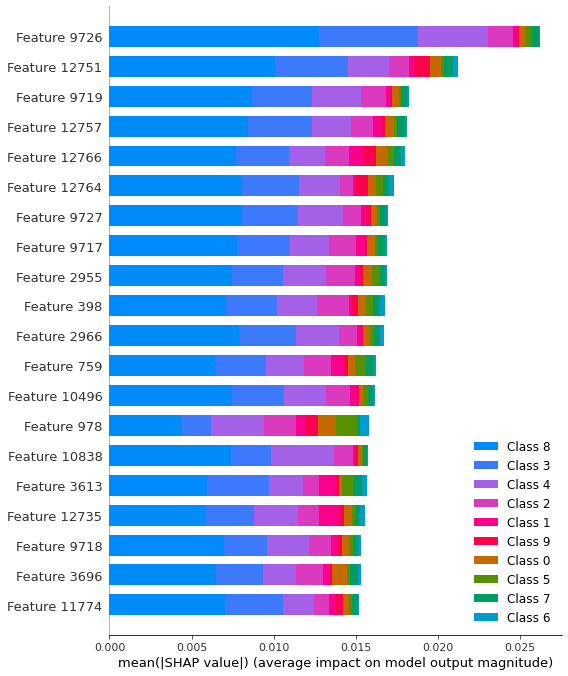

   class  sensitivity  specificity
0    1.0     0.887324          0.0
1    2.0     0.913669          0.0
2    3.0     0.846154          0.0
3    4.0     0.850746          0.0
4    5.0     0.897059          0.0
5    6.0     0.929078          0.0
6    7.0     0.924138          0.0
7    8.0     0.881944          0.0
8    9.0     0.852941          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.898305
specificity    0.000000
dtype: float64


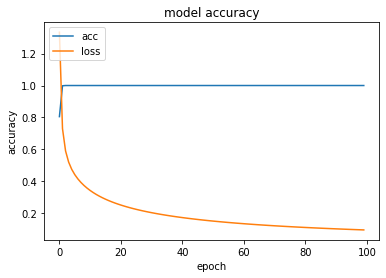

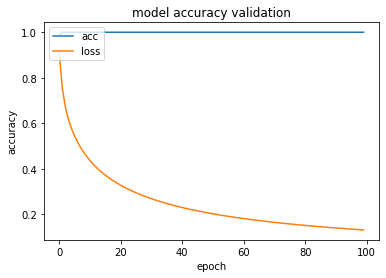

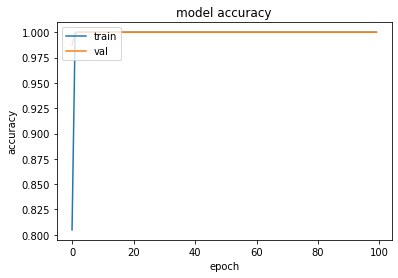

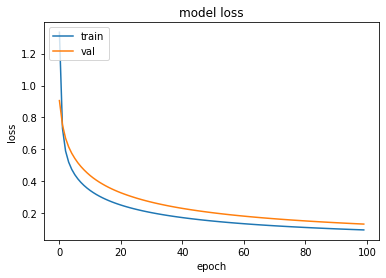

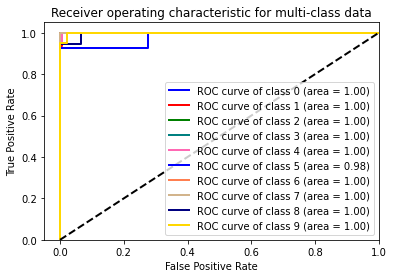

tanh tanh


Singal=delta layer=tanh optimizer=adamax
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 19s - loss: 0.4624 - acc: 0.9927 - val_loss: 0.4437 - val_acc: 0.9742
Epoch 3/100
1240/1240 - 19s - loss: 0.2977 - acc: 1.0000 - val_loss: 0.3284 - val_acc: 0.9806
Epoch 4/100
1240/1240 - 19s - loss: 0.2184 - acc: 1.0000 - val_loss: 0.2706 - val_acc: 0.9806
Epoch 5/100
1240/1240 - 19s - loss: 0.1678 - acc: 1.0000 - val_loss: 0.2285 - val_acc: 0.9806
Epoch 6/100
1240/1240 - 19s - loss: 0.1319 - acc: 1.0000 - val_loss: 0.1972 - val_acc: 0.9806
Epoch 7/100
1240/1240 - 19s - loss: 0.1056 - acc: 1.0000 - val_loss: 0.1749 - val_acc: 0.9806
Epoch 8/100
1240/1240 - 19s - loss: 0.0858 - acc: 1.0000 - val_loss: 0.1571 - val_acc: 0.9806
Epoch 9/100
1240/1240 - 19s - loss: 0.0707 - acc: 1.0000 - val_loss: 0.1448 - val_acc: 0.9806
Epoch 10/100
1240/1240 - 19s - loss: 0.0588 - acc: 1.0000 - val_loss: 0.1351 - val_acc: 0.9806
Epoch 11/100
1240/1240 - 19s - loss: 0.0493 - acc: 1.0000 - val_loss: 0.1276 - val_acc: 0.9806
Epoch 12/100
1240/1240 - 19s - loss: 0.0416 - acc: 1.0000 

Epoch 87/100
1240/1240 - 19s - loss: 2.6214e-06 - acc: 1.0000 - val_loss: 0.1821 - val_acc: 0.9806
Epoch 88/100
1240/1240 - 19s - loss: 2.3266e-06 - acc: 1.0000 - val_loss: 0.1836 - val_acc: 0.9806
Epoch 89/100
1240/1240 - 19s - loss: 2.0652e-06 - acc: 1.0000 - val_loss: 0.1851 - val_acc: 0.9806
Epoch 90/100
1240/1240 - 19s - loss: 1.8010e-06 - acc: 1.0000 - val_loss: 0.1864 - val_acc: 0.9806
Epoch 91/100
1240/1240 - 19s - loss: 1.5919e-06 - acc: 1.0000 - val_loss: 0.1877 - val_acc: 0.9806
Epoch 92/100
1240/1240 - 19s - loss: 1.4203e-06 - acc: 1.0000 - val_loss: 0.1890 - val_acc: 0.9806
Epoch 93/100
1240/1240 - 19s - loss: 1.2695e-06 - acc: 1.0000 - val_loss: 0.1904 - val_acc: 0.9806
Epoch 94/100
1240/1240 - 19s - loss: 1.0896e-06 - acc: 1.0000 - val_loss: 0.1920 - val_acc: 0.9806
Epoch 95/100
1240/1240 - 19s - loss: 1.0003e-06 - acc: 1.0000 - val_loss: 0.1936 - val_acc: 0.9806
Epoch 96/100
1240/1240 - 19s - loss: 8.9109e-07 - acc: 1.0000 - val_loss: 0.1950 - val_acc: 0.9806
Epoch 97/1

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


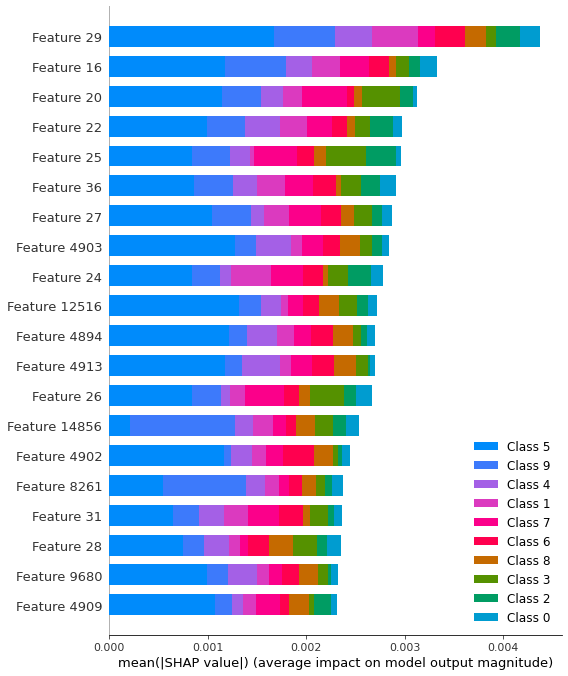

   class  sensitivity  specificity
0    1.0     0.852113          0.0
1    2.0     0.917910          0.0
2    3.0     0.895833          0.0
3    4.0     0.892857          0.0
4    5.0     0.907143          0.0
5    6.0     0.894366          0.0
6    7.0     0.842857          0.0
7    8.0     0.894737          0.0
8    9.0     0.886525          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.898434
specificity    0.000000
dtype: float64


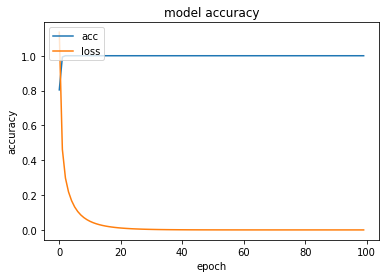

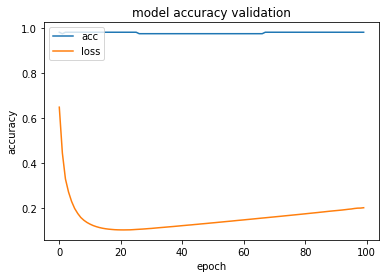

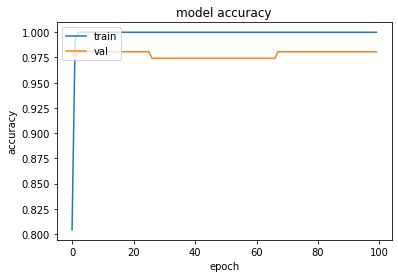

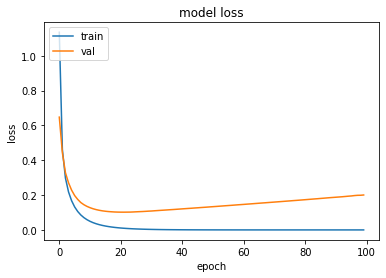

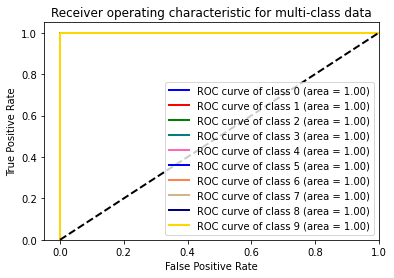

tanh tanh


Singal=delta layer=tanh optimizer=ftrl
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 22s - loss: 2.3026 - acc: 0.0976 - val_loss: 2.3029 - val_acc: 0.0774
Epoch 3/100
1240/1240 - 22s - loss: 2.3025 - acc: 0.1000 - val_loss: 2.3030 - val_acc: 0.0774
Epoch 4/100
1240/1240 - 22s - loss: 2.3025 - acc: 0.0992 - val_loss: 2.3030 - val_acc: 0.0774
Epoch 5/100
1240/1240 - 22s - loss: 2.3025 - acc: 0.1032 - val_loss: 2.3031 - val_acc: 0.0774
Epoch 6/100
1240/1240 - 22s - loss: 2.3025 - acc: 0.0935 - val_loss: 2.3032 - val_acc: 0.0774
Epoch 7/100
1240/1240 - 22s - loss: 2.3025 - acc: 0.0919 - val_loss: 2.3032 - val_acc: 0.0774
Epoch 8/100
1240/1240 - 22s - loss: 2.3025 - acc: 0.0976 - val_loss: 2.3032 - val_acc: 0.0774
Epoch 9/100
1240/1240 - 22s - loss: 2.3025 - acc: 0.1040 - val_loss: 2.3033 - val_acc: 0.0774
Epoch 10/100
1240/1240 - 22s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3033 - val_acc: 0.0774
Epoch 11/100
1240/1240 - 22s - loss: 2.3024 - acc: 0.1048 - val_loss: 2.3034 - val_acc: 0.0774
Epoch 12/100
1240/1240 - 22s - loss: 2.3024 - acc: 0.1065 

Epoch 89/100
1240/1240 - 22s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3048 - val_acc: 0.0774
Epoch 90/100
1240/1240 - 22s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3048 - val_acc: 0.0774
Epoch 91/100
1240/1240 - 22s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3048 - val_acc: 0.0774
Epoch 92/100
1240/1240 - 22s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3048 - val_acc: 0.0774
Epoch 93/100
1240/1240 - 22s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3048 - val_acc: 0.0774
Epoch 94/100
1240/1240 - 22s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3049 - val_acc: 0.0774
Epoch 95/100
1240/1240 - 22s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3049 - val_acc: 0.0774
Epoch 96/100
1240/1240 - 22s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3049 - val_acc: 0.0774
Epoch 97/100
1240/1240 - 22s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3049 - val_acc: 0.0774
Epoch 98/100
1240/1240 - 22s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3049 - val_acc: 0.0774
Epoch 99/100
1240/1240 - 22s - loss: 2.3021 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


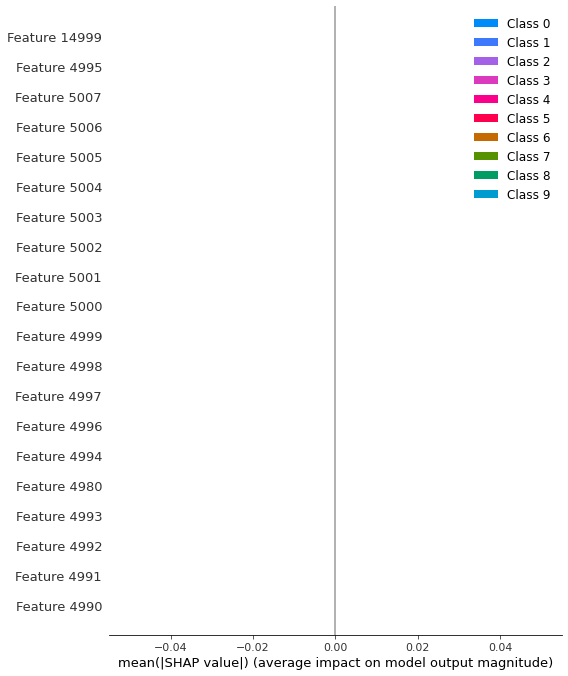

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


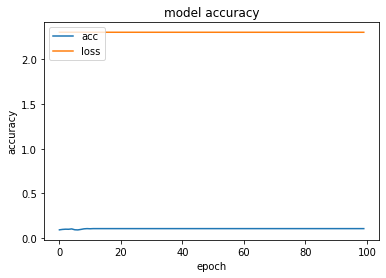

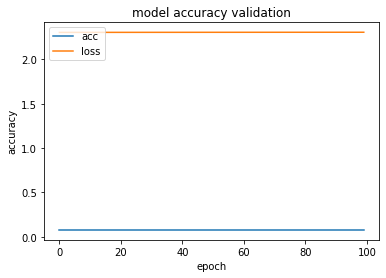

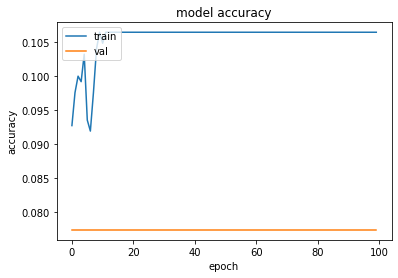

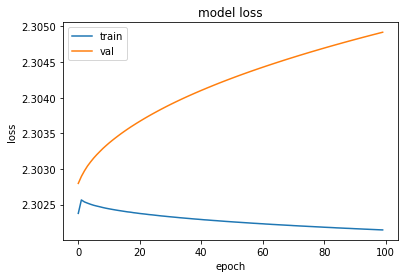

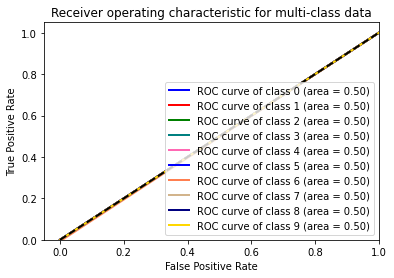

relu relu


Singal=delta layer=relu optimizer=rmsprop
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 39s - loss: 2.3027 - acc: 0.1048 - val_loss: 2.3042 - val_acc: 0.0774
Epoch 3/100
1240/1240 - 39s - loss: 2.3025 - acc: 0.1000 - val_loss: 2.3051 - val_acc: 0.0774
Epoch 4/100
1240/1240 - 38s - loss: 2.3024 - acc: 0.1016 - val_loss: 2.3058 - val_acc: 0.0774
Epoch 5/100
1240/1240 - 39s - loss: 2.3022 - acc: 0.0895 - val_loss: 2.3062 - val_acc: 0.0774
Epoch 6/100
1240/1240 - 39s - loss: 2.3022 - acc: 0.1024 - val_loss: 2.3069 - val_acc: 0.0968
Epoch 7/100
1240/1240 - 39s - loss: 2.3021 - acc: 0.0935 - val_loss: 2.3072 - val_acc: 0.0968
Epoch 8/100
1240/1240 - 38s - loss: 2.3020 - acc: 0.1056 - val_loss: 2.3078 - val_acc: 0.0968
Epoch 9/100
1240/1240 - 39s - loss: 2.3020 - acc: 0.1040 - val_loss: 2.3082 - val_acc: 0.0968
Epoch 10/100
1240/1240 - 39s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3085 - val_acc: 0.0968
Epoch 11/100
1240/1240 - 39s - loss: 2.3019 - acc: 0.1048 - val_loss: 2.3086 - val_acc: 0.0968
Epoch 12/100
1240/1240 - 39s - loss: 2.3019 - acc: 0.1065 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


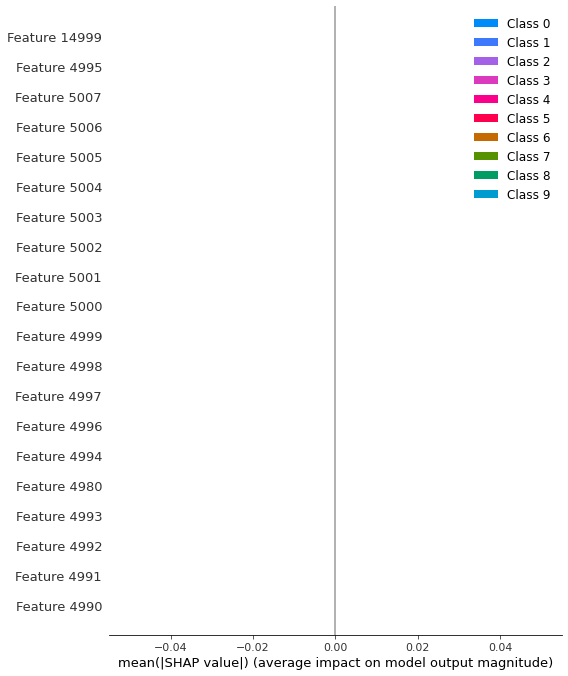

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


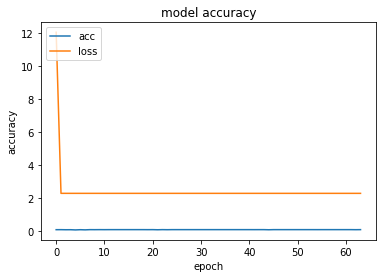

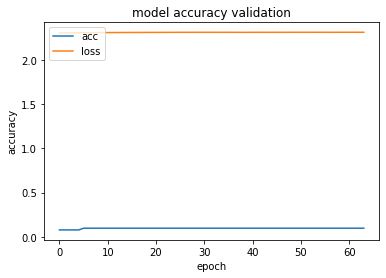

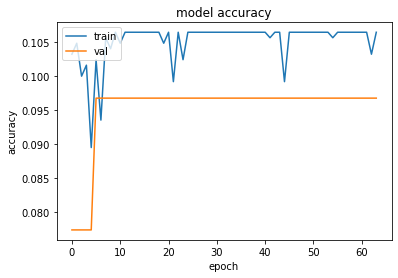

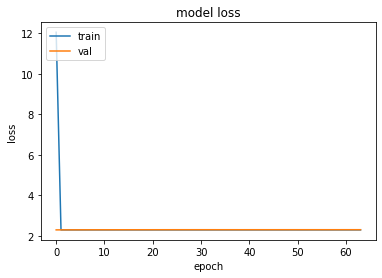

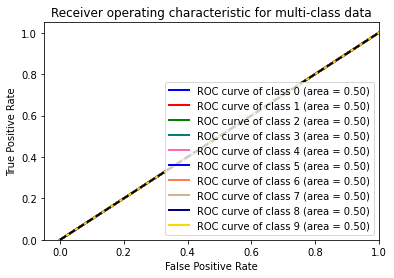

relu relu


Singal=delta layer=relu optimizer=adam
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 16s - loss: 2.3028 - acc: 0.1008 - val_loss: 2.3033 - val_acc: 0.1032
Epoch 3/100
1240/1240 - 17s - loss: 2.3026 - acc: 0.1008 - val_loss: 2.3043 - val_acc: 0.1032
Epoch 4/100
1240/1240 - 16s - loss: 2.3025 - acc: 0.0935 - val_loss: 2.3053 - val_acc: 0.0903
Epoch 5/100
1240/1240 - 16s - loss: 2.3023 - acc: 0.1032 - val_loss: 2.3063 - val_acc: 0.0903
Epoch 6/100
1240/1240 - 17s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3072 - val_acc: 0.0903
Epoch 7/100
1240/1240 - 16s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3081 - val_acc: 0.0903
Epoch 8/100
1240/1240 - 17s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3087 - val_acc: 0.0903
Epoch 9/100
1240/1240 - 17s - loss: 2.3020 - acc: 0.1065 - val_loss: 2.3095 - val_acc: 0.0903
Epoch 10/100
1240/1240 - 16s - loss: 2.3020 - acc: 0.1065 - val_loss: 2.3100 - val_acc: 0.0903
Epoch 11/100
1240/1240 - 17s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3104 - val_acc: 0.0903
Epoch 12/100
1240/1240 - 16s - loss: 2.3019 - acc: 0.1065 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


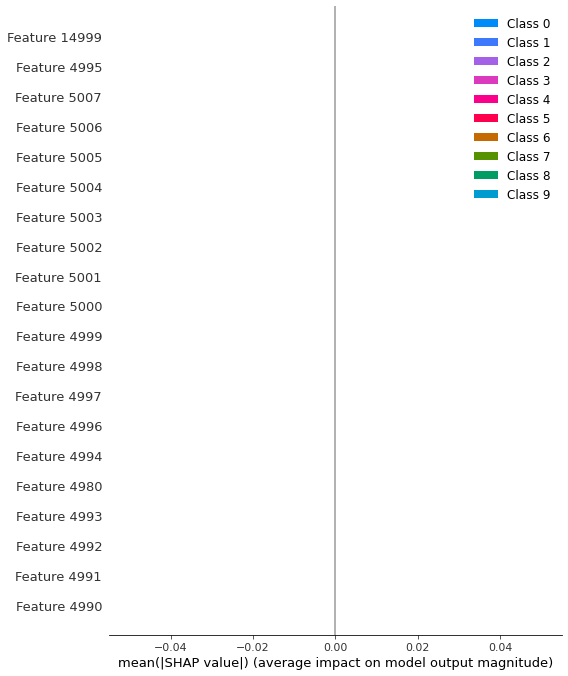

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


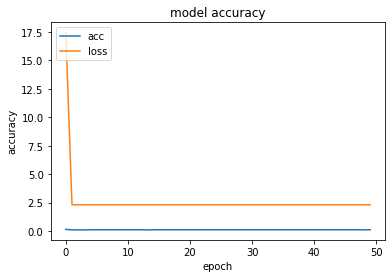

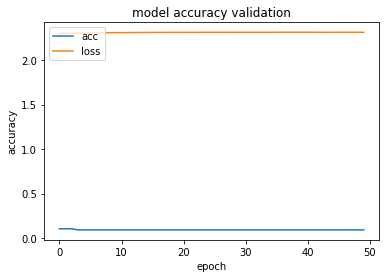

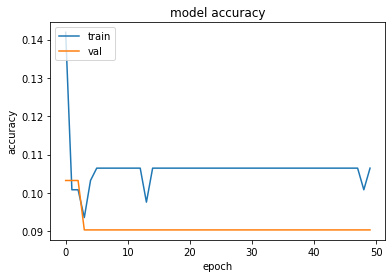

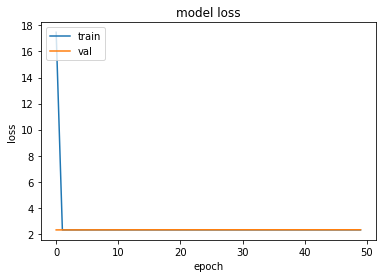

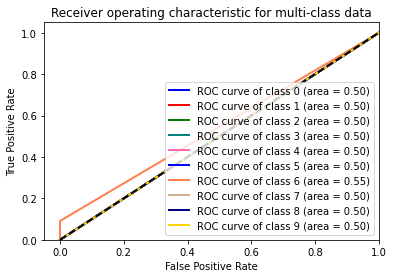

relu relu


Singal=delta layer=relu optimizer=nadam
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 66s - loss: 2.3026 - acc: 0.1048 - val_loss: 2.3047 - val_acc: 0.0645
Epoch 3/100
1240/1240 - 65s - loss: 2.3025 - acc: 0.1016 - val_loss: 2.3053 - val_acc: 0.0645
Epoch 4/100
1240/1240 - 65s - loss: 2.3023 - acc: 0.0984 - val_loss: 2.3058 - val_acc: 0.0645
Epoch 5/100
1240/1240 - 65s - loss: 2.3023 - acc: 0.0976 - val_loss: 2.3065 - val_acc: 0.0645
Epoch 6/100
1240/1240 - 66s - loss: 2.3021 - acc: 0.1048 - val_loss: 2.3071 - val_acc: 0.0645
Epoch 7/100
1240/1240 - 65s - loss: 2.3021 - acc: 0.1000 - val_loss: 2.3076 - val_acc: 0.0645
Epoch 8/100
1240/1240 - 65s - loss: 2.3020 - acc: 0.1048 - val_loss: 2.3082 - val_acc: 0.0645
Epoch 9/100
1240/1240 - 65s - loss: 2.3020 - acc: 0.0952 - val_loss: 2.3085 - val_acc: 0.0645
Epoch 10/100
1240/1240 - 65s - loss: 2.3020 - acc: 0.1048 - val_loss: 2.3090 - val_acc: 0.0645
Epoch 11/100
1240/1240 - 65s - loss: 2.3019 - acc: 0.1048 - val_loss: 2.3094 - val_acc: 0.0645
Epoch 12/100
1240/1240 - 65s - loss: 2.3019 - acc: 0.0952 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


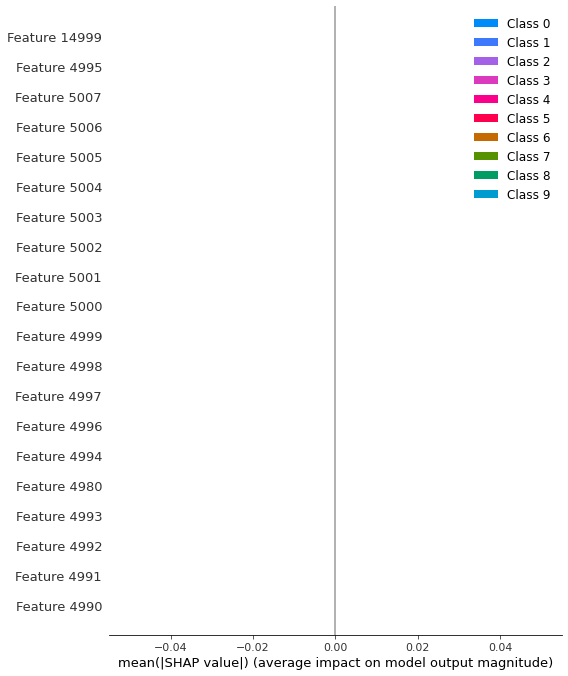

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


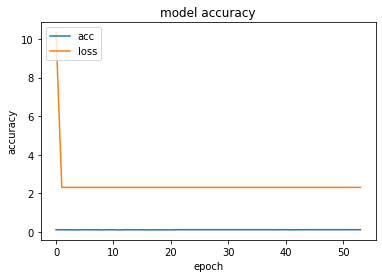

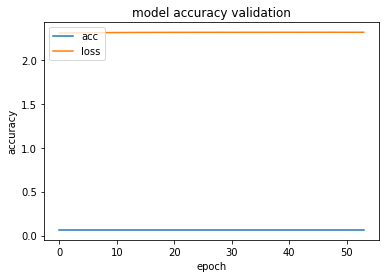

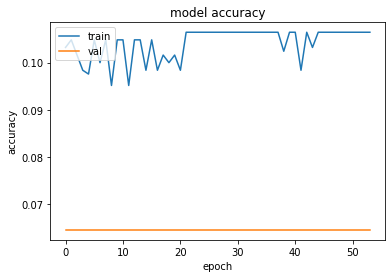

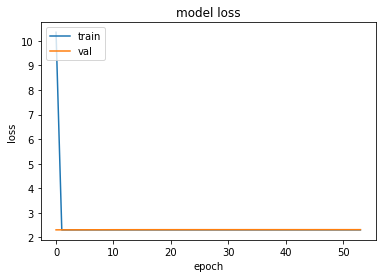

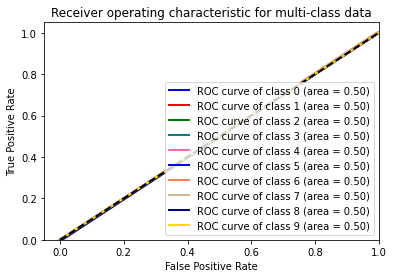

relu relu


Singal=delta layer=relu optimizer=sgd
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________


`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


1240/1240 - 12s - loss: nan - acc: 0.1040 - val_loss: nan - val_acc: 0.0774
Epoch 2/100
1240/1240 - 12s - loss: nan - acc: 0.1048 - val_loss: nan - val_acc: 0.0774
Epoch 3/100
1240/1240 - 12s - loss: nan - acc: 0.1048 - val_loss: nan - val_acc: 0.0774
Epoch 4/100
1240/1240 - 12s - loss: nan - acc: 0.1048 - val_loss: nan - val_acc: 0.0774
Epoch 5/100
1240/1240 - 12s - loss: nan - acc: 0.1048 - val_loss: nan - val_acc: 0.0774
Epoch 6/100
1240/1240 - 13s - loss: nan - acc: 0.1048 - val_loss: nan - val_acc: 0.0774
Epoch 7/100
1240/1240 - 12s - loss: nan - acc: 0.1048 - val_loss: nan - val_acc: 0.0774
Epoch 8/100
1240/1240 - 12s - loss: nan - acc: 0.1048 - val_loss: nan - val_acc: 0.0774
Epoch 9/100
1240/1240 - 12s - loss: nan - acc: 0.1048 - val_loss: nan - val_acc: 0.0774
Epoch 10/100
1240/1240 - 12s - loss: nan - acc: 0.1048 - val_loss: nan - val_acc: 0.0774
Epoch 11/100
1240/1240 - 12s - loss: nan - acc: 0.1048 - val_loss: nan - val_acc: 0.0774
Epoch 12/100
1240/1240 - 12s - loss: nan -

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 25s - loss: 4.2001 - acc: 0.3048 - val_loss: 4.4199 - val_acc: 0.2839
Epoch 3/100
1240/1240 - 25s - loss: 2.8416 - acc: 0.4056 - val_loss: 3.4594 - val_acc: 0.3355
Epoch 4/100
1240/1240 - 25s - loss: 2.0581 - acc: 0.4855 - val_loss: 2.8601 - val_acc: 0.3806
Epoch 5/100
1240/1240 - 25s - loss: 1.5530 - acc: 0.5565 - val_loss: 2.5258 - val_acc: 0.4452
Epoch 6/100
1240/1240 - 25s - loss: 1.1934 - acc: 0.6266 - val_loss: 2.2292 - val_acc: 0.4774
Epoch 7/100
1240/1240 - 25s - loss: 0.9952 - acc: 0.6952 - val_loss: 2.0676 - val_acc: 0.5032
Epoch 8/100
1240/1240 - 25s - loss: 0.8175 - acc: 0.7419 - val_loss: 1.9355 - val_acc: 0.5161
Epoch 9/100
1240/1240 - 25s - loss: 0.7069 - acc: 0.7661 - val_loss: 1.8219 - val_acc: 0.5355
Epoch 10/100
1240/1240 - 25s - loss: 0.6057 - acc: 0.8008 - val_loss: 1.6414 - val_acc: 0.5613
Epoch 11/100
1240/1240 - 25s - loss: 0.5478 - acc: 0.8177 - val_loss: 1.6230 - val_acc: 0.5677
Epoch 12/100
1240/1240 - 25s - loss: 0.4879 - acc: 0.8435 

Epoch 89/100
1240/1240 - 25s - loss: 0.0380 - acc: 0.9960 - val_loss: 0.6200 - val_acc: 0.8516
Epoch 90/100
1240/1240 - 25s - loss: 0.0373 - acc: 0.9927 - val_loss: 0.6097 - val_acc: 0.8581
Epoch 91/100
1240/1240 - 25s - loss: 0.0362 - acc: 0.9960 - val_loss: 0.6148 - val_acc: 0.8581
Epoch 92/100
1240/1240 - 25s - loss: 0.0361 - acc: 0.9960 - val_loss: 0.6212 - val_acc: 0.8581
Epoch 93/100
1240/1240 - 25s - loss: 0.0359 - acc: 0.9968 - val_loss: 0.6088 - val_acc: 0.8581
Epoch 94/100
1240/1240 - 25s - loss: 0.0332 - acc: 0.9960 - val_loss: 0.6078 - val_acc: 0.8581
Epoch 95/100
1240/1240 - 25s - loss: 0.0356 - acc: 0.9944 - val_loss: 0.6006 - val_acc: 0.8581
Epoch 96/100
1240/1240 - 25s - loss: 0.0324 - acc: 0.9968 - val_loss: 0.6080 - val_acc: 0.8581
Epoch 97/100
1240/1240 - 25s - loss: 0.0323 - acc: 0.9960 - val_loss: 0.6027 - val_acc: 0.8516
Epoch 98/100
1240/1240 - 25s - loss: 0.0323 - acc: 0.9976 - val_loss: 0.5943 - val_acc: 0.8581
Epoch 99/100
1240/1240 - 25s - loss: 0.0307 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


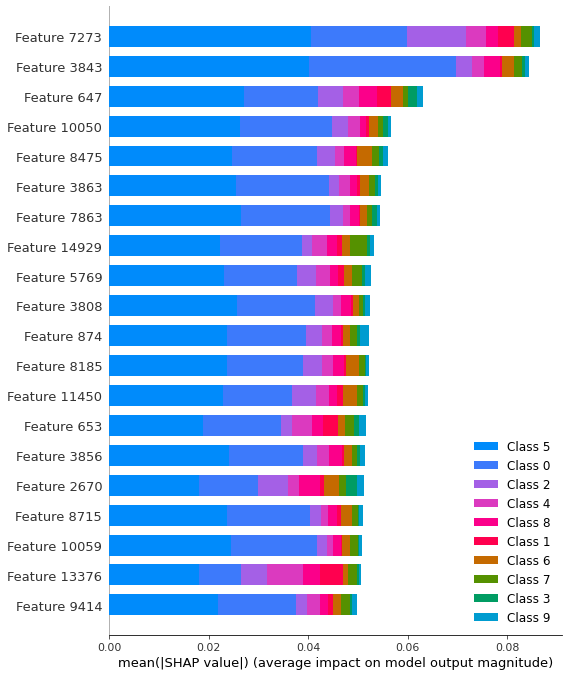

   class  sensitivity  specificity
0    1.0     0.929577     0.000000
1    2.0     0.877863     0.208333
2    3.0     0.890411     0.000000
3    4.0     0.859259     0.000000
4    5.0     0.893617     0.000000
5    6.0     0.907801     0.000000
6    7.0     0.887324     0.000000
7    8.0     0.863309     0.000000
8    9.0     0.903704     0.000000
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.901287
specificity    0.020833
dtype: float64


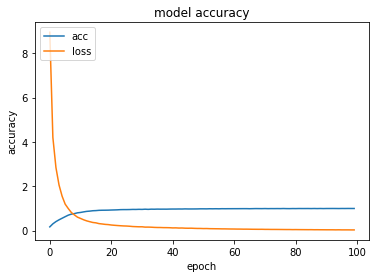

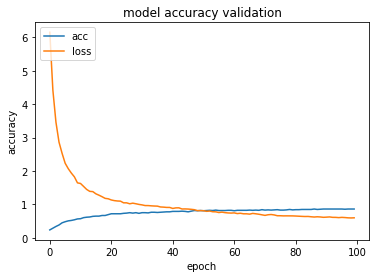

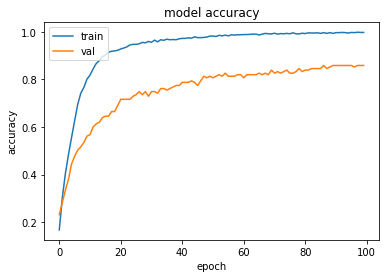

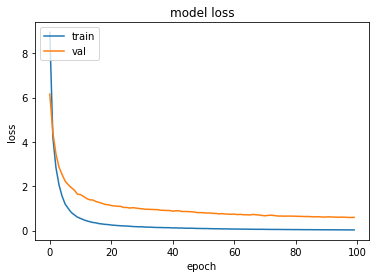

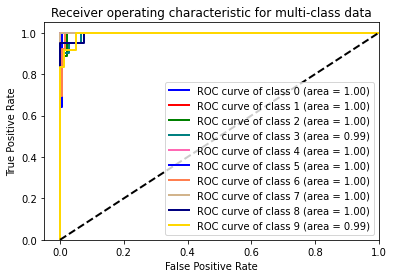

relu relu


Singal=delta layer=relu optimizer=adagrad
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 15s - loss: 1.5663 - acc: 0.8202 - val_loss: 1.3942 - val_acc: 0.7742
Epoch 3/100
1240/1240 - 16s - loss: 1.0701 - acc: 0.8702 - val_loss: 0.8228 - val_acc: 0.8258
Epoch 4/100
1240/1240 - 15s - loss: 0.7001 - acc: 0.8895 - val_loss: 0.7488 - val_acc: 0.8387
Epoch 5/100
1240/1240 - 15s - loss: 0.7195 - acc: 0.8927 - val_loss: 0.8210 - val_acc: 0.8387
Epoch 6/100
1240/1240 - 16s - loss: 0.5792 - acc: 0.8927 - val_loss: 0.6391 - val_acc: 0.8516
Epoch 7/100
1240/1240 - 15s - loss: 0.4714 - acc: 0.8944 - val_loss: 0.6258 - val_acc: 0.8516
Epoch 8/100
1240/1240 - 15s - loss: 0.4239 - acc: 0.8960 - val_loss: 0.6923 - val_acc: 0.8452
Epoch 9/100
1240/1240 - 15s - loss: 0.4463 - acc: 0.8960 - val_loss: 0.5322 - val_acc: 0.8452
Epoch 10/100
1240/1240 - 16s - loss: 0.3424 - acc: 0.8960 - val_loss: 0.6066 - val_acc: 0.8452
Epoch 11/100
1240/1240 - 16s - loss: 0.3517 - acc: 0.8960 - val_loss: 0.4661 - val_acc: 0.8452
Epoch 12/100
1240/1240 - 16s - loss: 0.3177 - acc: 0.8960 

Epoch 89/100
1240/1240 - 15s - loss: 0.0974 - acc: 0.9685 - val_loss: 0.2572 - val_acc: 0.8774
Epoch 90/100
1240/1240 - 15s - loss: 0.0949 - acc: 0.9702 - val_loss: 0.2548 - val_acc: 0.8903
Epoch 91/100
1240/1240 - 15s - loss: 0.0938 - acc: 0.9734 - val_loss: 0.2525 - val_acc: 0.9097
Epoch 92/100
1240/1240 - 15s - loss: 0.0898 - acc: 0.9790 - val_loss: 0.2489 - val_acc: 0.8968
Epoch 93/100
1240/1240 - 15s - loss: 0.0886 - acc: 0.9774 - val_loss: 0.2452 - val_acc: 0.9032
Epoch 94/100
1240/1240 - 15s - loss: 0.0859 - acc: 0.9815 - val_loss: 0.2426 - val_acc: 0.9161
Epoch 95/100
1240/1240 - 15s - loss: 0.0827 - acc: 0.9847 - val_loss: 0.2409 - val_acc: 0.9161
Epoch 96/100
1240/1240 - 15s - loss: 0.0820 - acc: 0.9847 - val_loss: 0.2376 - val_acc: 0.9226
Epoch 97/100
1240/1240 - 15s - loss: 0.0811 - acc: 0.9903 - val_loss: 0.2332 - val_acc: 0.9161
Epoch 98/100
1240/1240 - 15s - loss: 0.0826 - acc: 0.9815 - val_loss: 0.2294 - val_acc: 0.9355
Epoch 99/100
1240/1240 - 15s - loss: 0.0761 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


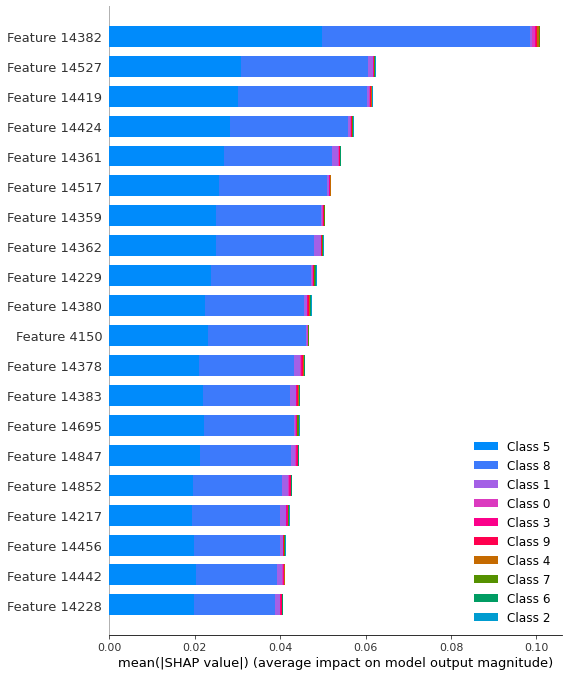

   class  sensitivity  specificity
0    1.0     0.812500          0.0
1    2.0     0.929688          0.0
2    3.0     0.864865          0.0
3    4.0     0.897059          0.0
4    5.0     0.843972          0.0
5    6.0     0.940741          0.0
6    7.0     0.902778          0.0
7    8.0     0.893617          0.0
8    9.0     0.891304          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.897652
specificity    0.000000
dtype: float64


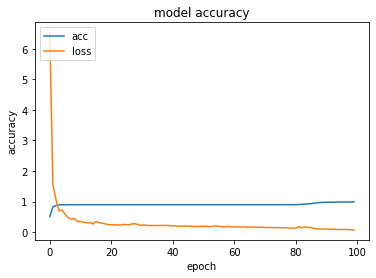

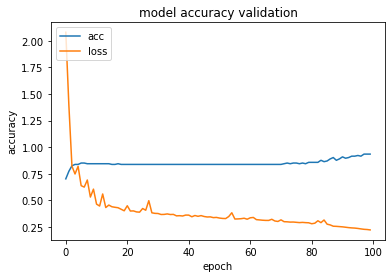

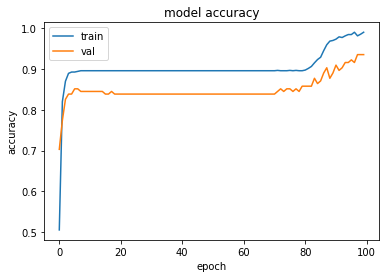

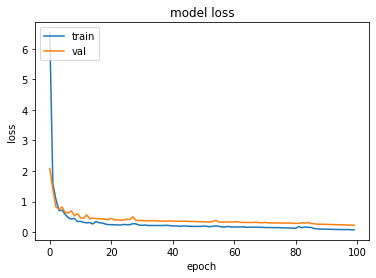

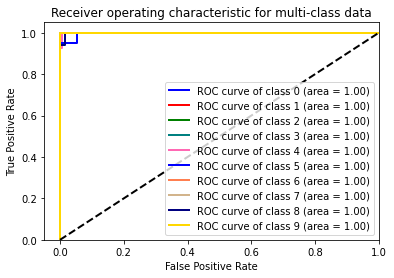

relu relu


Singal=delta layer=relu optimizer=adamax
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


1240/1240 - 21s - loss: 9.5212 - acc: 0.1855 - val_loss: 2.4397 - val_acc: 0.1355
Epoch 2/100
1240/1240 - 21s - loss: 2.3558 - acc: 0.1605 - val_loss: 2.1948 - val_acc: 0.1226
Epoch 3/100
1240/1240 - 21s - loss: 2.0993 - acc: 0.1927 - val_loss: 2.1459 - val_acc: 0.1871
Epoch 4/100
1240/1240 - 21s - loss: 2.0192 - acc: 0.2331 - val_loss: 2.0504 - val_acc: 0.2129
Epoch 5/100
1240/1240 - 21s - loss: 2.0171 - acc: 0.2435 - val_loss: 2.0150 - val_acc: 0.2258
Epoch 6/100
1240/1240 - 21s - loss: 1.9740 - acc: 0.2500 - val_loss: 1.9986 - val_acc: 0.2323
Epoch 7/100
1240/1240 - 21s - loss: 1.9288 - acc: 0.2734 - val_loss: 1.9099 - val_acc: 0.2774
Epoch 8/100
1240/1240 - 21s - loss: 1.8280 - acc: 0.3121 - val_loss: 1.7989 - val_acc: 0.3226
Epoch 9/100
1240/1240 - 21s - loss: 1.7344 - acc: 0.3500 - val_loss: 1.7449 - val_acc: 0.3161
Epoch 10/100
1240/1240 - 21s - loss: 1.7153 - acc: 0.3484 - val_loss: 1.7187 - val_acc: 0.3097
Epoch 11/100
1240/1240 - 21s - loss: 1.6793 - acc: 0.3427 - val_loss: 1

Epoch 88/100
1240/1240 - 21s - loss: 0.4805 - acc: 0.7460 - val_loss: 0.5275 - val_acc: 0.7548
Epoch 89/100
1240/1240 - 21s - loss: 0.4798 - acc: 0.7556 - val_loss: 0.5267 - val_acc: 0.7548
Epoch 90/100
1240/1240 - 21s - loss: 0.4795 - acc: 0.7379 - val_loss: 0.5268 - val_acc: 0.7548
Epoch 91/100
1240/1240 - 21s - loss: 0.4791 - acc: 0.7556 - val_loss: 0.5270 - val_acc: 0.7548
Epoch 92/100
1240/1240 - 21s - loss: 0.4786 - acc: 0.7484 - val_loss: 0.5283 - val_acc: 0.7548
Epoch 93/100
1240/1240 - 21s - loss: 0.4782 - acc: 0.7556 - val_loss: 0.5299 - val_acc: 0.7548
Epoch 94/100
1240/1240 - 21s - loss: 0.4777 - acc: 0.7556 - val_loss: 0.5309 - val_acc: 0.7548
Epoch 95/100
1240/1240 - 21s - loss: 0.4773 - acc: 0.7500 - val_loss: 0.5327 - val_acc: 0.7548
Epoch 96/100
1240/1240 - 21s - loss: 0.4767 - acc: 0.7556 - val_loss: 0.5273 - val_acc: 0.7548
Epoch 97/100
1240/1240 - 21s - loss: 0.4763 - acc: 0.7556 - val_loss: 0.5371 - val_acc: 0.7548
Epoch 98/100
1240/1240 - 21s - loss: 0.4760 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


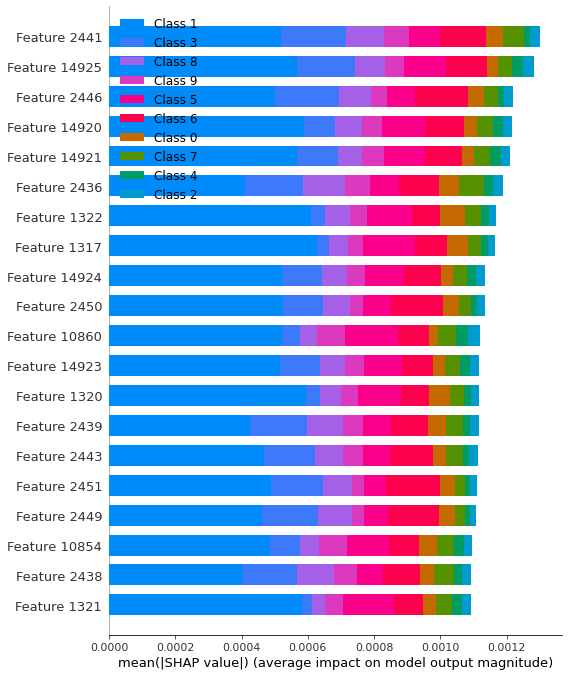

   class  sensitivity  specificity
0    1.0     0.854167          0.0
1    2.0     0.962687          0.0
2    3.0     0.868056          0.0
3    4.0     0.882353          0.0
4    5.0     0.891304          0.0
5    6.0     0.913669          0.0
6    7.0     1.000000          0.0
7    8.0     0.865248          0.0
8    9.0     0.992593          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.923008
specificity    0.000000
dtype: float64


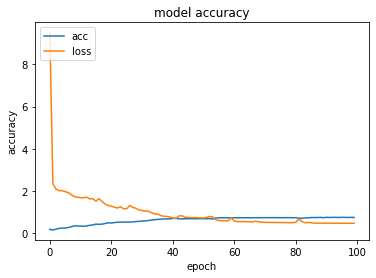

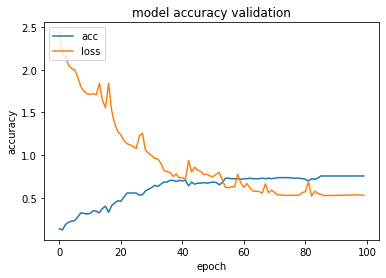

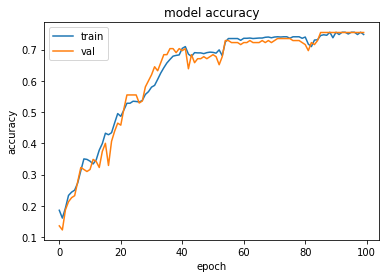

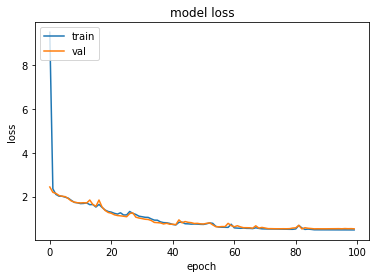

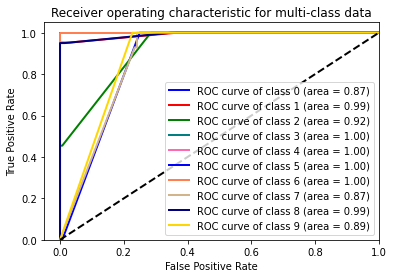

relu relu


Singal=delta layer=relu optimizer=ftrl
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 21s - loss: 2.0858 - acc: 0.1911 - val_loss: 2.0228 - val_acc: 0.2323
Epoch 3/100
1240/1240 - 21s - loss: 1.9546 - acc: 0.2540 - val_loss: 1.8673 - val_acc: 0.3484
Epoch 4/100
1240/1240 - 21s - loss: 1.7929 - acc: 0.3532 - val_loss: 1.6479 - val_acc: 0.4645
Epoch 5/100
1240/1240 - 21s - loss: 1.5966 - acc: 0.4540 - val_loss: 1.4398 - val_acc: 0.5097
Epoch 6/100
1240/1240 - 21s - loss: 1.4204 - acc: 0.5016 - val_loss: 1.2798 - val_acc: 0.5548
Epoch 7/100
1240/1240 - 21s - loss: 1.2836 - acc: 0.5306 - val_loss: 1.1561 - val_acc: 0.5935
Epoch 8/100
1240/1240 - 21s - loss: 1.1771 - acc: 0.5605 - val_loss: 1.0629 - val_acc: 0.5806
Epoch 9/100
1240/1240 - 21s - loss: 1.0991 - acc: 0.5669 - val_loss: 0.9881 - val_acc: 0.5935
Epoch 10/100
1240/1240 - 21s - loss: 1.0281 - acc: 0.6073 - val_loss: 0.9234 - val_acc: 0.6258
Epoch 11/100
1240/1240 - 21s - loss: 0.9495 - acc: 0.6734 - val_loss: 0.8125 - val_acc: 0.7419
Epoch 12/100
1240/1240 - 21s - loss: 0.8664 - acc: 0.7202 

Epoch 89/100
1240/1240 - 21s - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0080 - val_acc: 1.0000
Epoch 90/100
1240/1240 - 21s - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0078 - val_acc: 1.0000
Epoch 91/100
1240/1240 - 21s - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0079 - val_acc: 1.0000
Epoch 92/100
1240/1240 - 21s - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0079 - val_acc: 1.0000
Epoch 93/100
1240/1240 - 21s - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0078 - val_acc: 1.0000
Epoch 94/100
1240/1240 - 21s - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0077 - val_acc: 1.0000
Epoch 95/100
1240/1240 - 21s - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0076 - val_acc: 1.0000
Epoch 96/100
1240/1240 - 21s - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0077 - val_acc: 1.0000
Epoch 97/100
1240/1240 - 21s - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0075 - val_acc: 1.0000
Epoch 98/100
1240/1240 - 21s - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0075 - val_acc: 1.0000
Epoch 99/100
1240/1240 - 21s - loss: 0.0021 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


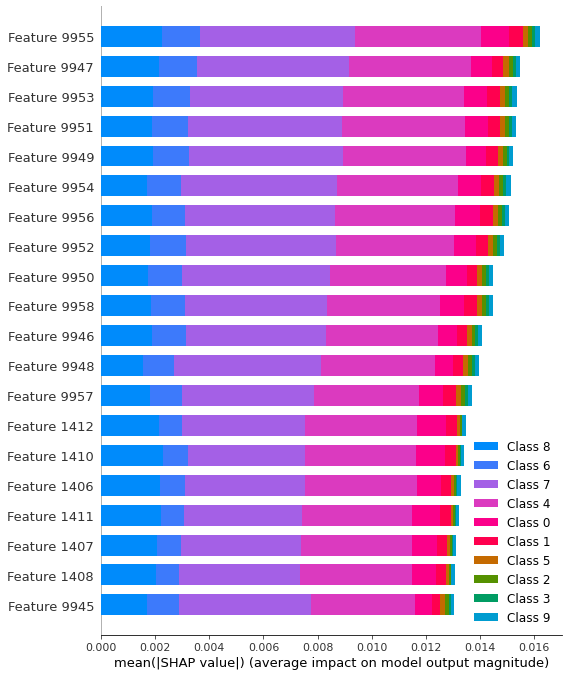

   class  sensitivity  specificity
0    1.0     0.827586     0.000000
1    2.0     0.923077     0.000000
2    3.0     0.895833     0.000000
3    4.0     0.899281     0.000000
4    5.0     0.915493     0.000000
5    6.0     0.872340     0.071429
6    7.0     0.875912     0.000000
7    8.0     0.891304     0.000000
8    9.0     0.905109     0.000000
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.900594
specificity    0.007143
dtype: float64


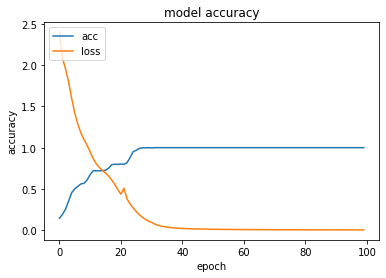

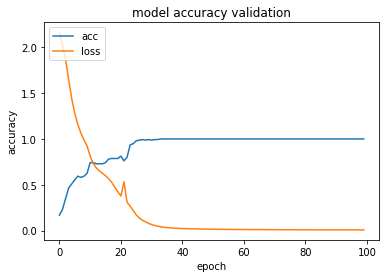

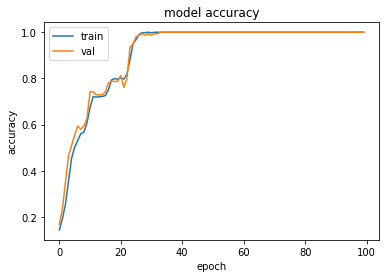

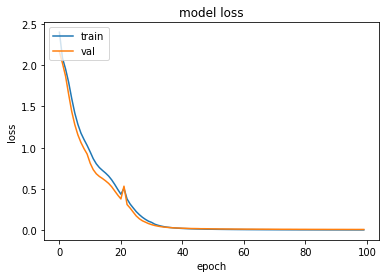

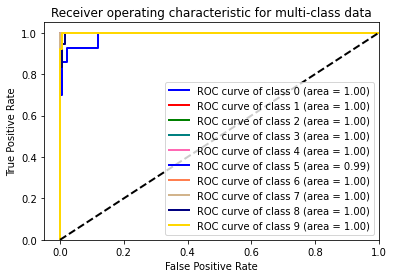

tanh relu


Singal=delta layer=tanh optimizer=rmsprop
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 38s - loss: 0.2941 - acc: 0.9718 - val_loss: 0.2211 - val_acc: 0.9677
Epoch 3/100
1240/1240 - 38s - loss: 0.0998 - acc: 0.9927 - val_loss: 0.2008 - val_acc: 0.9548
Epoch 4/100
1240/1240 - 38s - loss: 0.0450 - acc: 0.9952 - val_loss: 0.1812 - val_acc: 0.9742
Epoch 5/100
1240/1240 - 38s - loss: 0.0110 - acc: 1.0000 - val_loss: 0.1893 - val_acc: 0.9677
Epoch 6/100
1240/1240 - 38s - loss: 0.0038 - acc: 1.0000 - val_loss: 0.2199 - val_acc: 0.9677
Epoch 7/100
1240/1240 - 39s - loss: 0.0013 - acc: 1.0000 - val_loss: 0.2341 - val_acc: 0.9677
Epoch 8/100
1240/1240 - 38s - loss: 4.7356e-04 - acc: 1.0000 - val_loss: 0.2620 - val_acc: 0.9677
Epoch 9/100
1240/1240 - 38s - loss: 1.6850e-04 - acc: 1.0000 - val_loss: 0.2866 - val_acc: 0.9677
Epoch 10/100
1240/1240 - 38s - loss: 5.8890e-05 - acc: 1.0000 - val_loss: 0.3119 - val_acc: 0.9677
Epoch 11/100
1240/1240 - 38s - loss: 2.0430e-05 - acc: 1.0000 - val_loss: 0.3358 - val_acc: 0.9677
Epoch 12/100
1240/1240 - 39s - loss: 7.449

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


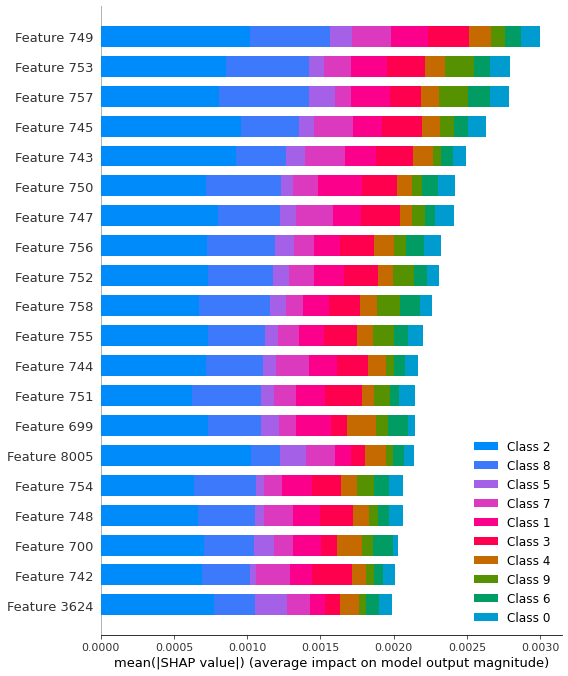

   class  sensitivity  specificity
0    1.0     0.862069          0.0
1    2.0     0.911111          0.0
2    3.0     0.888112          0.0
3    4.0     0.899281          0.0
4    5.0     0.851064          0.0
5    6.0     0.925373          0.0
6    7.0     0.868966          0.0
7    8.0     0.875000          0.0
8    9.0     0.884058          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.896503
specificity    0.000000
dtype: float64


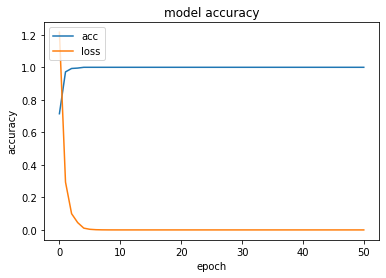

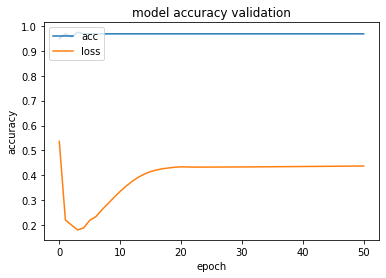

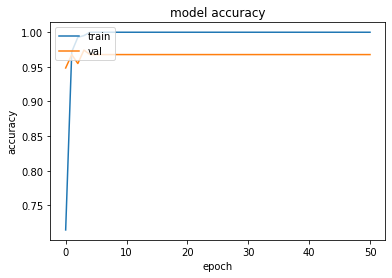

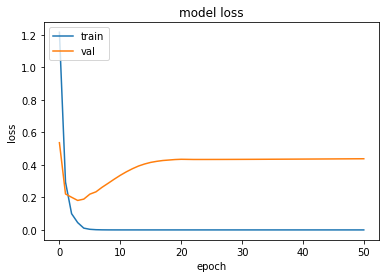

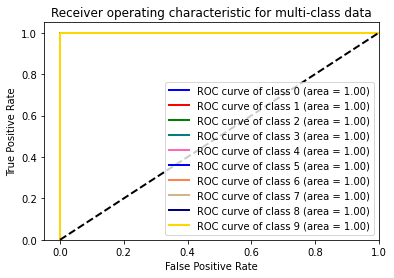

tanh relu


Singal=delta layer=tanh optimizer=adam
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 16s - loss: 0.3481 - acc: 0.9661 - val_loss: 0.3735 - val_acc: 0.9290
Epoch 3/100
1240/1240 - 16s - loss: 0.1870 - acc: 0.9790 - val_loss: 0.2562 - val_acc: 0.9548
Epoch 4/100
1240/1240 - 16s - loss: 0.1282 - acc: 0.9847 - val_loss: 0.2323 - val_acc: 0.9484
Epoch 5/100
1240/1240 - 16s - loss: 0.0658 - acc: 0.9952 - val_loss: 0.2301 - val_acc: 0.9419
Epoch 6/100
1240/1240 - 16s - loss: 0.0639 - acc: 0.9935 - val_loss: 0.1417 - val_acc: 0.9613
Epoch 7/100
1240/1240 - 16s - loss: 0.0367 - acc: 0.9984 - val_loss: 0.1466 - val_acc: 0.9548
Epoch 8/100
1240/1240 - 16s - loss: 0.0241 - acc: 1.0000 - val_loss: 0.1384 - val_acc: 0.9548
Epoch 9/100
1240/1240 - 16s - loss: 0.0192 - acc: 1.0000 - val_loss: 0.1340 - val_acc: 0.9548
Epoch 10/100
1240/1240 - 16s - loss: 0.0160 - acc: 1.0000 - val_loss: 0.1316 - val_acc: 0.9548
Epoch 11/100
1240/1240 - 17s - loss: 0.0135 - acc: 1.0000 - val_loss: 0.1303 - val_acc: 0.9548
Epoch 12/100
1240/1240 - 16s - loss: 0.0116 - acc: 1.0000 

Epoch 87/100
1240/1240 - 16s - loss: 4.0445e-05 - acc: 1.0000 - val_loss: 0.1787 - val_acc: 0.9677
Epoch 88/100
1240/1240 - 16s - loss: 3.8021e-05 - acc: 1.0000 - val_loss: 0.1795 - val_acc: 0.9677
Epoch 89/100
1240/1240 - 16s - loss: 3.5729e-05 - acc: 1.0000 - val_loss: 0.1804 - val_acc: 0.9677
Epoch 90/100
1240/1240 - 16s - loss: 3.3575e-05 - acc: 1.0000 - val_loss: 0.1812 - val_acc: 0.9677
Epoch 91/100
1240/1240 - 16s - loss: 3.1560e-05 - acc: 1.0000 - val_loss: 0.1821 - val_acc: 0.9677
Epoch 92/100
1240/1240 - 16s - loss: 2.9659e-05 - acc: 1.0000 - val_loss: 0.1829 - val_acc: 0.9677
Epoch 93/100
1240/1240 - 16s - loss: 2.7884e-05 - acc: 1.0000 - val_loss: 0.1838 - val_acc: 0.9677
Epoch 94/100
1240/1240 - 16s - loss: 2.6225e-05 - acc: 1.0000 - val_loss: 0.1847 - val_acc: 0.9677
Epoch 95/100
1240/1240 - 16s - loss: 2.4652e-05 - acc: 1.0000 - val_loss: 0.1855 - val_acc: 0.9677
Epoch 96/100
1240/1240 - 16s - loss: 2.3190e-05 - acc: 1.0000 - val_loss: 0.1863 - val_acc: 0.9677
Epoch 97/1

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


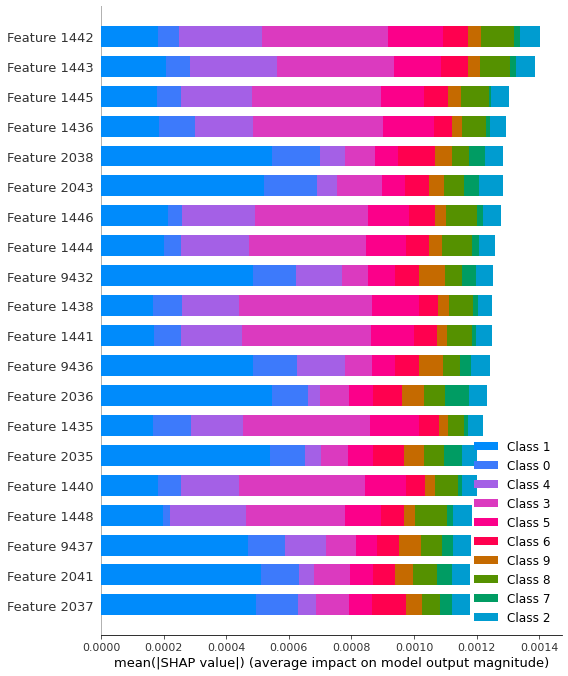

   class  sensitivity  specificity
0    1.0     0.877698          0.0
1    2.0     0.912409          0.0
2    3.0     0.867133          0.0
3    4.0     0.882353          0.0
4    5.0     0.877698          0.0
5    6.0     0.898551          0.0
6    7.0     0.907801          0.0
7    8.0     0.894366          0.0
8    9.0     0.885714          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.900372
specificity    0.000000
dtype: float64


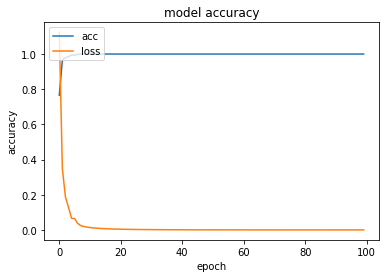

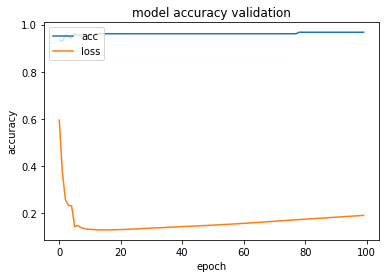

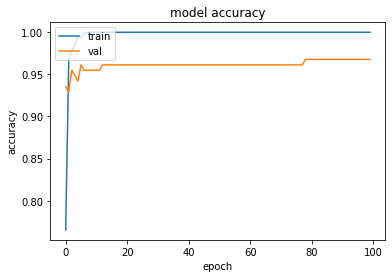

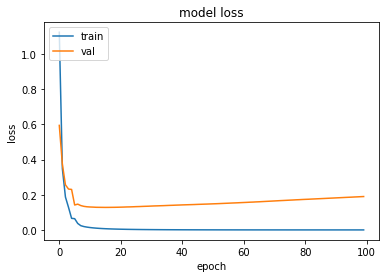

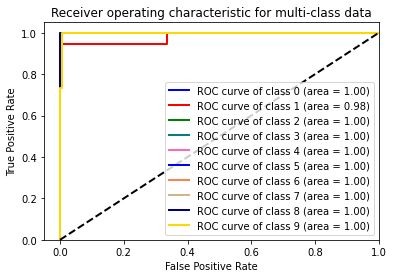

tanh relu


Singal=delta layer=tanh optimizer=nadam
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 66s - loss: 0.2907 - acc: 0.9823 - val_loss: 0.2450 - val_acc: 0.9806
Epoch 3/100
1240/1240 - 65s - loss: 0.2110 - acc: 0.9774 - val_loss: 0.5283 - val_acc: 0.8710
Epoch 4/100
1240/1240 - 66s - loss: 0.1987 - acc: 0.9629 - val_loss: 0.2251 - val_acc: 0.9484
Epoch 5/100
1240/1240 - 65s - loss: 0.0859 - acc: 0.9903 - val_loss: 0.1888 - val_acc: 0.9484
Epoch 6/100
1240/1240 - 65s - loss: 0.0472 - acc: 0.9968 - val_loss: 0.1401 - val_acc: 0.9742
Epoch 7/100
1240/1240 - 65s - loss: 0.0338 - acc: 0.9992 - val_loss: 0.1106 - val_acc: 0.9806
Epoch 8/100
1240/1240 - 65s - loss: 0.0263 - acc: 0.9992 - val_loss: 0.0854 - val_acc: 0.9871
Epoch 9/100
1240/1240 - 65s - loss: 0.0204 - acc: 0.9992 - val_loss: 0.0771 - val_acc: 0.9871
Epoch 10/100
1240/1240 - 65s - loss: 0.0167 - acc: 1.0000 - val_loss: 0.0742 - val_acc: 0.9871
Epoch 11/100
1240/1240 - 66s - loss: 0.0141 - acc: 1.0000 - val_loss: 0.0711 - val_acc: 0.9871
Epoch 12/100
1240/1240 - 65s - loss: 0.0120 - acc: 1.0000 

Epoch 87/100
1240/1240 - 65s - loss: 4.2937e-05 - acc: 1.0000 - val_loss: 0.0740 - val_acc: 0.9871
Epoch 88/100
1240/1240 - 65s - loss: 4.0355e-05 - acc: 1.0000 - val_loss: 0.0745 - val_acc: 0.9871
Epoch 89/100
1240/1240 - 65s - loss: 3.7935e-05 - acc: 1.0000 - val_loss: 0.0750 - val_acc: 0.9871
Epoch 90/100
1240/1240 - 65s - loss: 3.5644e-05 - acc: 1.0000 - val_loss: 0.0751 - val_acc: 0.9871
Epoch 91/100
1240/1240 - 65s - loss: 3.3505e-05 - acc: 1.0000 - val_loss: 0.0754 - val_acc: 0.9871
Epoch 92/100
1240/1240 - 65s - loss: 3.1506e-05 - acc: 1.0000 - val_loss: 0.0761 - val_acc: 0.9871
Epoch 93/100
1240/1240 - 65s - loss: 2.9611e-05 - acc: 1.0000 - val_loss: 0.0763 - val_acc: 0.9871
Epoch 94/100
1240/1240 - 65s - loss: 2.7841e-05 - acc: 1.0000 - val_loss: 0.0767 - val_acc: 0.9871
Epoch 95/100
1240/1240 - 65s - loss: 2.6157e-05 - acc: 1.0000 - val_loss: 0.0771 - val_acc: 0.9871
Epoch 96/100
1240/1240 - 65s - loss: 2.4587e-05 - acc: 1.0000 - val_loss: 0.0775 - val_acc: 0.9871
Epoch 97/1

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


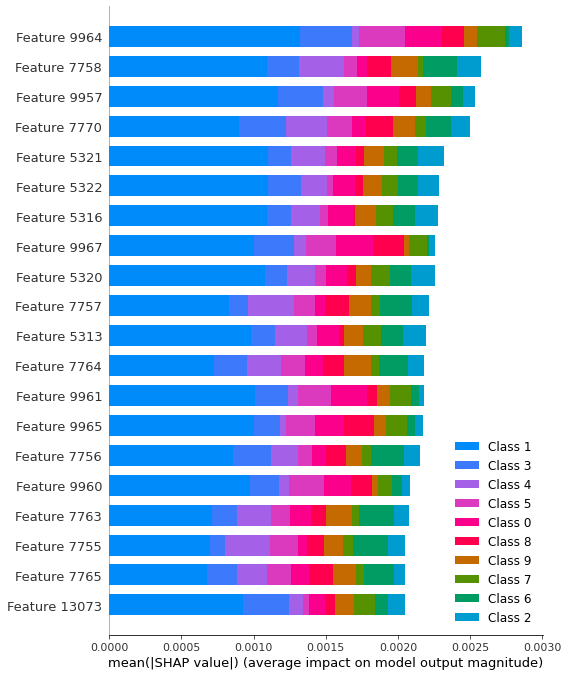

   class  sensitivity  specificity
0    1.0     0.846715          0.0
1    2.0     0.917910          0.0
2    3.0     0.882759          0.0
3    4.0     0.892086          0.0
4    5.0     0.878571          0.0
5    6.0     0.905109          0.0
6    7.0     0.901408          0.0
7    8.0     0.900709          0.0
8    9.0     0.900000          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.902527
specificity    0.000000
dtype: float64


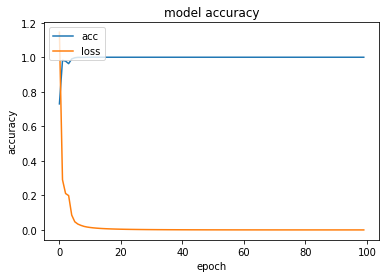

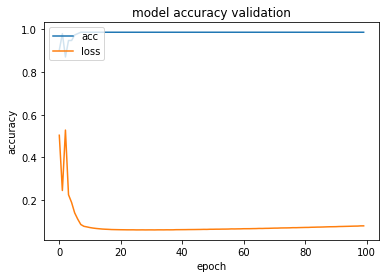

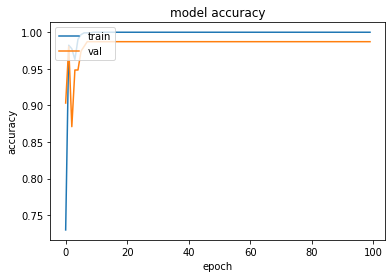

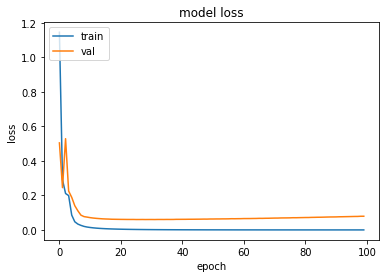

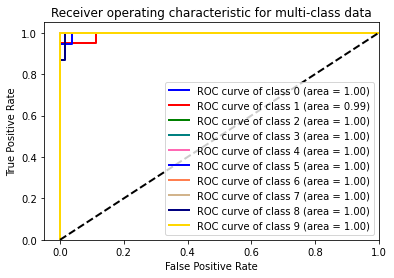

tanh relu


Singal=delta layer=tanh optimizer=sgd
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________


`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


1240/1240 - 11s - loss: 1.4770 - acc: 0.7258 - val_loss: 0.9722 - val_acc: 0.9548
Epoch 2/100
1240/1240 - 11s - loss: 0.6099 - acc: 0.9944 - val_loss: 0.5085 - val_acc: 0.9677
Epoch 3/100
1240/1240 - 11s - loss: 0.3092 - acc: 1.0000 - val_loss: 0.3380 - val_acc: 0.9677
Epoch 4/100
1240/1240 - 11s - loss: 0.1981 - acc: 1.0000 - val_loss: 0.2646 - val_acc: 0.9677
Epoch 5/100
1240/1240 - 11s - loss: 0.1467 - acc: 1.0000 - val_loss: 0.2226 - val_acc: 0.9677
Epoch 6/100
1240/1240 - 11s - loss: 0.1169 - acc: 1.0000 - val_loss: 0.1967 - val_acc: 0.9742
Epoch 7/100
1240/1240 - 11s - loss: 0.0973 - acc: 1.0000 - val_loss: 0.1785 - val_acc: 0.9677
Epoch 8/100
1240/1240 - 11s - loss: 0.0833 - acc: 1.0000 - val_loss: 0.1646 - val_acc: 0.9677
Epoch 9/100
1240/1240 - 11s - loss: 0.0729 - acc: 1.0000 - val_loss: 0.1538 - val_acc: 0.9677
Epoch 10/100
1240/1240 - 11s - loss: 0.0647 - acc: 1.0000 - val_loss: 0.1454 - val_acc: 0.9742
Epoch 11/100
1240/1240 - 11s - loss: 0.0582 - acc: 1.0000 - val_loss: 0

Epoch 88/100
1240/1240 - 11s - loss: 0.0065 - acc: 1.0000 - val_loss: 0.0859 - val_acc: 0.9742
Epoch 89/100
1240/1240 - 11s - loss: 0.0065 - acc: 1.0000 - val_loss: 0.0859 - val_acc: 0.9742
Epoch 90/100
1240/1240 - 11s - loss: 0.0064 - acc: 1.0000 - val_loss: 0.0859 - val_acc: 0.9742
Epoch 91/100
1240/1240 - 11s - loss: 0.0063 - acc: 1.0000 - val_loss: 0.0858 - val_acc: 0.9742
Epoch 92/100
1240/1240 - 11s - loss: 0.0062 - acc: 1.0000 - val_loss: 0.0858 - val_acc: 0.9742
Epoch 93/100
1240/1240 - 11s - loss: 0.0062 - acc: 1.0000 - val_loss: 0.0858 - val_acc: 0.9742
Epoch 94/100
1240/1240 - 11s - loss: 0.0061 - acc: 1.0000 - val_loss: 0.0858 - val_acc: 0.9742
Epoch 95/100
1240/1240 - 11s - loss: 0.0060 - acc: 1.0000 - val_loss: 0.0857 - val_acc: 0.9742
Epoch 96/100
1240/1240 - 11s - loss: 0.0060 - acc: 1.0000 - val_loss: 0.0857 - val_acc: 0.9742
Epoch 97/100
1240/1240 - 11s - loss: 0.0059 - acc: 1.0000 - val_loss: 0.0857 - val_acc: 0.9742
Epoch 98/100
1240/1240 - 11s - loss: 0.0059 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


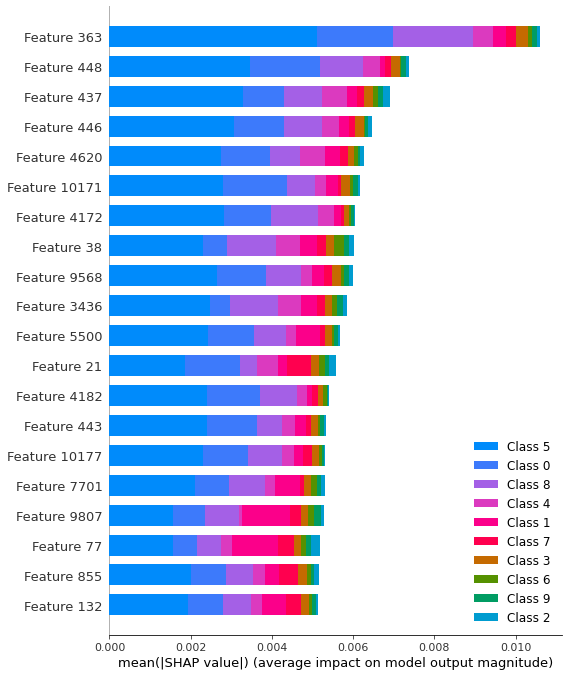

   class  sensitivity  specificity
0    1.0     0.832168          0.0
1    2.0     0.900000          0.0
2    3.0     0.894366          0.0
3    4.0     0.914286          0.0
4    5.0     0.874126          0.0
5    6.0     0.890511          0.0
6    7.0     0.892857          0.0
7    8.0     0.865248          0.0
8    9.0     0.911765          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.897533
specificity    0.000000
dtype: float64


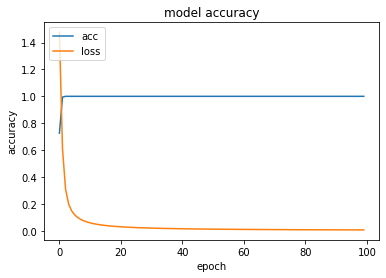

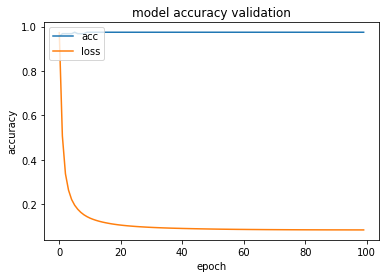

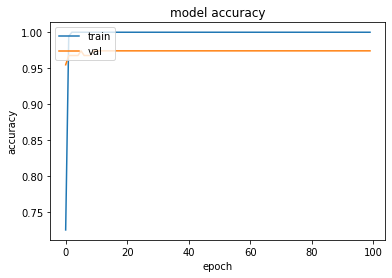

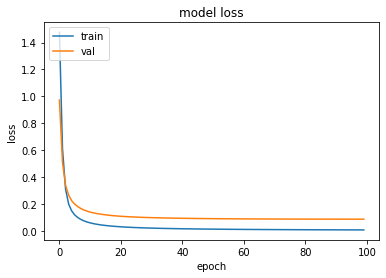

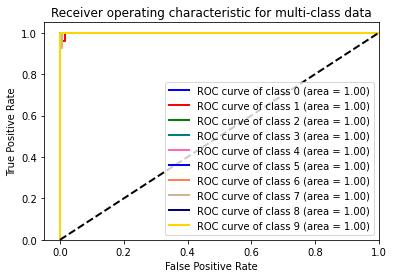

tanh relu


Singal=delta layer=tanh optimizer=adadelta
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_____________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 21s - loss: 2.1682 - acc: 0.2274 - val_loss: 2.2661 - val_acc: 0.1677
Epoch 3/100
1240/1240 - 21s - loss: 2.0645 - acc: 0.3040 - val_loss: 2.2265 - val_acc: 0.1806
Epoch 4/100
1240/1240 - 21s - loss: 1.9809 - acc: 0.3903 - val_loss: 2.1913 - val_acc: 0.2194
Epoch 5/100
1240/1240 - 21s - loss: 1.9112 - acc: 0.4532 - val_loss: 2.1556 - val_acc: 0.2387
Epoch 6/100
1240/1240 - 21s - loss: 1.8512 - acc: 0.4968 - val_loss: 2.1210 - val_acc: 0.2516
Epoch 7/100
1240/1240 - 21s - loss: 1.7995 - acc: 0.5476 - val_loss: 2.0898 - val_acc: 0.2774
Epoch 8/100
1240/1240 - 21s - loss: 1.7531 - acc: 0.5871 - val_loss: 2.0595 - val_acc: 0.2968
Epoch 9/100
1240/1240 - 21s - loss: 1.7098 - acc: 0.6282 - val_loss: 2.0306 - val_acc: 0.3032
Epoch 10/100
1240/1240 - 21s - loss: 1.6707 - acc: 0.6573 - val_loss: 2.0022 - val_acc: 0.3290
Epoch 11/100
1240/1240 - 21s - loss: 1.6344 - acc: 0.6847 - val_loss: 1.9742 - val_acc: 0.3548
Epoch 12/100
1240/1240 - 21s - loss: 1.6006 - acc: 0.7105 

Epoch 89/100
1240/1240 - 21s - loss: 0.8642 - acc: 0.9968 - val_loss: 1.1574 - val_acc: 0.8581
Epoch 90/100
1240/1240 - 20s - loss: 0.8604 - acc: 0.9968 - val_loss: 1.1530 - val_acc: 0.8581
Epoch 91/100
1240/1240 - 21s - loss: 0.8566 - acc: 0.9968 - val_loss: 1.1480 - val_acc: 0.8581
Epoch 92/100
1240/1240 - 20s - loss: 0.8529 - acc: 0.9976 - val_loss: 1.1437 - val_acc: 0.8581
Epoch 93/100
1240/1240 - 21s - loss: 0.8492 - acc: 0.9976 - val_loss: 1.1386 - val_acc: 0.8645
Epoch 94/100
1240/1240 - 21s - loss: 0.8455 - acc: 0.9976 - val_loss: 1.1341 - val_acc: 0.8645
Epoch 95/100
1240/1240 - 21s - loss: 0.8420 - acc: 0.9976 - val_loss: 1.1294 - val_acc: 0.8645
Epoch 96/100
1240/1240 - 21s - loss: 0.8385 - acc: 0.9976 - val_loss: 1.1250 - val_acc: 0.8710
Epoch 97/100
1240/1240 - 21s - loss: 0.8350 - acc: 0.9992 - val_loss: 1.1204 - val_acc: 0.8710
Epoch 98/100
1240/1240 - 21s - loss: 0.8315 - acc: 0.9992 - val_loss: 1.1158 - val_acc: 0.8774
Epoch 99/100
1240/1240 - 21s - loss: 0.8280 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


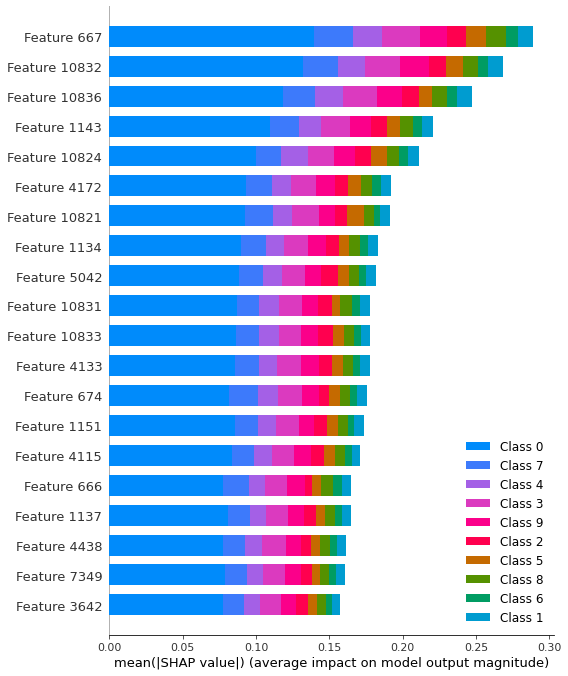

   class  sensitivity  specificity
0    1.0     0.843972          0.0
1    2.0     0.873134          0.0
2    3.0     0.913669          0.0
3    4.0     0.919708          0.0
4    5.0     0.895105          0.0
5    6.0     0.892086          0.0
6    7.0     0.914894          0.0
7    8.0     0.901408          0.0
8    9.0     0.835714          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.898969
specificity    0.000000
dtype: float64


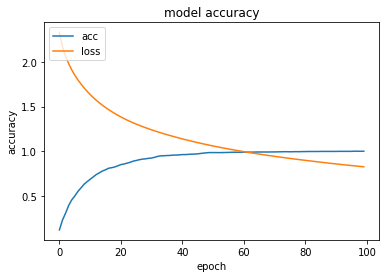

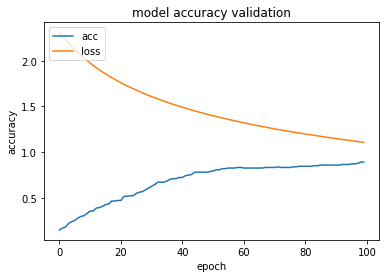

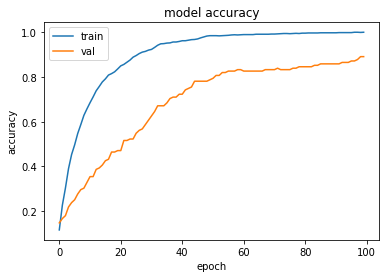

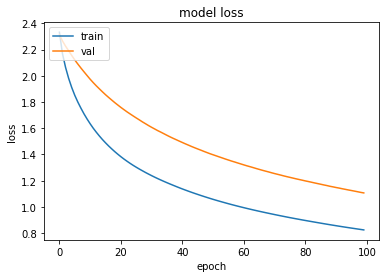

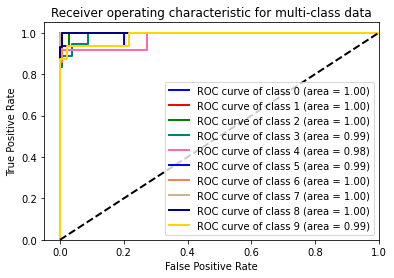

tanh relu


Singal=delta layer=tanh optimizer=adagrad
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 16s - loss: 1.2101 - acc: 0.9734 - val_loss: 1.1848 - val_acc: 0.9613
Epoch 3/100
1240/1240 - 16s - loss: 0.9502 - acc: 0.9944 - val_loss: 1.0193 - val_acc: 0.9613
Epoch 4/100
1240/1240 - 16s - loss: 0.7997 - acc: 0.9984 - val_loss: 0.9027 - val_acc: 0.9806
Epoch 5/100
1240/1240 - 16s - loss: 0.6966 - acc: 0.9992 - val_loss: 0.8211 - val_acc: 0.9742
Epoch 6/100
1240/1240 - 16s - loss: 0.6220 - acc: 1.0000 - val_loss: 0.7601 - val_acc: 0.9742
Epoch 7/100
1240/1240 - 16s - loss: 0.5658 - acc: 1.0000 - val_loss: 0.7105 - val_acc: 0.9742
Epoch 8/100
1240/1240 - 16s - loss: 0.5218 - acc: 1.0000 - val_loss: 0.6710 - val_acc: 0.9742
Epoch 9/100
1240/1240 - 16s - loss: 0.4865 - acc: 1.0000 - val_loss: 0.6360 - val_acc: 0.9742
Epoch 10/100
1240/1240 - 16s - loss: 0.4571 - acc: 1.0000 - val_loss: 0.6068 - val_acc: 0.9742
Epoch 11/100
1240/1240 - 16s - loss: 0.4320 - acc: 1.0000 - val_loss: 0.5816 - val_acc: 0.9742
Epoch 12/100
1240/1240 - 17s - loss: 0.4102 - acc: 1.0000 

Epoch 89/100
1240/1240 - 15s - loss: 0.1046 - acc: 1.0000 - val_loss: 0.2000 - val_acc: 0.9806
Epoch 90/100
1240/1240 - 15s - loss: 0.1037 - acc: 1.0000 - val_loss: 0.1990 - val_acc: 0.9806
Epoch 91/100
1240/1240 - 15s - loss: 0.1029 - acc: 1.0000 - val_loss: 0.1981 - val_acc: 0.9806
Epoch 92/100
1240/1240 - 15s - loss: 0.1022 - acc: 1.0000 - val_loss: 0.1971 - val_acc: 0.9806
Epoch 93/100
1240/1240 - 15s - loss: 0.1014 - acc: 1.0000 - val_loss: 0.1962 - val_acc: 0.9806
Epoch 94/100
1240/1240 - 15s - loss: 0.1006 - acc: 1.0000 - val_loss: 0.1952 - val_acc: 0.9806
Epoch 95/100
1240/1240 - 15s - loss: 0.0999 - acc: 1.0000 - val_loss: 0.1943 - val_acc: 0.9806
Epoch 96/100
1240/1240 - 15s - loss: 0.0991 - acc: 1.0000 - val_loss: 0.1935 - val_acc: 0.9806
Epoch 97/100
1240/1240 - 15s - loss: 0.0984 - acc: 1.0000 - val_loss: 0.1926 - val_acc: 0.9806
Epoch 98/100
1240/1240 - 15s - loss: 0.0977 - acc: 1.0000 - val_loss: 0.1917 - val_acc: 0.9806
Epoch 99/100
1240/1240 - 15s - loss: 0.0970 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


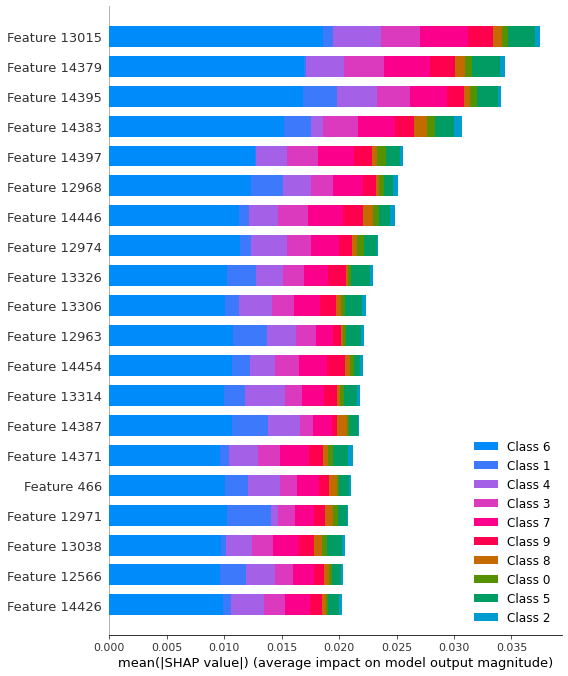

   class  sensitivity  specificity
0    1.0     0.846154         0.00
1    2.0     0.917293         0.00
2    3.0     0.868056         0.00
3    4.0     0.896296         0.00
4    5.0     0.872340         0.00
5    6.0     0.919708         0.00
6    7.0     0.902778         0.00
7    8.0     0.873239         0.00
8    9.0     0.896296         0.05
9   10.0     1.000000         0.00
class          5.500000
sensitivity    0.899216
specificity    0.005000
dtype: float64


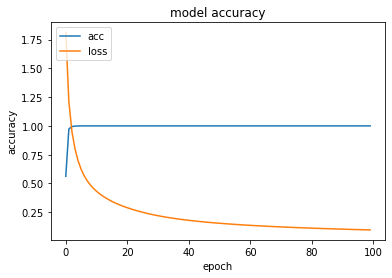

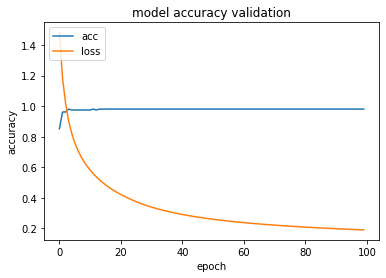

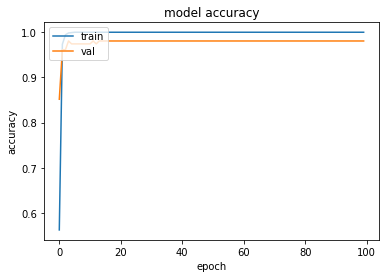

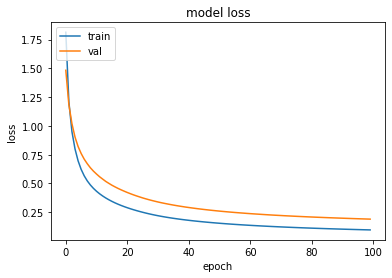

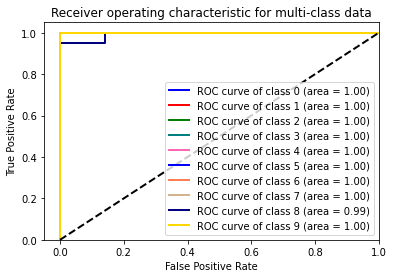

tanh relu


Singal=delta layer=tanh optimizer=adamax
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


1240/1240 - 23s - loss: 1.1669 - acc: 0.8040 - val_loss: 0.6313 - val_acc: 0.9677
Epoch 2/100
1240/1240 - 23s - loss: 0.4395 - acc: 0.9960 - val_loss: 0.3652 - val_acc: 0.9871
Epoch 3/100
1240/1240 - 23s - loss: 0.2589 - acc: 0.9976 - val_loss: 0.2687 - val_acc: 0.9871
Epoch 4/100
1240/1240 - 23s - loss: 0.1853 - acc: 0.9992 - val_loss: 0.2216 - val_acc: 0.9806
Epoch 5/100
1240/1240 - 23s - loss: 0.1403 - acc: 1.0000 - val_loss: 0.1908 - val_acc: 0.9806
Epoch 6/100
1240/1240 - 23s - loss: 0.1113 - acc: 1.0000 - val_loss: 0.1705 - val_acc: 0.9806
Epoch 7/100
1240/1240 - 23s - loss: 0.0907 - acc: 1.0000 - val_loss: 0.1552 - val_acc: 0.9806
Epoch 8/100
1240/1240 - 23s - loss: 0.0750 - acc: 1.0000 - val_loss: 0.1433 - val_acc: 0.9806
Epoch 9/100
1240/1240 - 22s - loss: 0.0627 - acc: 1.0000 - val_loss: 0.1343 - val_acc: 0.9806
Epoch 10/100
1240/1240 - 22s - loss: 0.0529 - acc: 1.0000 - val_loss: 0.1275 - val_acc: 0.9806
Epoch 11/100
1240/1240 - 23s - loss: 0.0450 - acc: 1.0000 - val_loss: 0

Epoch 86/100
1240/1240 - 21s - loss: 3.1197e-06 - acc: 1.0000 - val_loss: 0.1920 - val_acc: 0.9871
Epoch 87/100
1240/1240 - 21s - loss: 2.7575e-06 - acc: 1.0000 - val_loss: 0.1934 - val_acc: 0.9871
Epoch 88/100
1240/1240 - 21s - loss: 2.4476e-06 - acc: 1.0000 - val_loss: 0.1948 - val_acc: 0.9871
Epoch 89/100
1240/1240 - 21s - loss: 2.1245e-06 - acc: 1.0000 - val_loss: 0.1963 - val_acc: 0.9871
Epoch 90/100
1240/1240 - 21s - loss: 1.9000e-06 - acc: 1.0000 - val_loss: 0.1978 - val_acc: 0.9871
Epoch 91/100
1240/1240 - 21s - loss: 1.6851e-06 - acc: 1.0000 - val_loss: 0.1991 - val_acc: 0.9871
Epoch 92/100
1240/1240 - 21s - loss: 1.5110e-06 - acc: 1.0000 - val_loss: 0.2006 - val_acc: 0.9871
Epoch 93/100
1240/1240 - 21s - loss: 1.3322e-06 - acc: 1.0000 - val_loss: 0.2021 - val_acc: 0.9871
Epoch 94/100
1240/1240 - 21s - loss: 1.1514e-06 - acc: 1.0000 - val_loss: 0.2034 - val_acc: 0.9871
Epoch 95/100
1240/1240 - 21s - loss: 1.0534e-06 - acc: 1.0000 - val_loss: 0.2049 - val_acc: 0.9871
Epoch 96/1

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


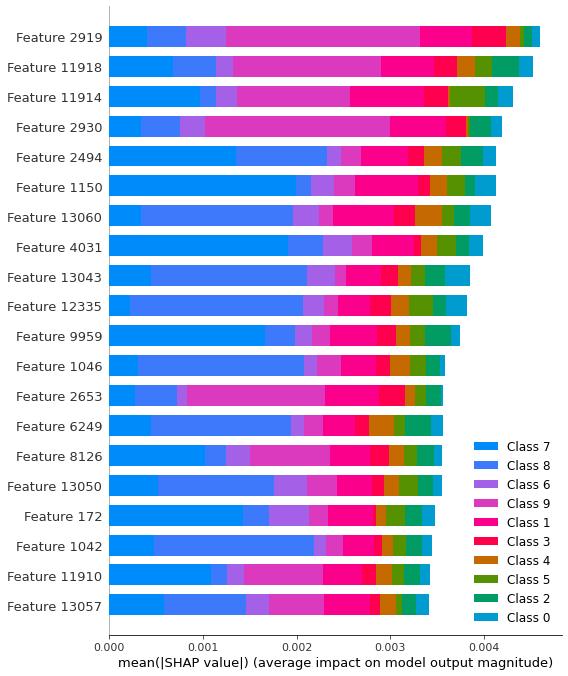

   class  sensitivity  specificity
0    1.0     0.823944          0.0
1    2.0     0.907692          0.0
2    3.0     0.881119          0.0
3    4.0     0.891304          0.0
4    5.0     0.907143          0.0
5    6.0     0.922535          0.0
6    7.0     0.861111          0.0
7    8.0     0.874074          0.0
8    9.0     0.913043          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.898197
specificity    0.000000
dtype: float64


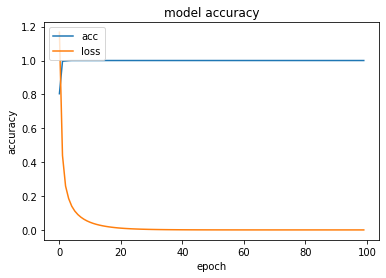

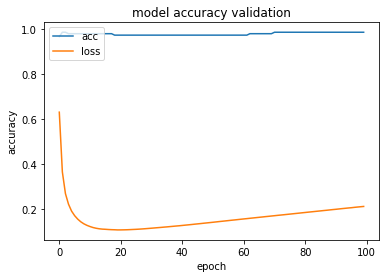

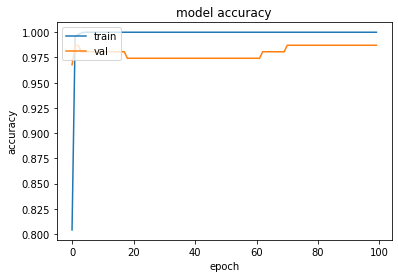

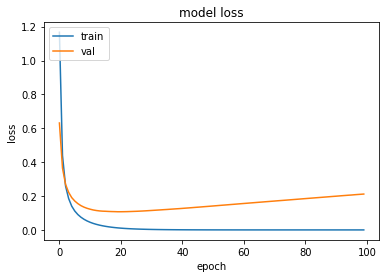

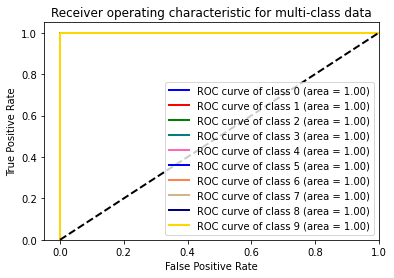

tanh relu


Singal=delta layer=tanh optimizer=ftrl
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 24s - loss: 2.3026 - acc: 0.0968 - val_loss: 2.3030 - val_acc: 0.0774
Epoch 3/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0774
Epoch 4/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0774
Epoch 5/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0774
Epoch 6/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3033 - val_acc: 0.0774
Epoch 7/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3034 - val_acc: 0.0774
Epoch 8/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3034 - val_acc: 0.0774
Epoch 9/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3035 - val_acc: 0.0774
Epoch 10/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3035 - val_acc: 0.0774
Epoch 11/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3036 - val_acc: 0.0774
Epoch 12/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 

Epoch 89/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3054 - val_acc: 0.0774
Epoch 90/100
1240/1240 - 23s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3054 - val_acc: 0.0774
Epoch 91/100
1240/1240 - 21s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3054 - val_acc: 0.0774
Epoch 92/100
1240/1240 - 21s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3054 - val_acc: 0.0774
Epoch 93/100
1240/1240 - 21s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3054 - val_acc: 0.0774
Epoch 94/100
1240/1240 - 21s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3054 - val_acc: 0.0774
Epoch 95/100
1240/1240 - 22s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3054 - val_acc: 0.0774
Epoch 96/100
1240/1240 - 22s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3055 - val_acc: 0.0774
Epoch 97/100
1240/1240 - 21s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3055 - val_acc: 0.0774
Epoch 98/100
1240/1240 - 21s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3055 - val_acc: 0.0774
Epoch 99/100
1240/1240 - 22s - loss: 2.3021 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


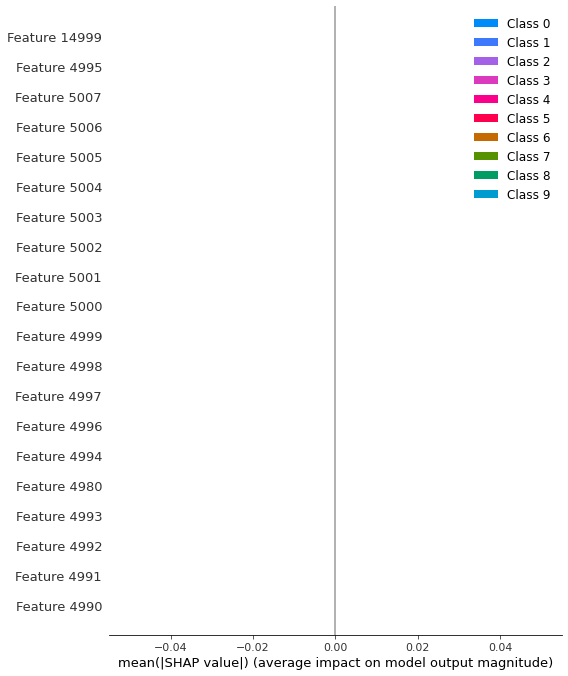

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


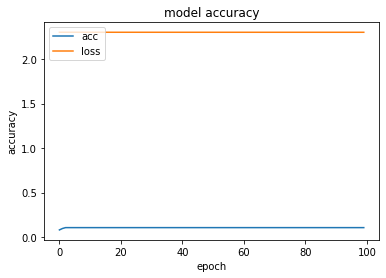

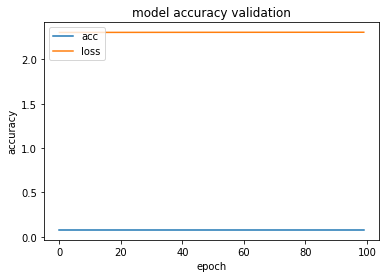

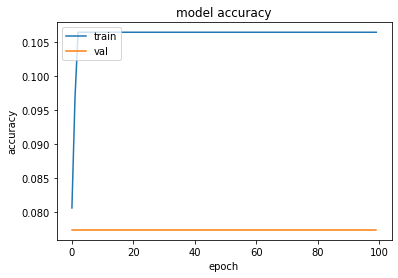

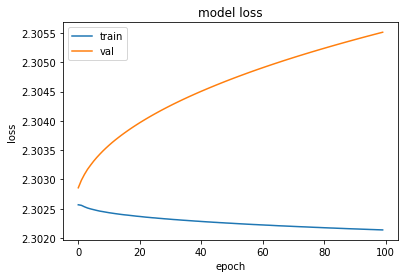

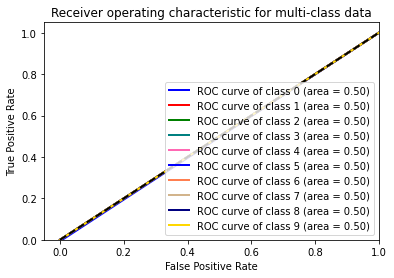

relu tanh


Singal=delta layer=relu optimizer=rmsprop
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 38s - loss: 2.3063 - acc: 0.0871 - val_loss: 2.3025 - val_acc: 0.0968
Epoch 3/100
1240/1240 - 38s - loss: 2.3028 - acc: 0.1024 - val_loss: 2.3038 - val_acc: 0.0968
Epoch 4/100
1240/1240 - 39s - loss: 2.3026 - acc: 0.0911 - val_loss: 2.3047 - val_acc: 0.0968
Epoch 5/100
1240/1240 - 38s - loss: 2.3024 - acc: 0.0984 - val_loss: 2.3057 - val_acc: 0.0968
Epoch 6/100
1240/1240 - 39s - loss: 2.3023 - acc: 0.0984 - val_loss: 2.3066 - val_acc: 0.0968
Epoch 7/100
1240/1240 - 38s - loss: 2.3022 - acc: 0.1024 - val_loss: 2.3074 - val_acc: 0.0968
Epoch 8/100
1240/1240 - 38s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3084 - val_acc: 0.0968
Epoch 9/100
1240/1240 - 39s - loss: 2.3020 - acc: 0.1065 - val_loss: 2.3095 - val_acc: 0.0968
Epoch 10/100
1240/1240 - 39s - loss: 2.3020 - acc: 0.1065 - val_loss: 2.3099 - val_acc: 0.0968
Epoch 11/100
1240/1240 - 38s - loss: 2.3020 - acc: 0.1065 - val_loss: 2.3105 - val_acc: 0.0968
Epoch 12/100
1240/1240 - 38s - loss: 2.3019 - acc: 0.1065 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


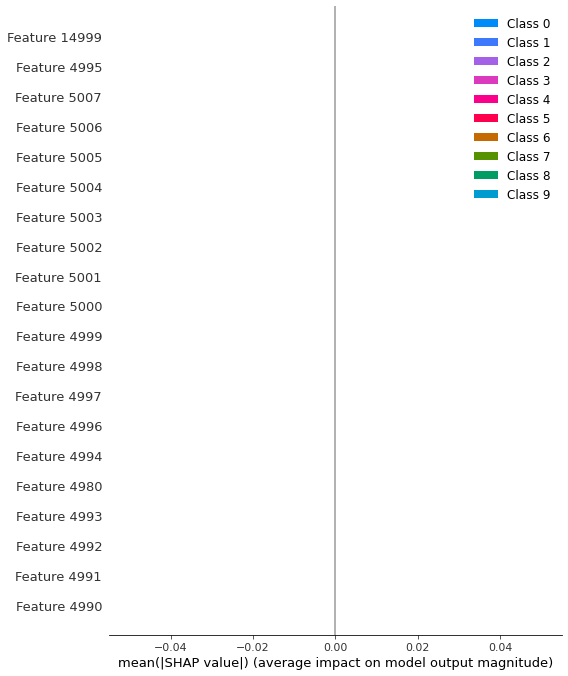

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


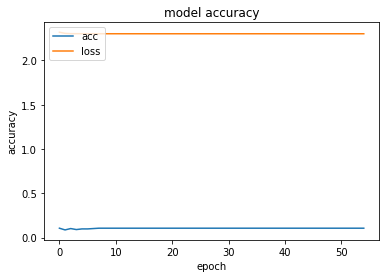

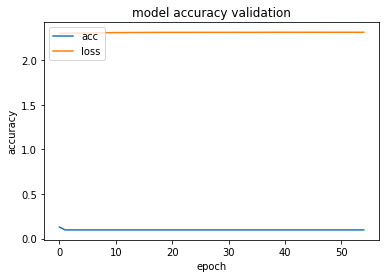

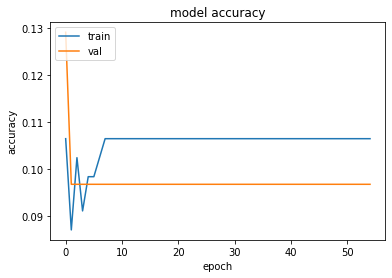

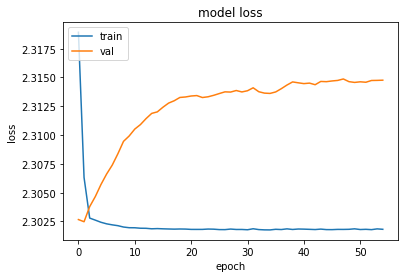

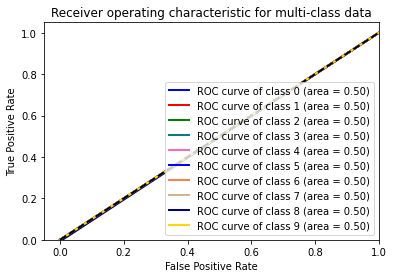

relu tanh


Singal=delta layer=relu optimizer=adam
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 15s - loss: 2.3069 - acc: 0.0863 - val_loss: 2.3030 - val_acc: 0.0903
Epoch 3/100
1240/1240 - 15s - loss: 2.3027 - acc: 0.0952 - val_loss: 2.3040 - val_acc: 0.0903
Epoch 4/100
1240/1240 - 16s - loss: 2.3025 - acc: 0.1008 - val_loss: 2.3053 - val_acc: 0.0903
Epoch 5/100
1240/1240 - 15s - loss: 2.3024 - acc: 0.0944 - val_loss: 2.3062 - val_acc: 0.0903
Epoch 6/100
1240/1240 - 15s - loss: 2.3023 - acc: 0.0935 - val_loss: 2.3071 - val_acc: 0.0903
Epoch 7/100
1240/1240 - 15s - loss: 2.3022 - acc: 0.0992 - val_loss: 2.3081 - val_acc: 0.0710
Epoch 8/100
1240/1240 - 15s - loss: 2.3020 - acc: 0.1065 - val_loss: 2.3086 - val_acc: 0.0710
Epoch 9/100
1240/1240 - 15s - loss: 2.3019 - acc: 0.1000 - val_loss: 2.3091 - val_acc: 0.0710
Epoch 10/100
1240/1240 - 15s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3100 - val_acc: 0.0710
Epoch 11/100
1240/1240 - 15s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3103 - val_acc: 0.0710
Epoch 12/100
1240/1240 - 15s - loss: 2.3019 - acc: 0.1000 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


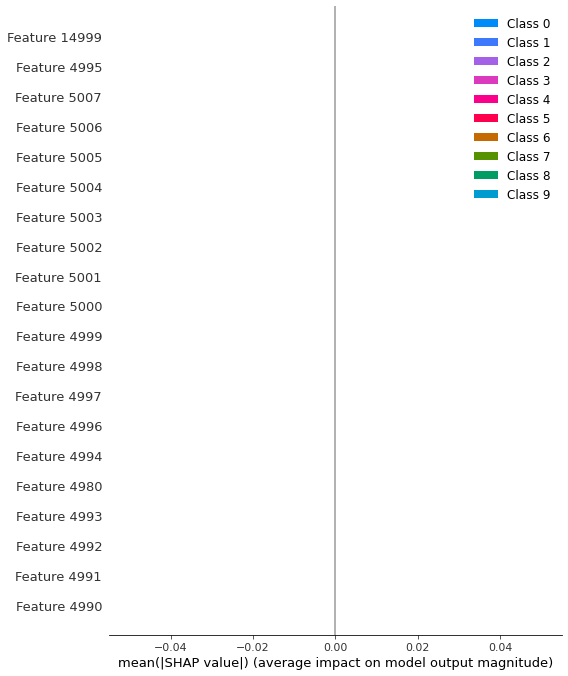

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


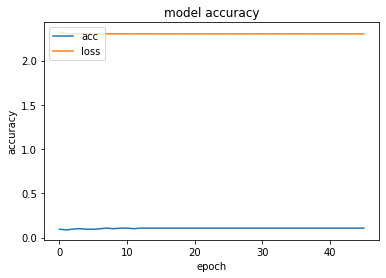

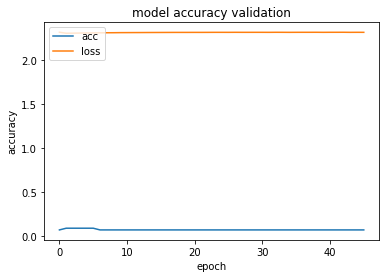

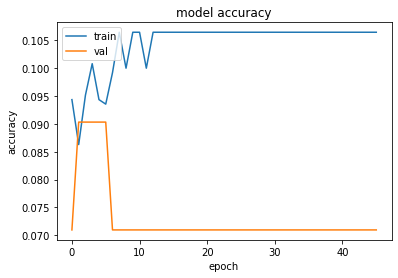

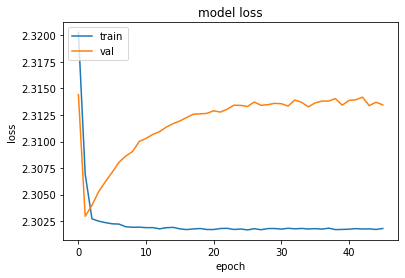

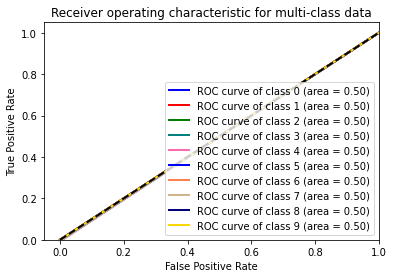

relu tanh


Singal=delta layer=relu optimizer=nadam
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 65s - loss: 2.3046 - acc: 0.0879 - val_loss: 2.3035 - val_acc: 0.0903
Epoch 3/100
1240/1240 - 65s - loss: 2.3025 - acc: 0.0927 - val_loss: 2.3041 - val_acc: 0.0903
Epoch 4/100
1240/1240 - 65s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3048 - val_acc: 0.0903
Epoch 5/100
1240/1240 - 65s - loss: 2.3022 - acc: 0.1056 - val_loss: 2.3054 - val_acc: 0.0903
Epoch 6/100
1240/1240 - 64s - loss: 2.3021 - acc: 0.1024 - val_loss: 2.3058 - val_acc: 0.0903
Epoch 7/100
1240/1240 - 65s - loss: 2.3021 - acc: 0.1032 - val_loss: 2.3063 - val_acc: 0.0903
Epoch 8/100
1240/1240 - 64s - loss: 2.3020 - acc: 0.0952 - val_loss: 2.3067 - val_acc: 0.0903
Epoch 9/100
1240/1240 - 65s - loss: 2.3020 - acc: 0.1008 - val_loss: 2.3069 - val_acc: 0.0903
Epoch 10/100
1240/1240 - 65s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3073 - val_acc: 0.0903
Epoch 11/100
1240/1240 - 65s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3075 - val_acc: 0.0903
Epoch 12/100
1240/1240 - 65s - loss: 2.3019 - acc: 0.1065 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


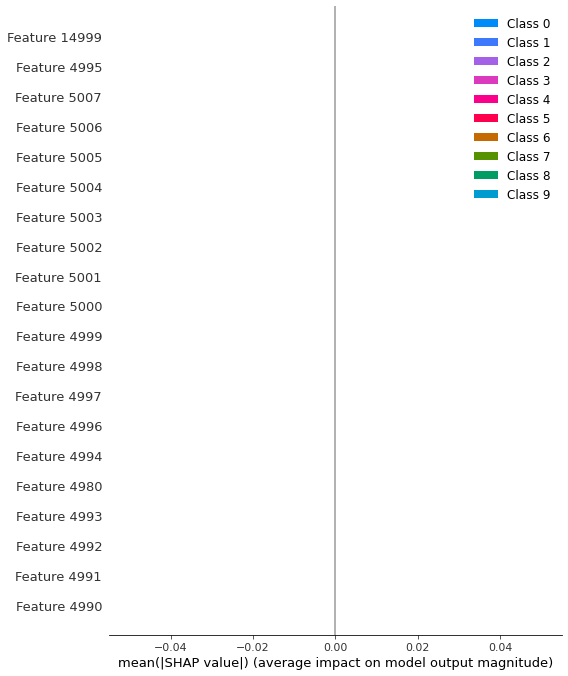

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


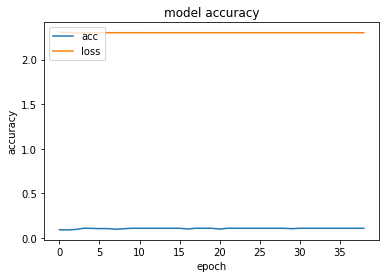

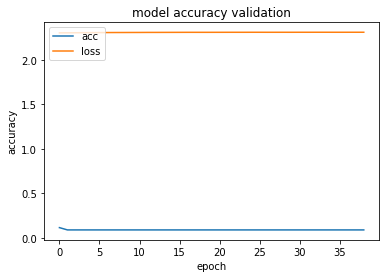

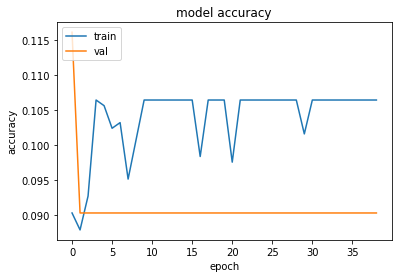

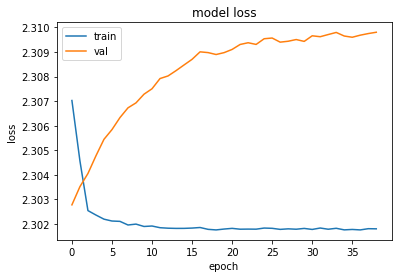

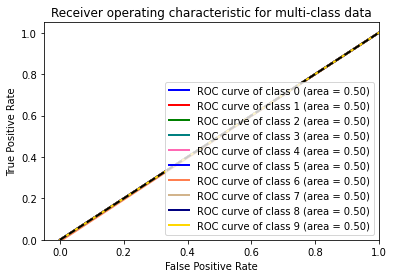

relu tanh


Singal=delta layer=relu optimizer=sgd
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________


`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 11s - loss: 1.9033 - acc: 0.3452 - val_loss: 2.2664 - val_acc: 0.1871
Epoch 3/100
1240/1240 - 11s - loss: 1.8907 - acc: 0.3452 - val_loss: 1.9105 - val_acc: 0.2516
Epoch 4/100
1240/1240 - 11s - loss: 1.9077 - acc: 0.3177 - val_loss: 1.6338 - val_acc: 0.4516
Epoch 5/100
1240/1240 - 11s - loss: 1.8867 - acc: 0.3290 - val_loss: 1.9143 - val_acc: 0.3032
Epoch 6/100
1240/1240 - 11s - loss: 1.5031 - acc: 0.4718 - val_loss: 1.5317 - val_acc: 0.5161
Epoch 7/100
1240/1240 - 11s - loss: 1.4106 - acc: 0.4911 - val_loss: 1.4962 - val_acc: 0.5161
Epoch 8/100
1240/1240 - 11s - loss: 1.4420 - acc: 0.4855 - val_loss: 1.3067 - val_acc: 0.5677
Epoch 9/100
1240/1240 - 11s - loss: 1.4564 - acc: 0.4911 - val_loss: 1.8578 - val_acc: 0.3290
Epoch 10/100
1240/1240 - 11s - loss: 1.2546 - acc: 0.5460 - val_loss: 1.1682 - val_acc: 0.5935
Epoch 11/100
1240/1240 - 11s - loss: 1.1187 - acc: 0.6137 - val_loss: 1.1576 - val_acc: 0.5613
Epoch 12/100
1240/1240 - 11s - loss: 1.0932 - acc: 0.6242 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


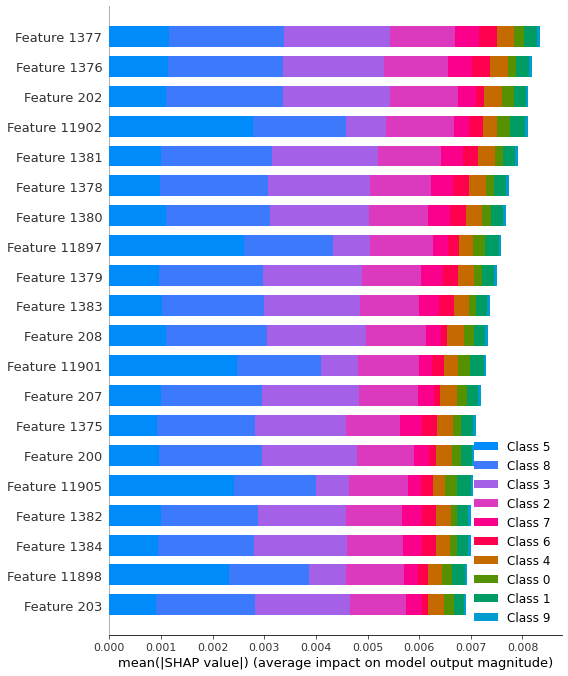

   class  sensitivity  specificity
0    1.0     1.000000     0.000000
1    2.0     0.511450     0.208333
2    3.0     0.993151     0.000000
3    4.0     0.875912     0.166667
4    5.0     0.944056     0.000000
5    6.0     1.000000     0.000000
6    7.0     0.972603     0.111111
7    8.0     0.721429     0.600000
8    9.0     1.000000     0.000000
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.901860
specificity    0.108611
dtype: float64


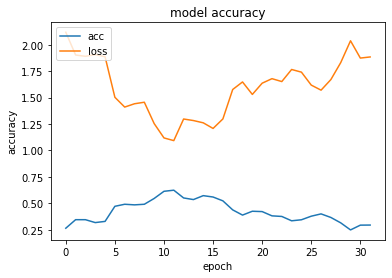

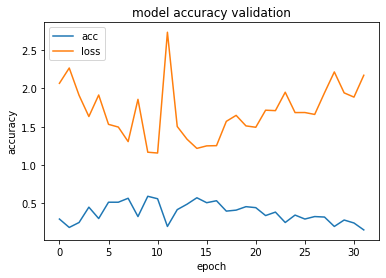

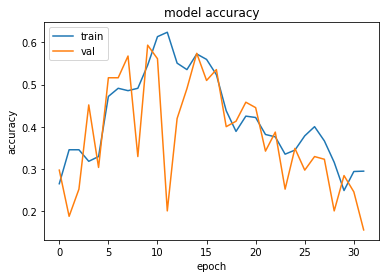

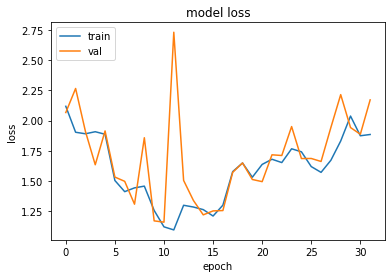

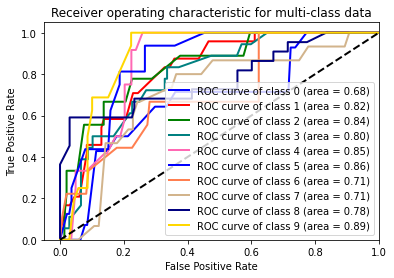

relu tanh


Singal=delta layer=relu optimizer=adadelta
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_____________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 21s - loss: 2.1224 - acc: 0.1968 - val_loss: 2.2248 - val_acc: 0.1419
Epoch 3/100
1240/1240 - 21s - loss: 2.0334 - acc: 0.2516 - val_loss: 2.1913 - val_acc: 0.1548
Epoch 4/100
1240/1240 - 21s - loss: 1.9713 - acc: 0.3073 - val_loss: 2.1620 - val_acc: 0.1677
Epoch 5/100
1240/1240 - 21s - loss: 1.9198 - acc: 0.3492 - val_loss: 2.1371 - val_acc: 0.1742
Epoch 6/100
1240/1240 - 21s - loss: 1.8767 - acc: 0.3847 - val_loss: 2.1136 - val_acc: 0.2000
Epoch 7/100
1240/1240 - 21s - loss: 1.8387 - acc: 0.4242 - val_loss: 2.0882 - val_acc: 0.2194
Epoch 8/100
1240/1240 - 21s - loss: 1.8035 - acc: 0.4524 - val_loss: 2.0698 - val_acc: 0.2258
Epoch 9/100
1240/1240 - 21s - loss: 1.7720 - acc: 0.4855 - val_loss: 2.0498 - val_acc: 0.2323
Epoch 10/100
1240/1240 - 21s - loss: 1.7424 - acc: 0.5040 - val_loss: 2.0318 - val_acc: 0.2452
Epoch 11/100
1240/1240 - 21s - loss: 1.7149 - acc: 0.5403 - val_loss: 2.0073 - val_acc: 0.2710
Epoch 12/100
1240/1240 - 21s - loss: 1.6884 - acc: 0.5524 

Epoch 89/100
1240/1240 - 21s - loss: 0.9959 - acc: 0.8653 - val_loss: 1.3017 - val_acc: 0.7161
Epoch 90/100
1240/1240 - 21s - loss: 0.9914 - acc: 0.8621 - val_loss: 1.2955 - val_acc: 0.7226
Epoch 91/100
1240/1240 - 21s - loss: 0.9865 - acc: 0.8653 - val_loss: 1.2869 - val_acc: 0.7484
Epoch 92/100
1240/1240 - 21s - loss: 0.9821 - acc: 0.8653 - val_loss: 1.2808 - val_acc: 0.7613
Epoch 93/100
1240/1240 - 21s - loss: 0.9773 - acc: 0.8653 - val_loss: 1.2767 - val_acc: 0.7484
Epoch 94/100
1240/1240 - 21s - loss: 0.9729 - acc: 0.8669 - val_loss: 1.2721 - val_acc: 0.7548
Epoch 95/100
1240/1240 - 21s - loss: 0.9681 - acc: 0.8653 - val_loss: 1.2691 - val_acc: 0.7548
Epoch 96/100
1240/1240 - 21s - loss: 0.9637 - acc: 0.8661 - val_loss: 1.2644 - val_acc: 0.7613
Epoch 97/100
1240/1240 - 21s - loss: 0.9595 - acc: 0.8685 - val_loss: 1.2575 - val_acc: 0.7613
Epoch 98/100
1240/1240 - 21s - loss: 0.9552 - acc: 0.8685 - val_loss: 1.2533 - val_acc: 0.7548
Epoch 99/100
1240/1240 - 21s - loss: 0.9508 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


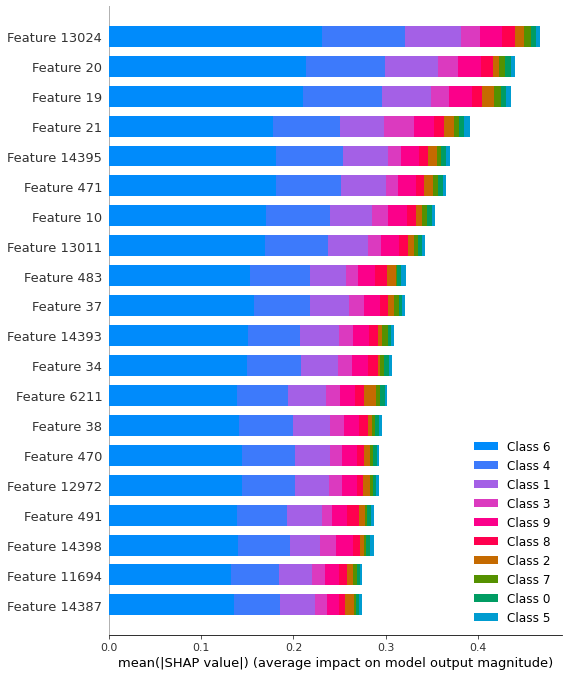

   class  sensitivity  specificity
0    1.0     0.787671     0.000000
1    2.0     0.944444     0.000000
2    3.0     0.877551     0.000000
3    4.0     0.753623     0.058824
4    5.0     0.882759     0.000000
5    6.0     1.000000     0.000000
6    7.0     0.927536     0.000000
7    8.0     0.890511     0.000000
8    9.0     0.906475     0.062500
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.897057
specificity    0.012132
dtype: float64


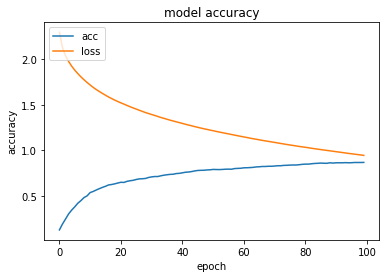

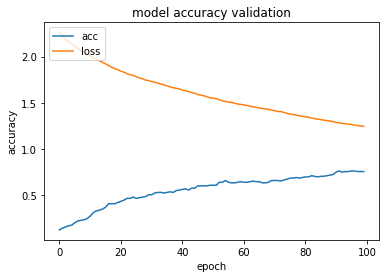

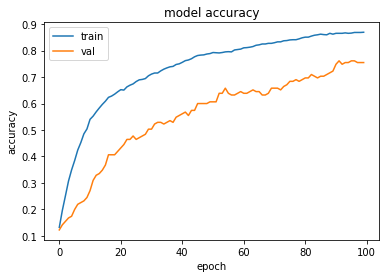

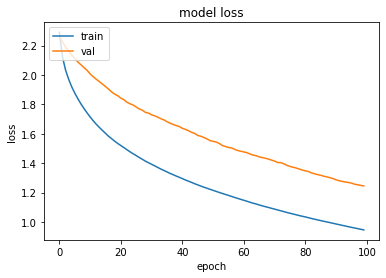

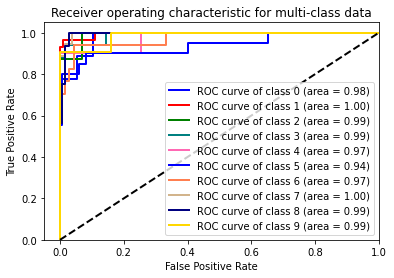

relu tanh


Singal=delta layer=relu optimizer=adagrad
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 15s - loss: 1.4794 - acc: 0.7484 - val_loss: 1.2941 - val_acc: 0.8452
Epoch 3/100
1240/1240 - 16s - loss: 1.1170 - acc: 0.9379 - val_loss: 1.0788 - val_acc: 0.9226
Epoch 4/100
1240/1240 - 15s - loss: 0.9108 - acc: 0.9823 - val_loss: 0.9094 - val_acc: 0.9613
Epoch 5/100
1240/1240 - 16s - loss: 0.7683 - acc: 0.9911 - val_loss: 0.8111 - val_acc: 0.9548
Epoch 6/100
1240/1240 - 15s - loss: 0.6659 - acc: 0.9952 - val_loss: 0.7142 - val_acc: 0.9677
Epoch 7/100
1240/1240 - 15s - loss: 0.5842 - acc: 1.0000 - val_loss: 0.6415 - val_acc: 0.9742
Epoch 8/100
1240/1240 - 15s - loss: 0.5254 - acc: 1.0000 - val_loss: 0.5878 - val_acc: 0.9742
Epoch 9/100
1240/1240 - 15s - loss: 0.4795 - acc: 1.0000 - val_loss: 0.5493 - val_acc: 0.9742
Epoch 10/100
1240/1240 - 15s - loss: 0.4414 - acc: 1.0000 - val_loss: 0.5260 - val_acc: 0.9742
Epoch 11/100
1240/1240 - 15s - loss: 0.4106 - acc: 1.0000 - val_loss: 0.4947 - val_acc: 0.9742
Epoch 12/100
1240/1240 - 15s - loss: 0.3834 - acc: 1.0000 

Epoch 89/100
1240/1240 - 15s - loss: 0.0634 - acc: 1.0000 - val_loss: 0.1310 - val_acc: 0.9871
Epoch 90/100
1240/1240 - 15s - loss: 0.0627 - acc: 1.0000 - val_loss: 0.1302 - val_acc: 0.9871
Epoch 91/100
1240/1240 - 15s - loss: 0.0619 - acc: 1.0000 - val_loss: 0.1295 - val_acc: 0.9871
Epoch 92/100
1240/1240 - 15s - loss: 0.0612 - acc: 1.0000 - val_loss: 0.1287 - val_acc: 0.9871
Epoch 93/100
1240/1240 - 15s - loss: 0.0605 - acc: 1.0000 - val_loss: 0.1278 - val_acc: 0.9871
Epoch 94/100
1240/1240 - 15s - loss: 0.0598 - acc: 1.0000 - val_loss: 0.1269 - val_acc: 0.9871
Epoch 95/100
1240/1240 - 15s - loss: 0.0591 - acc: 1.0000 - val_loss: 0.1262 - val_acc: 0.9871
Epoch 96/100
1240/1240 - 15s - loss: 0.0585 - acc: 1.0000 - val_loss: 0.1254 - val_acc: 0.9871
Epoch 97/100
1240/1240 - 15s - loss: 0.0578 - acc: 1.0000 - val_loss: 0.1247 - val_acc: 0.9871
Epoch 98/100
1240/1240 - 15s - loss: 0.0572 - acc: 1.0000 - val_loss: 0.1239 - val_acc: 0.9871
Epoch 99/100
1240/1240 - 15s - loss: 0.0566 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


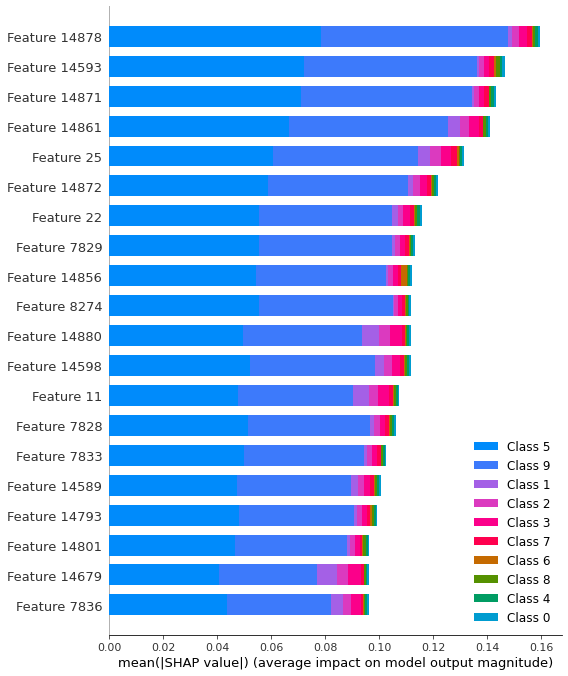

   class  sensitivity  specificity
0    1.0     0.848276     0.000000
1    2.0     0.893939     0.043478
2    3.0     0.865248     0.000000
3    4.0     0.875000     0.000000
4    5.0     0.898551     0.000000
5    6.0     0.914894     0.000000
6    7.0     0.916084     0.000000
7    8.0     0.895105     0.000000
8    9.0     0.864286     0.000000
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.897138
specificity    0.004348
dtype: float64


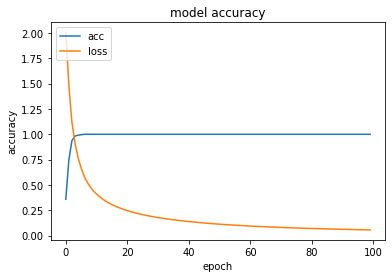

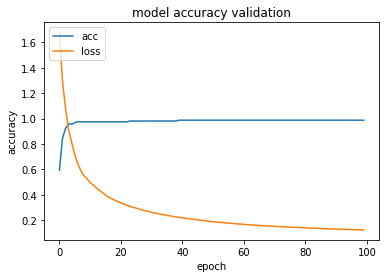

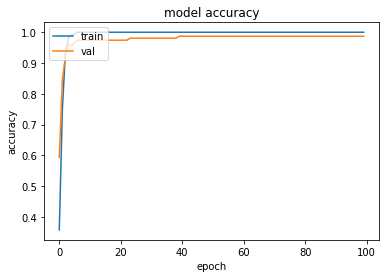

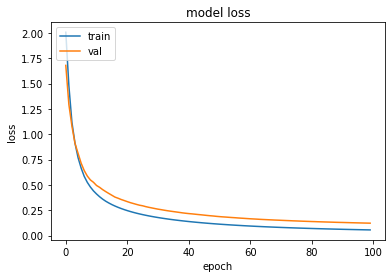

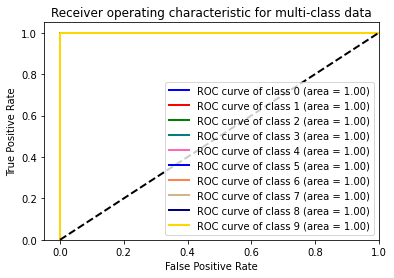

relu tanh


Singal=delta layer=relu optimizer=adamax
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 22s - loss: 1.6056 - acc: 0.4774 - val_loss: 1.4458 - val_acc: 0.4839
Epoch 3/100
1240/1240 - 22s - loss: 1.1620 - acc: 0.7024 - val_loss: 1.0311 - val_acc: 0.7097
Epoch 4/100
1240/1240 - 21s - loss: 0.8290 - acc: 0.8540 - val_loss: 0.6865 - val_acc: 0.9226
Epoch 5/100
1240/1240 - 22s - loss: 0.5077 - acc: 0.9500 - val_loss: 0.4571 - val_acc: 0.9548
Epoch 6/100
1240/1240 - 22s - loss: 0.3523 - acc: 0.9573 - val_loss: 0.3401 - val_acc: 0.9613
Epoch 7/100
1240/1240 - 22s - loss: 0.2439 - acc: 0.9766 - val_loss: 0.1830 - val_acc: 0.9935
Epoch 8/100
1240/1240 - 22s - loss: 0.1509 - acc: 0.9887 - val_loss: 0.1669 - val_acc: 0.9742
Epoch 9/100
1240/1240 - 21s - loss: 0.1019 - acc: 0.9944 - val_loss: 0.1560 - val_acc: 0.9742
Epoch 10/100
1240/1240 - 22s - loss: 0.0918 - acc: 0.9903 - val_loss: 0.1160 - val_acc: 0.9742
Epoch 11/100
1240/1240 - 22s - loss: 0.0679 - acc: 0.9927 - val_loss: 0.0573 - val_acc: 1.0000
Epoch 12/100
1240/1240 - 22s - loss: 0.0609 - acc: 0.9944 

1240/1240 - 20s - loss: 1.9640e-06 - acc: 1.0000 - val_loss: 5.1069e-04 - val_acc: 1.0000
Epoch 87/100
1240/1240 - 20s - loss: 1.7164e-06 - acc: 1.0000 - val_loss: 4.8409e-04 - val_acc: 1.0000
Epoch 88/100
1240/1240 - 19s - loss: 1.4989e-06 - acc: 1.0000 - val_loss: 3.7723e-04 - val_acc: 1.0000
Epoch 89/100
1240/1240 - 20s - loss: 1.3208e-06 - acc: 1.0000 - val_loss: 3.6726e-04 - val_acc: 1.0000
Epoch 90/100
1240/1240 - 19s - loss: 1.1525e-06 - acc: 1.0000 - val_loss: 3.7562e-04 - val_acc: 1.0000
Epoch 91/100
1240/1240 - 19s - loss: 1.0124e-06 - acc: 1.0000 - val_loss: 2.8270e-04 - val_acc: 1.0000
Epoch 92/100
1240/1240 - 20s - loss: 8.7898e-07 - acc: 1.0000 - val_loss: 3.5982e-04 - val_acc: 1.0000
Epoch 93/100
1240/1240 - 19s - loss: 7.7380e-07 - acc: 1.0000 - val_loss: 2.8793e-04 - val_acc: 1.0000
Epoch 94/100
1240/1240 - 19s - loss: 6.7449e-07 - acc: 1.0000 - val_loss: 3.1860e-04 - val_acc: 1.0000
Epoch 95/100
1240/1240 - 20s - loss: 5.9489e-07 - acc: 1.0000 - val_loss: 2.8714e-04 -

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


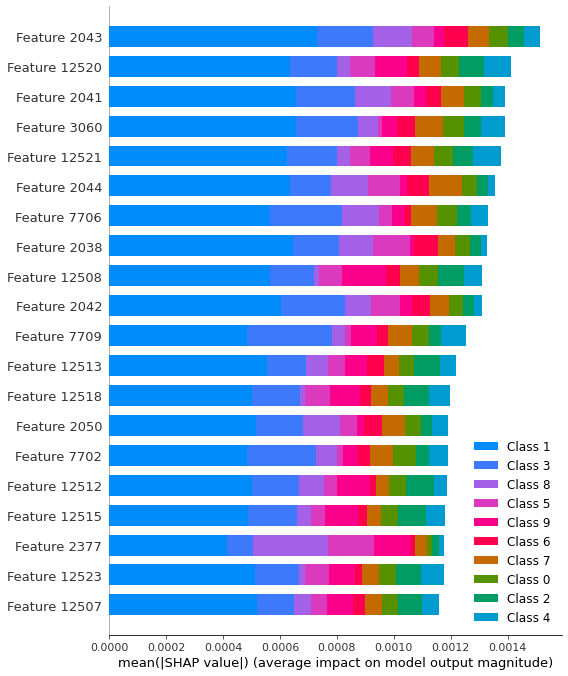

   class  sensitivity  specificity
0    1.0     0.879433          0.0
1    2.0     0.927536          0.0
2    3.0     0.848276          0.0
3    4.0     0.940299          0.0
4    5.0     0.884354          0.0
5    6.0     0.883212          0.0
6    7.0     0.899281          0.0
7    8.0     0.858156          0.0
8    9.0     0.874074          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.899462
specificity    0.000000
dtype: float64


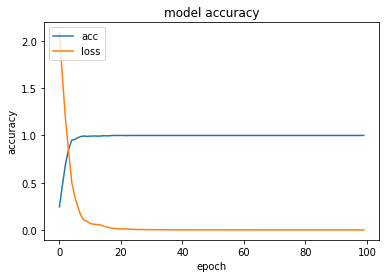

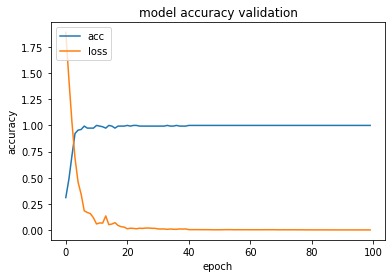

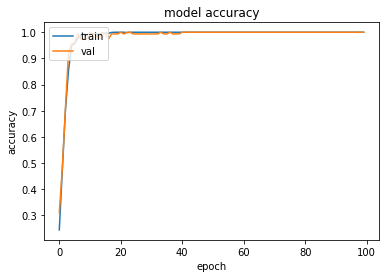

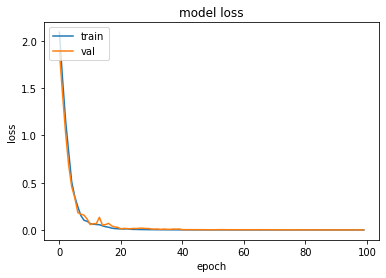

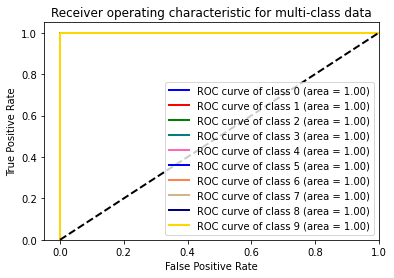

relu tanh


Singal=delta layer=relu optimizer=ftrl
delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


1240/1240 - 25s - loss: 2.3039 - acc: 0.0911 - val_loss: 2.3027 - val_acc: 0.0710
Epoch 2/100
1240/1240 - 25s - loss: 2.3026 - acc: 0.0976 - val_loss: 2.3028 - val_acc: 0.0710
Epoch 3/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3029 - val_acc: 0.0710
Epoch 4/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3030 - val_acc: 0.0710
Epoch 5/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3030 - val_acc: 0.0710
Epoch 6/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.0984 - val_loss: 2.3030 - val_acc: 0.0710
Epoch 7/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0710
Epoch 8/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0710
Epoch 9/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0710
Epoch 10/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0710
Epoch 11/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2

Epoch 88/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3044 - val_acc: 0.0710
Epoch 89/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3044 - val_acc: 0.0710
Epoch 90/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 91/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 92/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 93/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 94/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 95/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 96/100
1240/1240 - 25s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 97/100
1240/1240 - 25s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 98/100
1240/1240 - 25s - loss: 2.3021 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


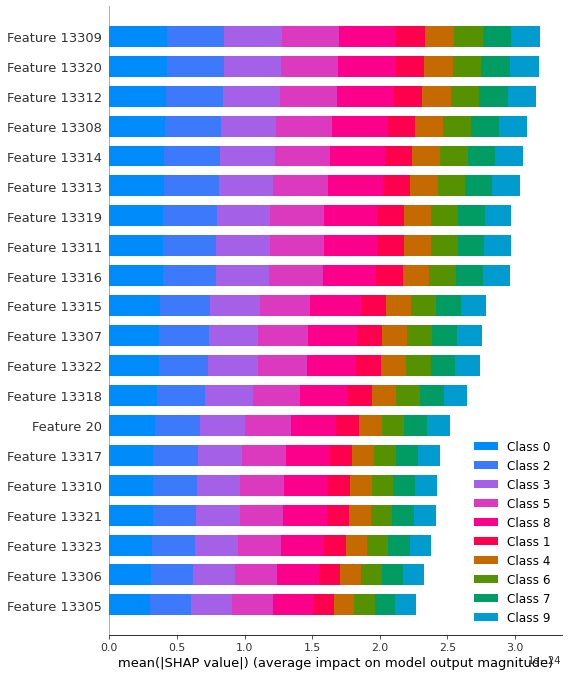

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


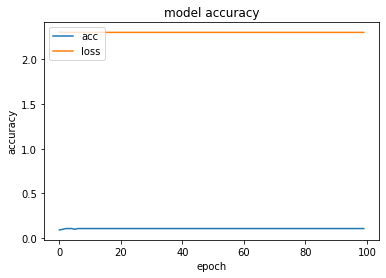

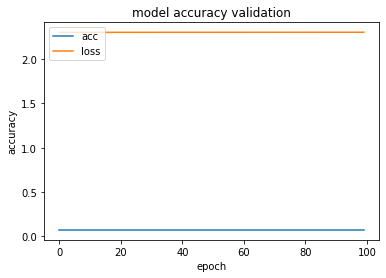

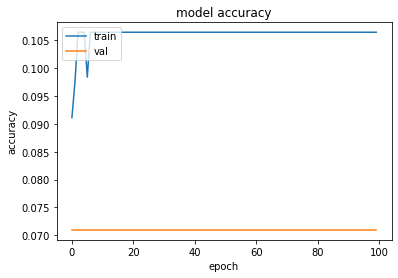

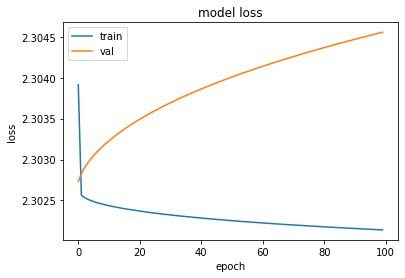

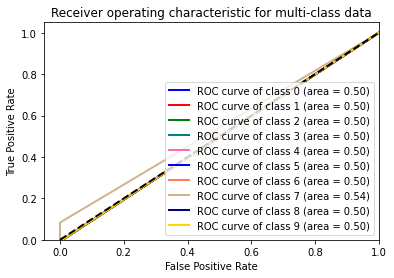

tanh tanh


Singal=theta layer=tanh optimizer=rmsprop
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 38s - loss: 0.4362 - acc: 0.9427 - val_loss: 0.3137 - val_acc: 0.9484
Epoch 3/100
1240/1240 - 38s - loss: 0.1562 - acc: 0.9839 - val_loss: 0.2876 - val_acc: 0.9548
Epoch 4/100
1240/1240 - 38s - loss: 0.0851 - acc: 0.9855 - val_loss: 0.1278 - val_acc: 0.9742
Epoch 5/100
1240/1240 - 38s - loss: 0.0351 - acc: 0.9968 - val_loss: 0.1046 - val_acc: 0.9806
Epoch 6/100
1240/1240 - 38s - loss: 0.0368 - acc: 0.9919 - val_loss: 0.0943 - val_acc: 0.9677
Epoch 7/100
1240/1240 - 39s - loss: 0.0081 - acc: 0.9992 - val_loss: 0.0317 - val_acc: 0.9935
Epoch 8/100
1240/1240 - 38s - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0331 - val_acc: 0.9935
Epoch 9/100
1240/1240 - 38s - loss: 6.0459e-04 - acc: 1.0000 - val_loss: 0.0358 - val_acc: 0.9935
Epoch 10/100
1240/1240 - 38s - loss: 1.9509e-04 - acc: 1.0000 - val_loss: 0.0388 - val_acc: 0.9935
Epoch 11/100
1240/1240 - 39s - loss: 6.2945e-05 - acc: 1.0000 - val_loss: 0.0424 - val_acc: 0.9935
Epoch 12/100
1240/1240 - 38s - loss: 2.1288e-0

1240/1240 - 38s - loss: 0.0000e+00 - acc: 1.0000 - val_loss: 0.0545 - val_acc: 0.9935
Epoch 86/100
1240/1240 - 38s - loss: 0.0000e+00 - acc: 1.0000 - val_loss: 0.0545 - val_acc: 0.9935
Epoch 87/100
1240/1240 - 38s - loss: 0.0000e+00 - acc: 1.0000 - val_loss: 0.0545 - val_acc: 0.9935
Epoch 88/100
1240/1240 - 38s - loss: 0.0000e+00 - acc: 1.0000 - val_loss: 0.0545 - val_acc: 0.9935
Epoch 89/100
1240/1240 - 38s - loss: 0.0000e+00 - acc: 1.0000 - val_loss: 0.0545 - val_acc: 0.9935
Epoch 90/100
1240/1240 - 38s - loss: 0.0000e+00 - acc: 1.0000 - val_loss: 0.0545 - val_acc: 0.9935
Epoch 91/100
1240/1240 - 38s - loss: 0.0000e+00 - acc: 1.0000 - val_loss: 0.0545 - val_acc: 0.9935



Total time =  3517 s for this model




              precision    recall  f1-score   support

           0       1.00      1.00      1.00        12
           1       0.96      0.96      0.96        26
           2       0.89      0.89      0.89         9
           3       1.00      1.00      1.00        21
      

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


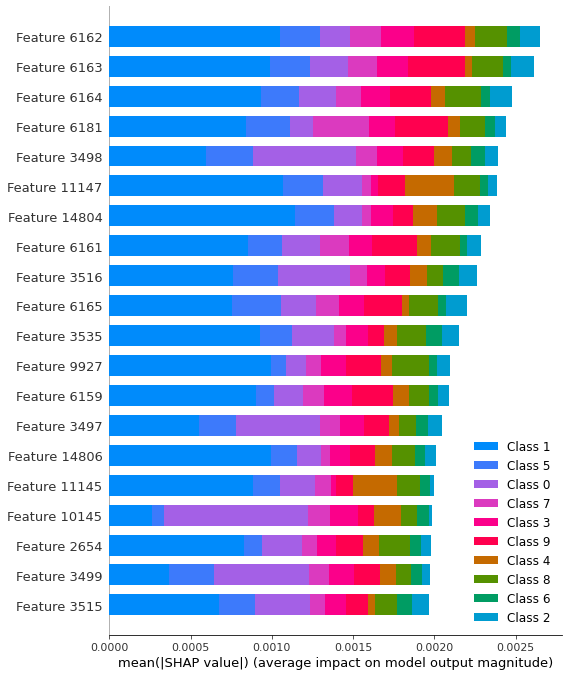

   class  sensitivity  specificity
0    1.0     0.818182          0.0
1    2.0     0.930233          0.0
2    3.0     0.856164          0.0
3    4.0     0.888060          0.0
4    5.0     0.892857          0.0
5    6.0     0.900709          0.0
6    7.0     0.886525          0.0
7    8.0     0.891304          0.0
8    9.0     0.914286          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.897832
specificity    0.000000
dtype: float64


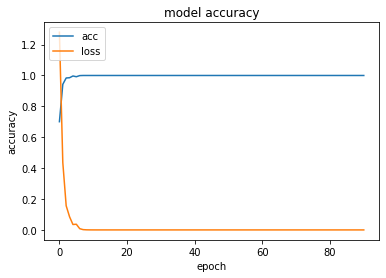

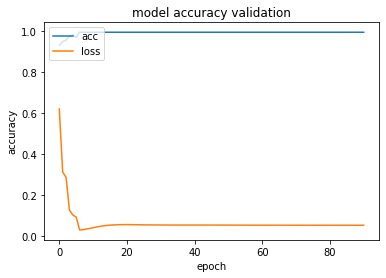

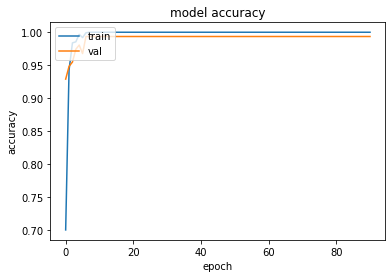

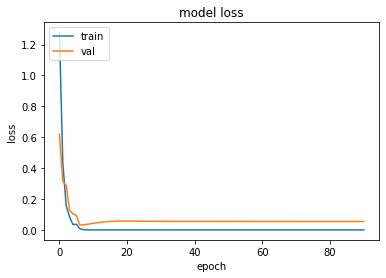

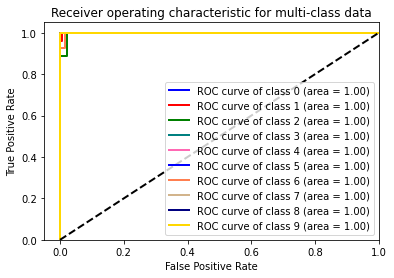

tanh tanh


Singal=theta layer=tanh optimizer=adam
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 17s - loss: 0.4849 - acc: 0.9524 - val_loss: 0.5959 - val_acc: 0.8774
Epoch 3/100
1240/1240 - 17s - loss: 0.2460 - acc: 0.9718 - val_loss: 0.3486 - val_acc: 0.9226
Epoch 4/100
1240/1240 - 17s - loss: 0.1969 - acc: 0.9710 - val_loss: 0.2535 - val_acc: 0.9548
Epoch 5/100
1240/1240 - 17s - loss: 0.1899 - acc: 0.9605 - val_loss: 0.2365 - val_acc: 0.9419
Epoch 6/100
1240/1240 - 17s - loss: 0.1242 - acc: 0.9798 - val_loss: 0.2450 - val_acc: 0.9290
Epoch 7/100
1240/1240 - 17s - loss: 0.0760 - acc: 0.9879 - val_loss: 0.1669 - val_acc: 0.9613
Epoch 8/100
1240/1240 - 17s - loss: 0.0549 - acc: 0.9952 - val_loss: 0.1344 - val_acc: 0.9742
Epoch 9/100
1240/1240 - 17s - loss: 0.0298 - acc: 0.9992 - val_loss: 0.1120 - val_acc: 0.9742
Epoch 10/100
1240/1240 - 17s - loss: 0.0216 - acc: 1.0000 - val_loss: 0.1066 - val_acc: 0.9742
Epoch 11/100
1240/1240 - 17s - loss: 0.0182 - acc: 1.0000 - val_loss: 0.1024 - val_acc: 0.9806
Epoch 12/100
1240/1240 - 17s - loss: 0.0156 - acc: 1.0000 

Epoch 87/100
1240/1240 - 17s - loss: 5.0530e-05 - acc: 1.0000 - val_loss: 0.1035 - val_acc: 0.9806
Epoch 88/100
1240/1240 - 17s - loss: 4.7468e-05 - acc: 1.0000 - val_loss: 0.1040 - val_acc: 0.9806
Epoch 89/100
1240/1240 - 17s - loss: 4.4594e-05 - acc: 1.0000 - val_loss: 0.1044 - val_acc: 0.9806
Epoch 90/100
1240/1240 - 17s - loss: 4.1903e-05 - acc: 1.0000 - val_loss: 0.1048 - val_acc: 0.9806
Epoch 91/100
1240/1240 - 17s - loss: 3.9362e-05 - acc: 1.0000 - val_loss: 0.1053 - val_acc: 0.9806
Epoch 92/100
1240/1240 - 17s - loss: 3.6985e-05 - acc: 1.0000 - val_loss: 0.1057 - val_acc: 0.9806
Epoch 93/100
1240/1240 - 17s - loss: 3.4749e-05 - acc: 1.0000 - val_loss: 0.1062 - val_acc: 0.9806
Epoch 94/100
1240/1240 - 17s - loss: 3.2649e-05 - acc: 1.0000 - val_loss: 0.1066 - val_acc: 0.9806
Epoch 95/100
1240/1240 - 17s - loss: 3.0680e-05 - acc: 1.0000 - val_loss: 0.1071 - val_acc: 0.9806
Epoch 96/100
1240/1240 - 17s - loss: 2.8825e-05 - acc: 1.0000 - val_loss: 0.1075 - val_acc: 0.9806
Epoch 97/1

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


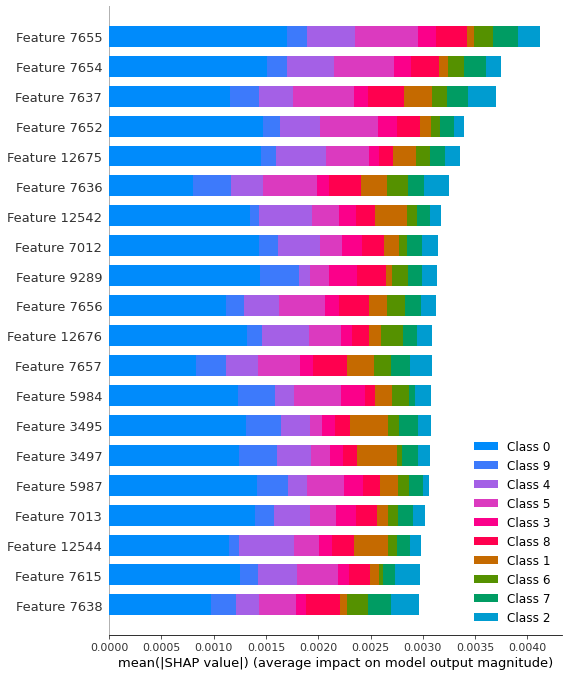

   class  sensitivity  specificity
0    1.0     0.901408     0.000000
1    2.0     0.928571     0.000000
2    3.0     0.849315     0.000000
3    4.0     0.925926     0.000000
4    5.0     0.856164     0.000000
5    6.0     0.888060     0.000000
6    7.0     0.892086     0.000000
7    8.0     0.863309     0.000000
8    9.0     0.888060     0.047619
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.899290
specificity    0.004762
dtype: float64


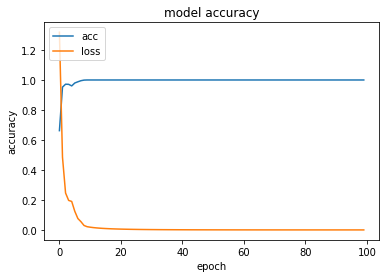

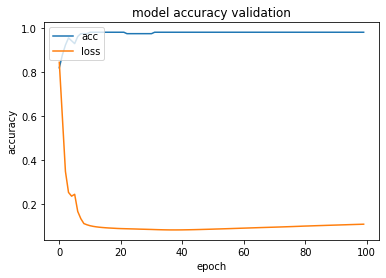

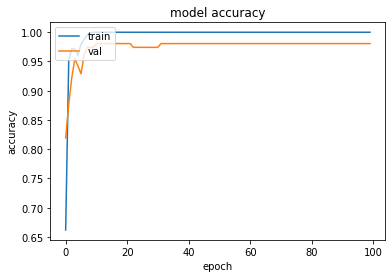

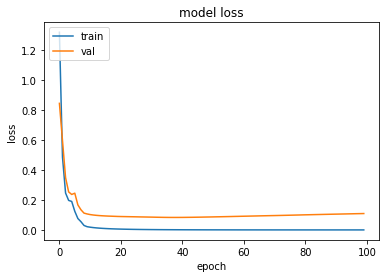

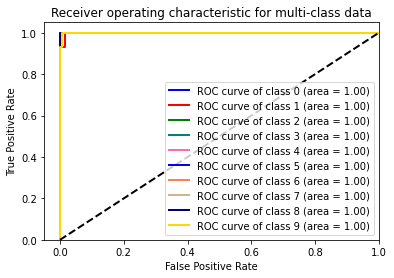

tanh tanh


Singal=theta layer=tanh optimizer=nadam
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 65s - loss: 0.4239 - acc: 0.9565 - val_loss: 0.4805 - val_acc: 0.8968
Epoch 3/100
1240/1240 - 65s - loss: 0.2093 - acc: 0.9798 - val_loss: 0.3628 - val_acc: 0.9226
Epoch 4/100
1240/1240 - 65s - loss: 0.1268 - acc: 0.9887 - val_loss: 0.2443 - val_acc: 0.9613
Epoch 5/100
1240/1240 - 65s - loss: 0.1223 - acc: 0.9798 - val_loss: 0.3080 - val_acc: 0.9161
Epoch 6/100
1240/1240 - 65s - loss: 0.0779 - acc: 0.9911 - val_loss: 0.3565 - val_acc: 0.9032
Epoch 7/100
1240/1240 - 65s - loss: 0.0573 - acc: 0.9960 - val_loss: 0.2494 - val_acc: 0.9484
Epoch 8/100
1240/1240 - 65s - loss: 0.0381 - acc: 0.9968 - val_loss: 0.1622 - val_acc: 0.9548
Epoch 9/100
1240/1240 - 65s - loss: 0.0347 - acc: 0.9968 - val_loss: 0.2110 - val_acc: 0.9613
Epoch 10/100
1240/1240 - 65s - loss: 0.0199 - acc: 0.9992 - val_loss: 0.1690 - val_acc: 0.9613
Epoch 11/100
1240/1240 - 65s - loss: 0.0136 - acc: 1.0000 - val_loss: 0.1669 - val_acc: 0.9613
Epoch 12/100
1240/1240 - 65s - loss: 0.0117 - acc: 1.0000 

Epoch 87/100
1240/1240 - 65s - loss: 4.3403e-05 - acc: 1.0000 - val_loss: 0.2359 - val_acc: 0.9677
Epoch 88/100
1240/1240 - 65s - loss: 4.0783e-05 - acc: 1.0000 - val_loss: 0.2372 - val_acc: 0.9677
Epoch 89/100
1240/1240 - 65s - loss: 3.8321e-05 - acc: 1.0000 - val_loss: 0.2385 - val_acc: 0.9677
Epoch 90/100
1240/1240 - 65s - loss: 3.6012e-05 - acc: 1.0000 - val_loss: 0.2397 - val_acc: 0.9677
Epoch 91/100
1240/1240 - 65s - loss: 3.3825e-05 - acc: 1.0000 - val_loss: 0.2410 - val_acc: 0.9677
Epoch 92/100
1240/1240 - 65s - loss: 3.1785e-05 - acc: 1.0000 - val_loss: 0.2423 - val_acc: 0.9677
Epoch 93/100
1240/1240 - 65s - loss: 2.9870e-05 - acc: 1.0000 - val_loss: 0.2436 - val_acc: 0.9677
Epoch 94/100
1240/1240 - 65s - loss: 2.8082e-05 - acc: 1.0000 - val_loss: 0.2449 - val_acc: 0.9677
Epoch 95/100
1240/1240 - 64s - loss: 2.6399e-05 - acc: 1.0000 - val_loss: 0.2461 - val_acc: 0.9677
Epoch 96/100
1240/1240 - 65s - loss: 2.4793e-05 - acc: 1.0000 - val_loss: 0.2474 - val_acc: 0.9677
Epoch 97/1

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


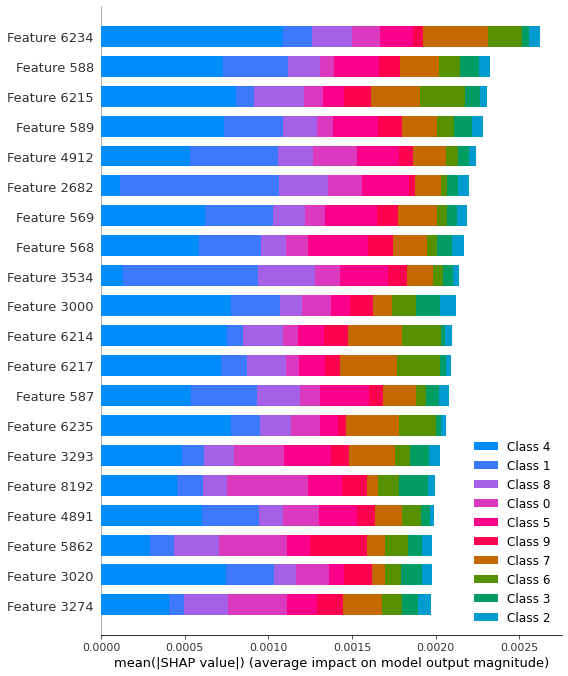

   class  sensitivity  specificity
0    1.0     0.855072          0.0
1    2.0     0.925373          0.0
2    3.0     0.882759          0.0
3    4.0     0.897810          0.0
4    5.0     0.845070          0.0
5    6.0     0.902985          0.0
6    7.0     0.901408          0.0
7    8.0     0.886525          0.0
8    9.0     0.913669          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.901067
specificity    0.000000
dtype: float64


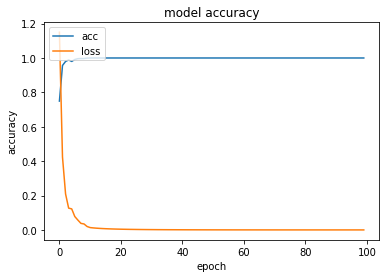

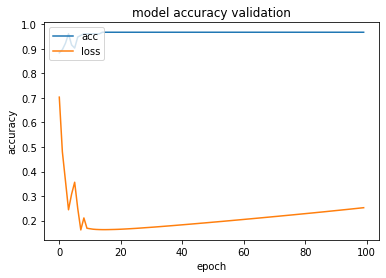

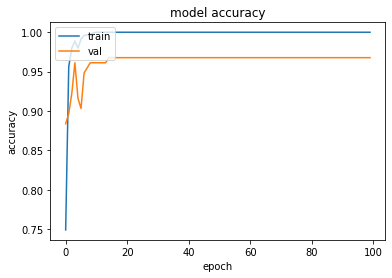

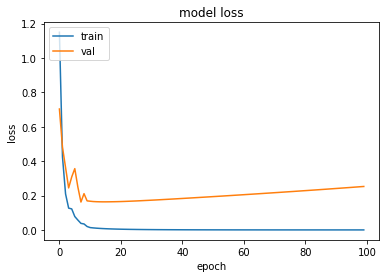

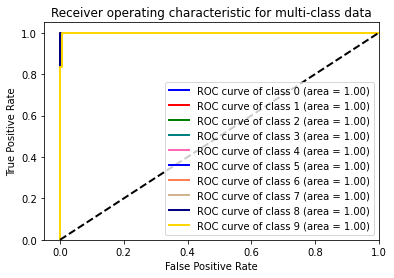

tanh tanh


Singal=theta layer=tanh optimizer=sgd
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________


`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 11s - loss: 0.5804 - acc: 0.9976 - val_loss: 0.5667 - val_acc: 0.9871
Epoch 3/100
1240/1240 - 11s - loss: 0.3686 - acc: 1.0000 - val_loss: 0.4260 - val_acc: 0.9871
Epoch 4/100
1240/1240 - 10s - loss: 0.2631 - acc: 1.0000 - val_loss: 0.3413 - val_acc: 0.9871
Epoch 5/100
1240/1240 - 11s - loss: 0.2008 - acc: 1.0000 - val_loss: 0.2848 - val_acc: 0.9935
Epoch 6/100
1240/1240 - 11s - loss: 0.1604 - acc: 1.0000 - val_loss: 0.2454 - val_acc: 0.9935
Epoch 7/100
1240/1240 - 11s - loss: 0.1325 - acc: 1.0000 - val_loss: 0.2165 - val_acc: 0.9935
Epoch 8/100
1240/1240 - 10s - loss: 0.1123 - acc: 1.0000 - val_loss: 0.1946 - val_acc: 0.9935
Epoch 9/100
1240/1240 - 10s - loss: 0.0971 - acc: 1.0000 - val_loss: 0.1774 - val_acc: 0.9935
Epoch 10/100
1240/1240 - 10s - loss: 0.0854 - acc: 1.0000 - val_loss: 0.1636 - val_acc: 0.9935
Epoch 11/100
1240/1240 - 11s - loss: 0.0760 - acc: 1.0000 - val_loss: 0.1524 - val_acc: 0.9935
Epoch 12/100
1240/1240 - 11s - loss: 0.0684 - acc: 1.0000 

Epoch 89/100
1240/1240 - 11s - loss: 0.0072 - acc: 1.0000 - val_loss: 0.0536 - val_acc: 0.9935
Epoch 90/100
1240/1240 - 10s - loss: 0.0071 - acc: 1.0000 - val_loss: 0.0534 - val_acc: 0.9935
Epoch 91/100
1240/1240 - 11s - loss: 0.0070 - acc: 1.0000 - val_loss: 0.0532 - val_acc: 0.9935
Epoch 92/100
1240/1240 - 11s - loss: 0.0069 - acc: 1.0000 - val_loss: 0.0531 - val_acc: 0.9935
Epoch 93/100
1240/1240 - 10s - loss: 0.0068 - acc: 1.0000 - val_loss: 0.0529 - val_acc: 0.9935
Epoch 94/100
1240/1240 - 11s - loss: 0.0068 - acc: 1.0000 - val_loss: 0.0528 - val_acc: 0.9935
Epoch 95/100
1240/1240 - 10s - loss: 0.0067 - acc: 1.0000 - val_loss: 0.0526 - val_acc: 0.9935
Epoch 96/100
1240/1240 - 11s - loss: 0.0066 - acc: 1.0000 - val_loss: 0.0524 - val_acc: 0.9935
Epoch 97/100
1240/1240 - 10s - loss: 0.0065 - acc: 1.0000 - val_loss: 0.0523 - val_acc: 0.9935
Epoch 98/100
1240/1240 - 11s - loss: 0.0065 - acc: 1.0000 - val_loss: 0.0521 - val_acc: 0.9935
Epoch 99/100
1240/1240 - 11s - loss: 0.0064 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


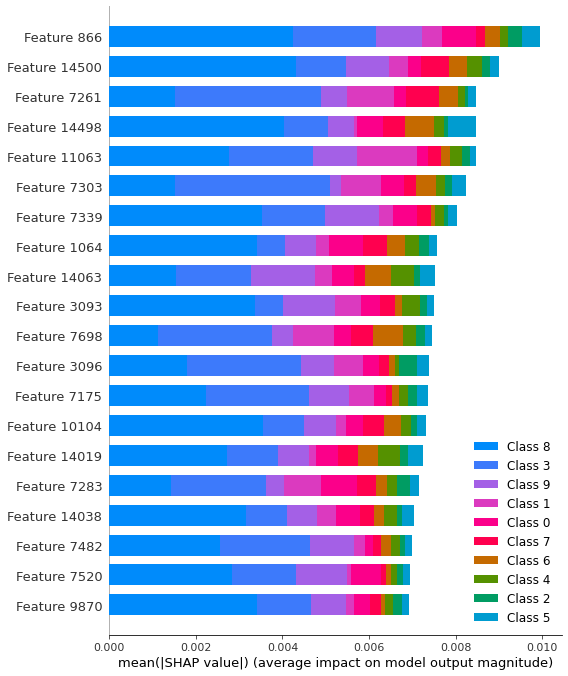

   class  sensitivity  specificity
0    1.0     0.816176          0.0
1    2.0     0.923077          0.0
2    3.0     0.896552          0.0
3    4.0     0.900000          0.0
4    5.0     0.936170          0.0
5    6.0     0.897260          0.0
6    7.0     0.900000          0.0
7    8.0     0.879433          0.0
8    9.0     0.876812          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.902548
specificity    0.000000
dtype: float64


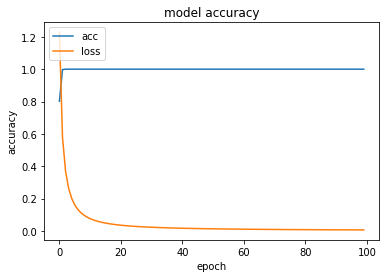

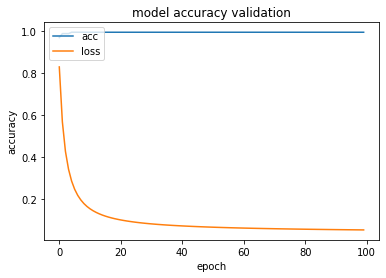

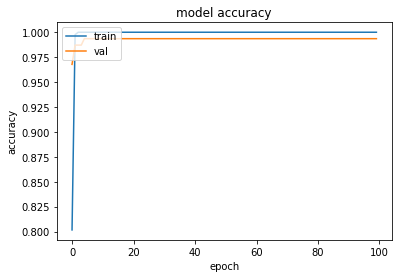

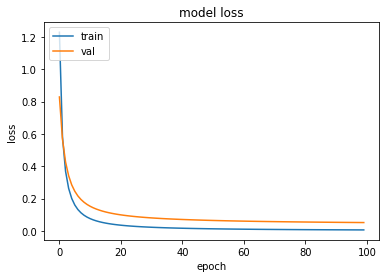

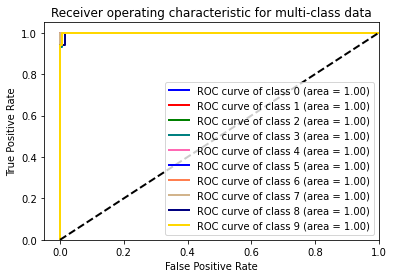

tanh tanh


Singal=theta layer=tanh optimizer=adadelta
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_____________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 23s - loss: 2.0136 - acc: 0.3323 - val_loss: 2.1056 - val_acc: 0.2645
Epoch 3/100
1240/1240 - 23s - loss: 1.8039 - acc: 0.5202 - val_loss: 2.0115 - val_acc: 0.3226
Epoch 4/100
1240/1240 - 23s - loss: 1.6414 - acc: 0.6718 - val_loss: 1.9277 - val_acc: 0.3806
Epoch 5/100
1240/1240 - 23s - loss: 1.5107 - acc: 0.7718 - val_loss: 1.8517 - val_acc: 0.4452
Epoch 6/100
1240/1240 - 23s - loss: 1.4033 - acc: 0.8444 - val_loss: 1.7836 - val_acc: 0.4968
Epoch 7/100
1240/1240 - 24s - loss: 1.3148 - acc: 0.9016 - val_loss: 1.7222 - val_acc: 0.5613
Epoch 8/100
1240/1240 - 23s - loss: 1.2404 - acc: 0.9323 - val_loss: 1.6666 - val_acc: 0.6129
Epoch 9/100
1240/1240 - 24s - loss: 1.1774 - acc: 0.9573 - val_loss: 1.6155 - val_acc: 0.6516
Epoch 10/100
1240/1240 - 24s - loss: 1.1239 - acc: 0.9742 - val_loss: 1.5688 - val_acc: 0.6968
Epoch 11/100
1240/1240 - 24s - loss: 1.0777 - acc: 0.9839 - val_loss: 1.5260 - val_acc: 0.7355
Epoch 12/100
1240/1240 - 24s - loss: 1.0377 - acc: 0.9887 

Epoch 89/100
1240/1240 - 23s - loss: 0.5450 - acc: 1.0000 - val_loss: 0.7917 - val_acc: 0.9677
Epoch 90/100
1240/1240 - 24s - loss: 0.5431 - acc: 1.0000 - val_loss: 0.7888 - val_acc: 0.9677
Epoch 91/100
1240/1240 - 23s - loss: 0.5413 - acc: 1.0000 - val_loss: 0.7860 - val_acc: 0.9677
Epoch 92/100
1240/1240 - 23s - loss: 0.5395 - acc: 1.0000 - val_loss: 0.7832 - val_acc: 0.9677
Epoch 93/100
1240/1240 - 23s - loss: 0.5377 - acc: 1.0000 - val_loss: 0.7804 - val_acc: 0.9677
Epoch 94/100
1240/1240 - 23s - loss: 0.5359 - acc: 1.0000 - val_loss: 0.7777 - val_acc: 0.9677
Epoch 95/100
1240/1240 - 23s - loss: 0.5341 - acc: 1.0000 - val_loss: 0.7750 - val_acc: 0.9677
Epoch 96/100
1240/1240 - 23s - loss: 0.5324 - acc: 1.0000 - val_loss: 0.7723 - val_acc: 0.9677
Epoch 97/100
1240/1240 - 23s - loss: 0.5307 - acc: 1.0000 - val_loss: 0.7696 - val_acc: 0.9677
Epoch 98/100
1240/1240 - 23s - loss: 0.5290 - acc: 1.0000 - val_loss: 0.7669 - val_acc: 0.9677
Epoch 99/100
1240/1240 - 23s - loss: 0.5273 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


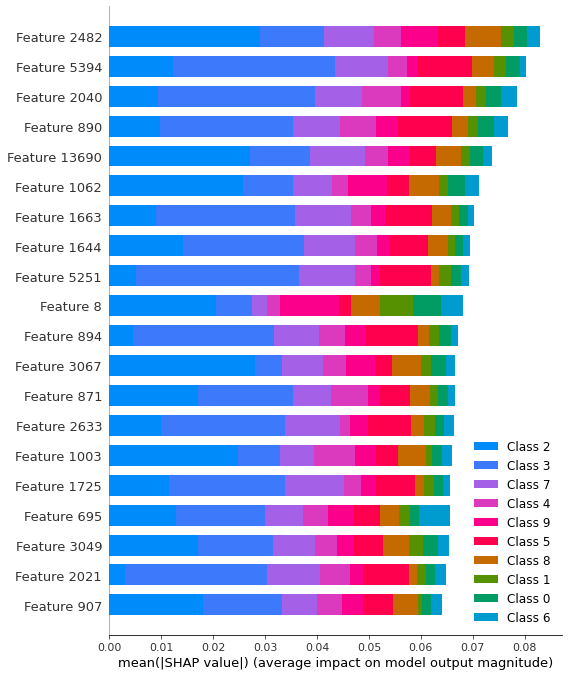

   class  sensitivity  specificity
0    1.0     0.879433     0.000000
1    2.0     0.925373     0.047619
2    3.0     0.883562     0.000000
3    4.0     0.906475     0.000000
4    5.0     0.845070     0.000000
5    6.0     0.897810     0.000000
6    7.0     0.892857     0.000000
7    8.0     0.899281     0.000000
8    9.0     0.871429     0.000000
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.900129
specificity    0.004762
dtype: float64


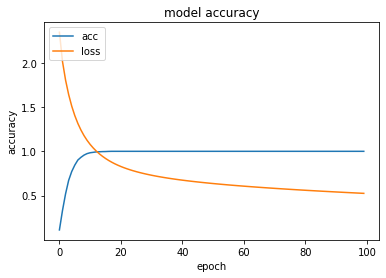

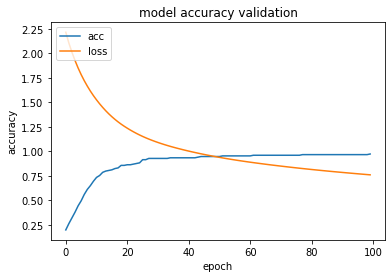

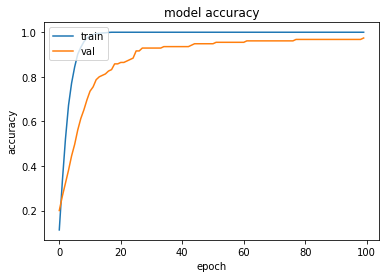

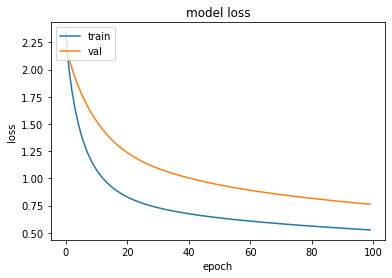

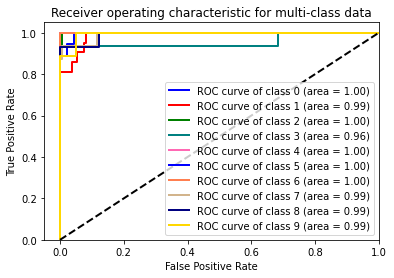

tanh tanh


Singal=theta layer=tanh optimizer=adagrad
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 14s - loss: 0.8122 - acc: 0.9927 - val_loss: 0.9377 - val_acc: 0.9355
Epoch 3/100
1240/1240 - 14s - loss: 0.6680 - acc: 1.0000 - val_loss: 0.8591 - val_acc: 0.9548
Epoch 4/100
1240/1240 - 14s - loss: 0.5992 - acc: 1.0000 - val_loss: 0.8081 - val_acc: 0.9548
Epoch 5/100
1240/1240 - 14s - loss: 0.5538 - acc: 1.0000 - val_loss: 0.7666 - val_acc: 0.9548
Epoch 6/100
1240/1240 - 14s - loss: 0.5195 - acc: 1.0000 - val_loss: 0.7327 - val_acc: 0.9548
Epoch 7/100
1240/1240 - 14s - loss: 0.4916 - acc: 1.0000 - val_loss: 0.7038 - val_acc: 0.9613
Epoch 8/100
1240/1240 - 14s - loss: 0.4682 - acc: 1.0000 - val_loss: 0.6787 - val_acc: 0.9677
Epoch 9/100
1240/1240 - 14s - loss: 0.4480 - acc: 1.0000 - val_loss: 0.6567 - val_acc: 0.9677
Epoch 10/100
1240/1240 - 14s - loss: 0.4303 - acc: 1.0000 - val_loss: 0.6370 - val_acc: 0.9677
Epoch 11/100
1240/1240 - 14s - loss: 0.4145 - acc: 1.0000 - val_loss: 0.6191 - val_acc: 0.9677
Epoch 12/100
1240/1240 - 14s - loss: 0.4002 - acc: 1.0000 

Epoch 89/100
1240/1240 - 15s - loss: 0.1351 - acc: 1.0000 - val_loss: 0.2863 - val_acc: 0.9742
Epoch 90/100
1240/1240 - 15s - loss: 0.1340 - acc: 1.0000 - val_loss: 0.2851 - val_acc: 0.9742
Epoch 91/100
1240/1240 - 15s - loss: 0.1330 - acc: 1.0000 - val_loss: 0.2838 - val_acc: 0.9742
Epoch 92/100
1240/1240 - 15s - loss: 0.1320 - acc: 1.0000 - val_loss: 0.2826 - val_acc: 0.9742
Epoch 93/100
1240/1240 - 15s - loss: 0.1310 - acc: 1.0000 - val_loss: 0.2814 - val_acc: 0.9742
Epoch 94/100
1240/1240 - 15s - loss: 0.1300 - acc: 1.0000 - val_loss: 0.2803 - val_acc: 0.9742
Epoch 95/100
1240/1240 - 15s - loss: 0.1290 - acc: 1.0000 - val_loss: 0.2791 - val_acc: 0.9742
Epoch 96/100
1240/1240 - 15s - loss: 0.1280 - acc: 1.0000 - val_loss: 0.2780 - val_acc: 0.9742
Epoch 97/100
1240/1240 - 15s - loss: 0.1271 - acc: 1.0000 - val_loss: 0.2769 - val_acc: 0.9742
Epoch 98/100
1240/1240 - 15s - loss: 0.1262 - acc: 1.0000 - val_loss: 0.2758 - val_acc: 0.9742
Epoch 99/100
1240/1240 - 15s - loss: 0.1252 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


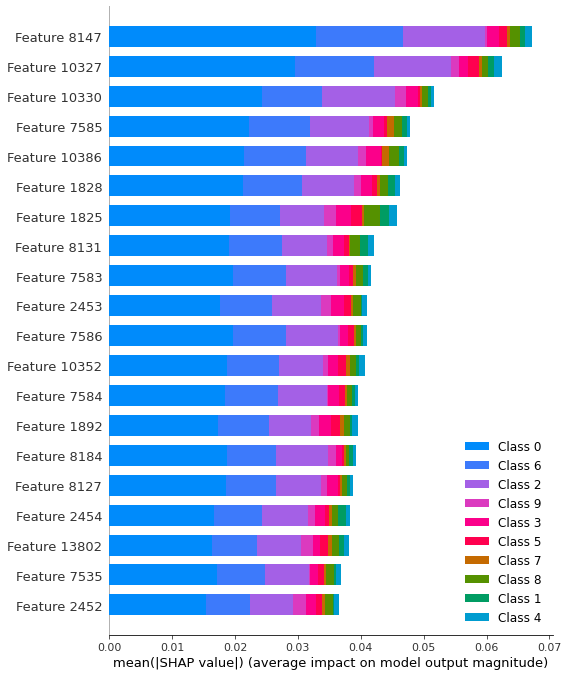

   class  sensitivity  specificity
0    1.0     0.866197     0.000000
1    2.0     0.908397     0.000000
2    3.0     0.908451     0.076923
3    4.0     0.908451     0.000000
4    5.0     0.845070     0.000000
5    6.0     0.881481     0.000000
6    7.0     0.884892     0.000000
7    8.0     0.863309     0.000000
8    9.0     0.927536     0.000000
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.899379
specificity    0.007692
dtype: float64


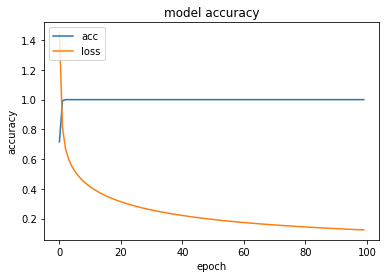

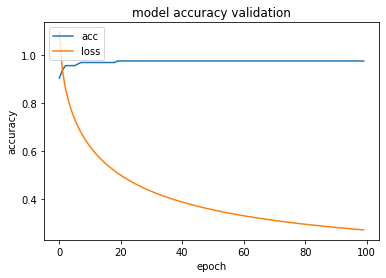

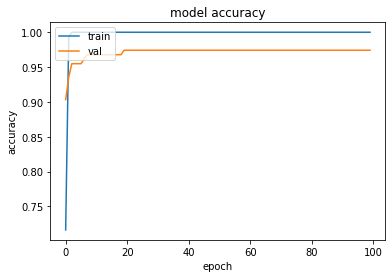

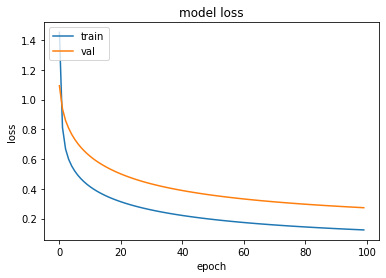

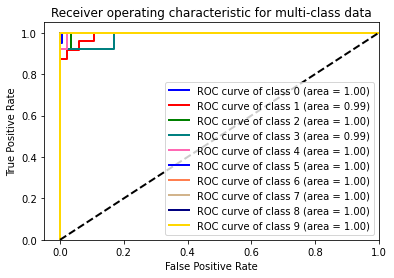

tanh tanh


Singal=theta layer=tanh optimizer=adamax
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 19s - loss: 0.5039 - acc: 0.9911 - val_loss: 0.4594 - val_acc: 0.9806
Epoch 3/100
1240/1240 - 19s - loss: 0.3298 - acc: 0.9992 - val_loss: 0.3556 - val_acc: 0.9806
Epoch 4/100
1240/1240 - 19s - loss: 0.2425 - acc: 1.0000 - val_loss: 0.2853 - val_acc: 0.9806
Epoch 5/100
1240/1240 - 19s - loss: 0.1861 - acc: 1.0000 - val_loss: 0.2364 - val_acc: 0.9806
Epoch 6/100
1240/1240 - 19s - loss: 0.1461 - acc: 1.0000 - val_loss: 0.1996 - val_acc: 0.9806
Epoch 7/100
1240/1240 - 19s - loss: 0.1165 - acc: 1.0000 - val_loss: 0.1722 - val_acc: 0.9806
Epoch 8/100
1240/1240 - 19s - loss: 0.0940 - acc: 1.0000 - val_loss: 0.1505 - val_acc: 0.9806
Epoch 9/100
1240/1240 - 19s - loss: 0.0767 - acc: 1.0000 - val_loss: 0.1341 - val_acc: 0.9806
Epoch 10/100
1240/1240 - 19s - loss: 0.0632 - acc: 1.0000 - val_loss: 0.1208 - val_acc: 0.9806
Epoch 11/100
1240/1240 - 19s - loss: 0.0525 - acc: 1.0000 - val_loss: 0.1100 - val_acc: 0.9806
Epoch 12/100
1240/1240 - 19s - loss: 0.0440 - acc: 1.0000 

Epoch 87/100
1240/1240 - 19s - loss: 2.7041e-06 - acc: 1.0000 - val_loss: 0.0606 - val_acc: 0.9806
Epoch 88/100
1240/1240 - 19s - loss: 2.4089e-06 - acc: 1.0000 - val_loss: 0.0608 - val_acc: 0.9806
Epoch 89/100
1240/1240 - 19s - loss: 2.1112e-06 - acc: 1.0000 - val_loss: 0.0609 - val_acc: 0.9806
Epoch 90/100
1240/1240 - 19s - loss: 1.8922e-06 - acc: 1.0000 - val_loss: 0.0613 - val_acc: 0.9806
Epoch 91/100
1240/1240 - 19s - loss: 1.6557e-06 - acc: 1.0000 - val_loss: 0.0611 - val_acc: 0.9806
Epoch 92/100
1240/1240 - 19s - loss: 1.4514e-06 - acc: 1.0000 - val_loss: 0.0612 - val_acc: 0.9806
Epoch 93/100
1240/1240 - 19s - loss: 1.2914e-06 - acc: 1.0000 - val_loss: 0.0618 - val_acc: 0.9806
Epoch 94/100
1240/1240 - 19s - loss: 1.1501e-06 - acc: 1.0000 - val_loss: 0.0612 - val_acc: 0.9806
Epoch 95/100
1240/1240 - 19s - loss: 1.0414e-06 - acc: 1.0000 - val_loss: 0.0618 - val_acc: 0.9806
Epoch 96/100
1240/1240 - 19s - loss: 9.1464e-07 - acc: 1.0000 - val_loss: 0.0623 - val_acc: 0.9806
Epoch 97/1

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


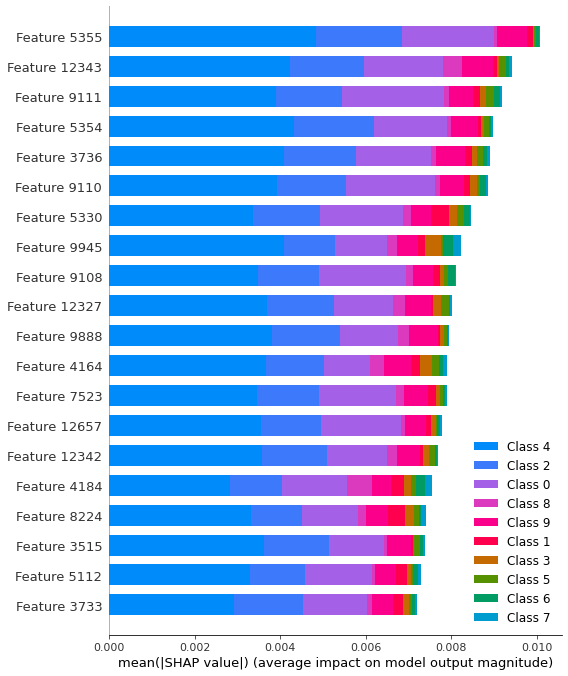

   class  sensitivity  specificity
0    1.0     0.843537          0.0
1    2.0     0.945736          0.0
2    3.0     0.832215          0.0
3    4.0     0.893939          0.0
4    5.0     0.858156          0.0
5    6.0     0.903704          0.0
6    7.0     0.923077          0.0
7    8.0     0.854167          0.0
8    9.0     0.902985          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.895752
specificity    0.000000
dtype: float64


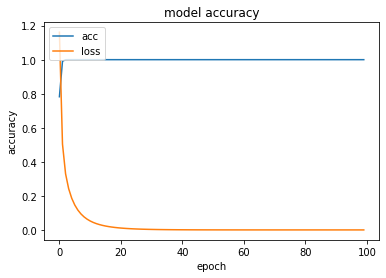

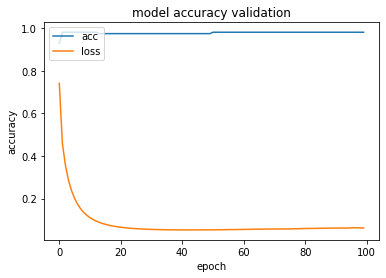

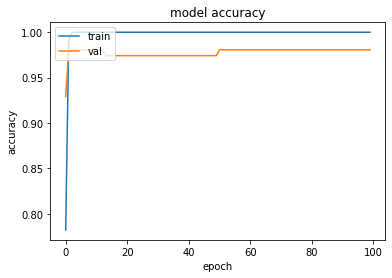

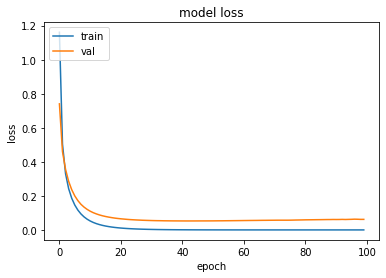

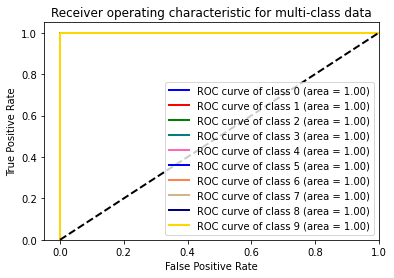

tanh tanh


Singal=theta layer=tanh optimizer=ftrl
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 25s - loss: 2.3026 - acc: 0.1032 - val_loss: 2.3028 - val_acc: 0.0645
Epoch 3/100
1240/1240 - 25s - loss: 2.3026 - acc: 0.1032 - val_loss: 2.3028 - val_acc: 0.0645
Epoch 4/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3029 - val_acc: 0.0645
Epoch 5/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3029 - val_acc: 0.0645
Epoch 6/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3030 - val_acc: 0.0645
Epoch 7/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3030 - val_acc: 0.0645
Epoch 8/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3030 - val_acc: 0.0645
Epoch 9/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0645
Epoch 10/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0645
Epoch 11/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0645
Epoch 12/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 

Epoch 89/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3041 - val_acc: 0.0645
Epoch 90/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3041 - val_acc: 0.0645
Epoch 91/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3041 - val_acc: 0.0645
Epoch 92/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3041 - val_acc: 0.0645
Epoch 93/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3041 - val_acc: 0.0645
Epoch 94/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3041 - val_acc: 0.0645
Epoch 95/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3041 - val_acc: 0.0645
Epoch 96/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3041 - val_acc: 0.0645
Epoch 97/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3041 - val_acc: 0.0645
Epoch 98/100
1240/1240 - 25s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3041 - val_acc: 0.0645
Epoch 99/100
1240/1240 - 25s - loss: 2.3022 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


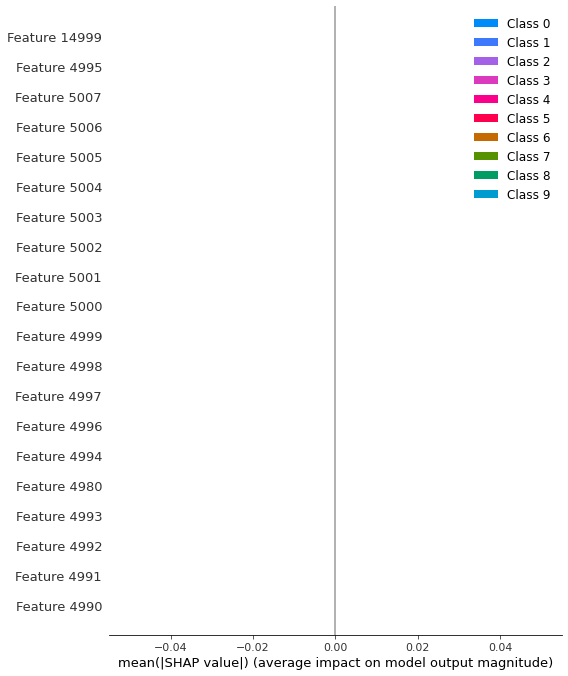

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


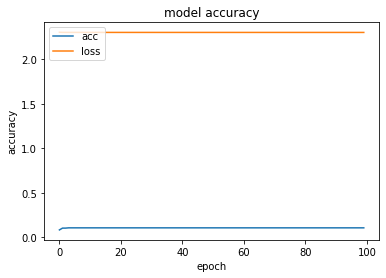

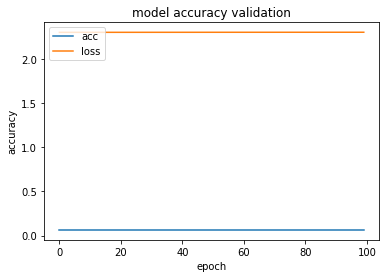

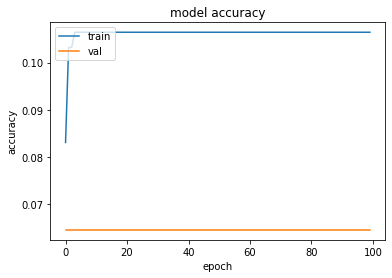

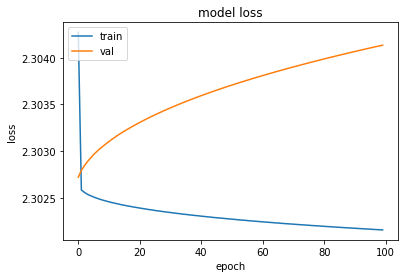

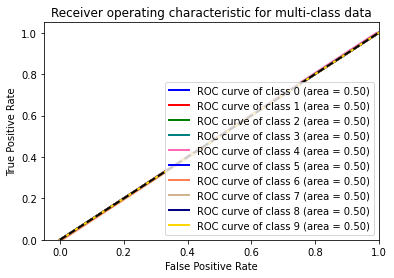

relu relu


Singal=theta layer=relu optimizer=rmsprop
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 38s - loss: 2.3026 - acc: 0.1032 - val_loss: 2.3054 - val_acc: 0.0903
Epoch 3/100
1240/1240 - 38s - loss: 2.3025 - acc: 0.0960 - val_loss: 2.3068 - val_acc: 0.0903
Epoch 4/100
1240/1240 - 38s - loss: 2.3023 - acc: 0.1024 - val_loss: 2.3082 - val_acc: 0.0903
Epoch 5/100
1240/1240 - 38s - loss: 2.3021 - acc: 0.0992 - val_loss: 2.3094 - val_acc: 0.0903
Epoch 6/100
1240/1240 - 38s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3105 - val_acc: 0.0903
Epoch 7/100
1240/1240 - 38s - loss: 2.3020 - acc: 0.1065 - val_loss: 2.3115 - val_acc: 0.0903
Epoch 8/100
1240/1240 - 38s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3123 - val_acc: 0.0903
Epoch 9/100
1240/1240 - 38s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3126 - val_acc: 0.0903
Epoch 10/100
1240/1240 - 38s - loss: 2.3019 - acc: 0.0976 - val_loss: 2.3132 - val_acc: 0.0903
Epoch 11/100
1240/1240 - 38s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3137 - val_acc: 0.0903
Epoch 12/100
1240/1240 - 38s - loss: 2.3019 - acc: 0.1056 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


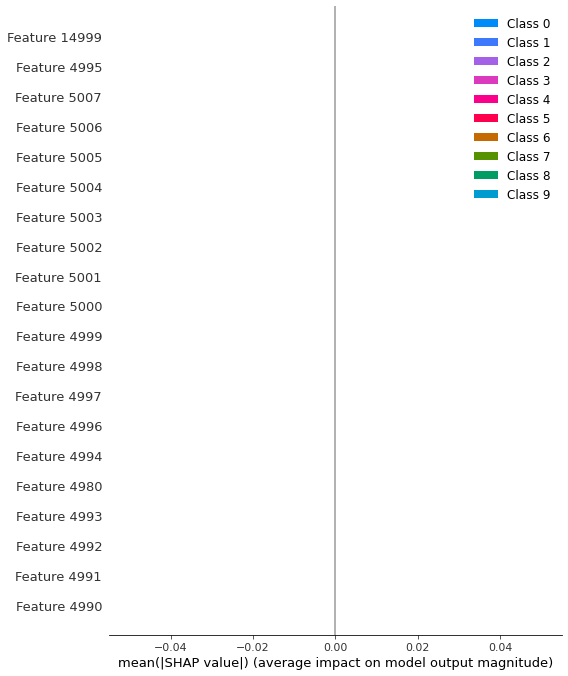

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


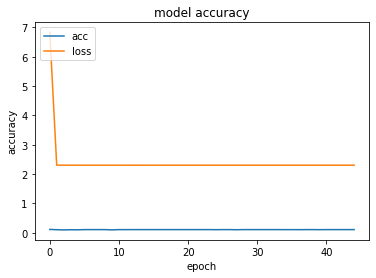

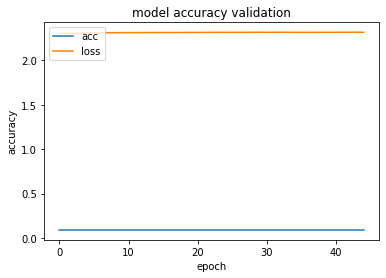

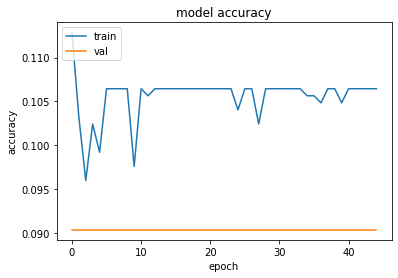

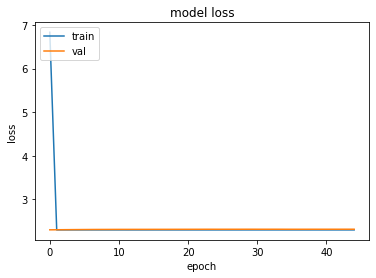

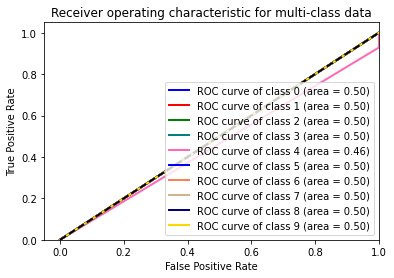

relu relu


Singal=theta layer=relu optimizer=adam
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 16s - loss: 2.4476 - acc: 0.1403 - val_loss: 2.3038 - val_acc: 0.0903
Epoch 3/100
1240/1240 - 16s - loss: 2.3027 - acc: 0.0919 - val_loss: 2.3044 - val_acc: 0.0903
Epoch 4/100
1240/1240 - 17s - loss: 2.3024 - acc: 0.1024 - val_loss: 2.3047 - val_acc: 0.0903
Epoch 5/100
1240/1240 - 17s - loss: 2.3023 - acc: 0.1024 - val_loss: 2.3051 - val_acc: 0.0903
Epoch 6/100
1240/1240 - 17s - loss: 2.3022 - acc: 0.1024 - val_loss: 2.3057 - val_acc: 0.0903
Epoch 7/100
1240/1240 - 16s - loss: 2.3021 - acc: 0.1024 - val_loss: 2.3060 - val_acc: 0.0903
Epoch 8/100
1240/1240 - 17s - loss: 2.3021 - acc: 0.0952 - val_loss: 2.3062 - val_acc: 0.0903
Epoch 9/100
1240/1240 - 17s - loss: 2.3019 - acc: 0.1008 - val_loss: 2.3068 - val_acc: 0.0839
Epoch 10/100
1240/1240 - 16s - loss: 2.3019 - acc: 0.0960 - val_loss: 2.3071 - val_acc: 0.0839
Epoch 11/100
1240/1240 - 17s - loss: 2.3020 - acc: 0.1065 - val_loss: 2.3072 - val_acc: 0.0839
Epoch 12/100
1240/1240 - 17s - loss: 2.3018 - acc: 0.1065 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


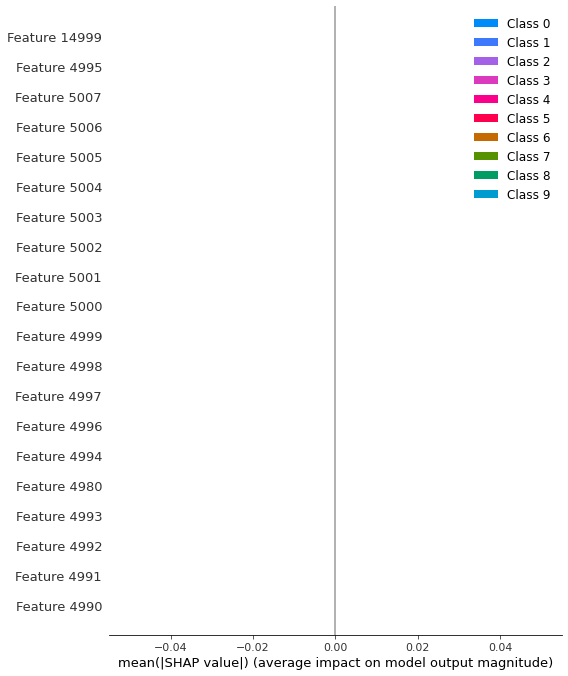

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


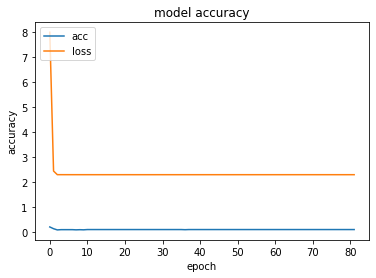

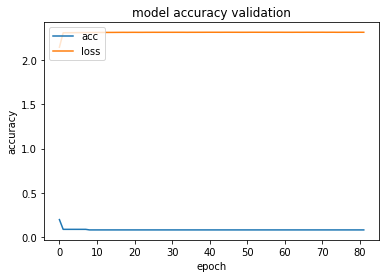

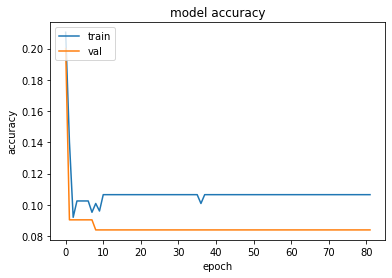

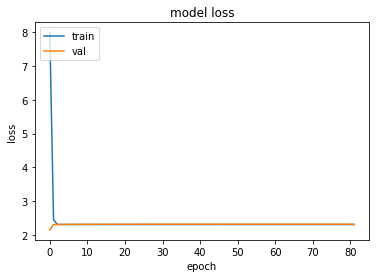

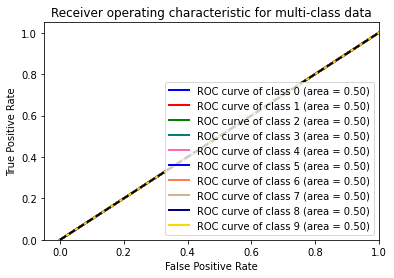

relu relu


Singal=theta layer=relu optimizer=nadam
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 65s - loss: 2.8620 - acc: 0.5960 - val_loss: 0.5476 - val_acc: 0.8065
Epoch 3/100
1240/1240 - 65s - loss: 0.3693 - acc: 0.8960 - val_loss: 0.1720 - val_acc: 0.9742
Epoch 4/100
1240/1240 - 65s - loss: 0.3374 - acc: 0.9548 - val_loss: 1.5159 - val_acc: 0.7290
Epoch 5/100
1240/1240 - 66s - loss: 2.0938 - acc: 0.8056 - val_loss: 1.0724 - val_acc: 0.6710
Epoch 6/100
1240/1240 - 65s - loss: 2.7596 - acc: 0.7831 - val_loss: 1.9470 - val_acc: 0.6194
Epoch 7/100
1240/1240 - 65s - loss: 1.4565 - acc: 0.7347 - val_loss: 0.5199 - val_acc: 0.8258
Epoch 8/100
1240/1240 - 65s - loss: 0.3416 - acc: 0.8992 - val_loss: 0.2636 - val_acc: 0.8774
Epoch 9/100
1240/1240 - 65s - loss: 0.1736 - acc: 0.9460 - val_loss: 0.2319 - val_acc: 0.9032
Epoch 10/100
1240/1240 - 65s - loss: 0.2087 - acc: 0.9734 - val_loss: 0.1986 - val_acc: 0.9355
Epoch 11/100
1240/1240 - 65s - loss: 0.4199 - acc: 0.9226 - val_loss: 0.4315 - val_acc: 0.8968
Epoch 12/100
1240/1240 - 65s - loss: 0.0885 - acc: 0.9863 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


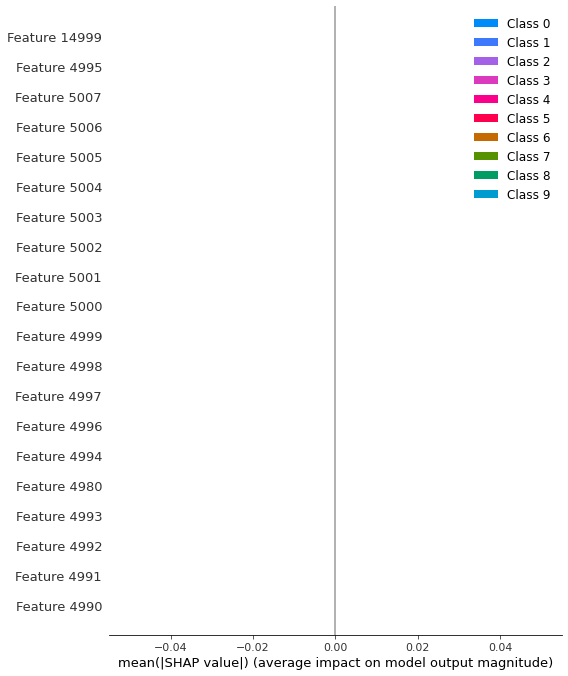

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


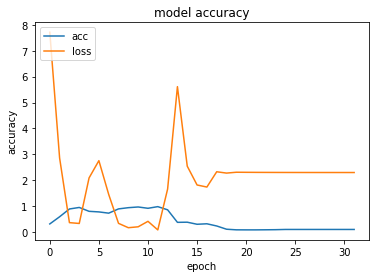

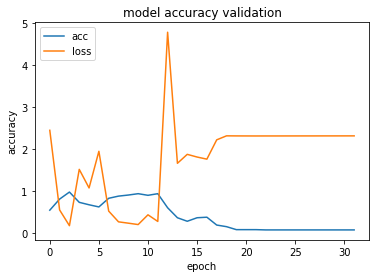

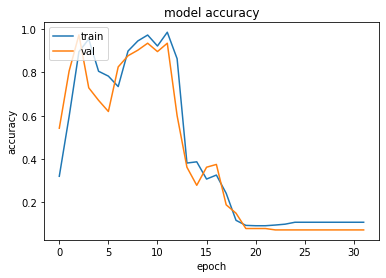

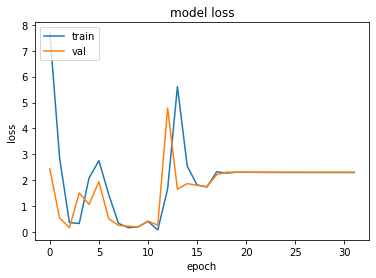

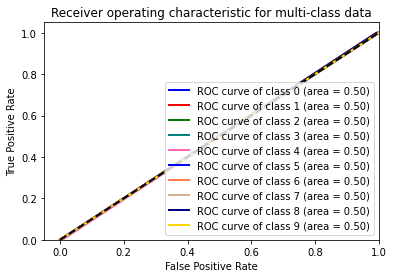

relu relu


Singal=theta layer=relu optimizer=sgd
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________


`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 10s - loss: 2.3026 - acc: 0.0887 - val_loss: 2.3058 - val_acc: 0.0839
Epoch 3/100
1240/1240 - 10s - loss: 2.3025 - acc: 0.0871 - val_loss: 2.3071 - val_acc: 0.0839
Epoch 4/100
1240/1240 - 10s - loss: 2.3023 - acc: 0.1065 - val_loss: 2.3082 - val_acc: 0.0839
Epoch 5/100
1240/1240 - 10s - loss: 2.3022 - acc: 0.1056 - val_loss: 2.3093 - val_acc: 0.0839
Epoch 6/100
1240/1240 - 10s - loss: 2.3021 - acc: 0.1016 - val_loss: 2.3102 - val_acc: 0.0839
Epoch 7/100
1240/1240 - 10s - loss: 2.3021 - acc: 0.0976 - val_loss: 2.3111 - val_acc: 0.0839
Epoch 8/100
1240/1240 - 10s - loss: 2.3020 - acc: 0.1040 - val_loss: 2.3118 - val_acc: 0.0839
Epoch 9/100
1240/1240 - 11s - loss: 2.3019 - acc: 0.1016 - val_loss: 2.3125 - val_acc: 0.0839
Epoch 10/100
1240/1240 - 10s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3131 - val_acc: 0.0839
Epoch 11/100
1240/1240 - 10s - loss: 2.3019 - acc: 0.1016 - val_loss: 2.3137 - val_acc: 0.0839
Epoch 12/100
1240/1240 - 10s - loss: 2.3019 - acc: 0.1065 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


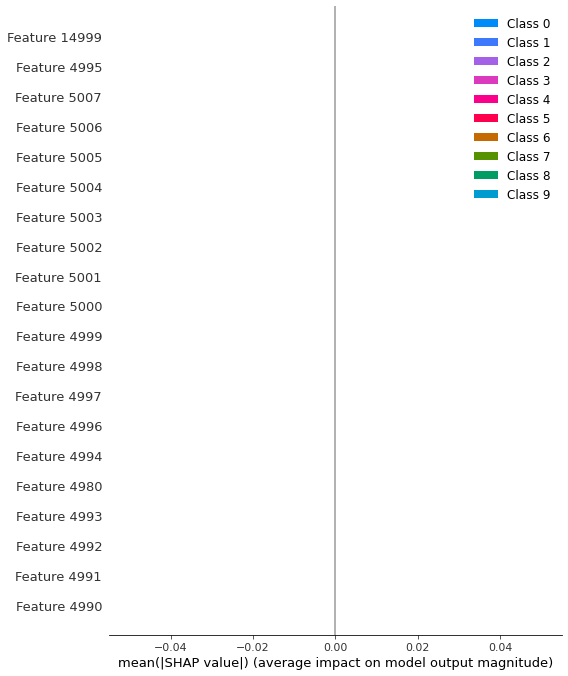

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


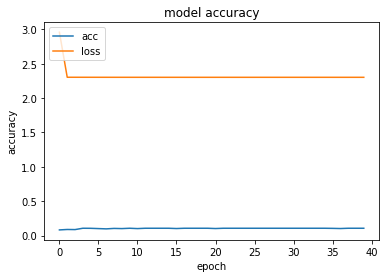

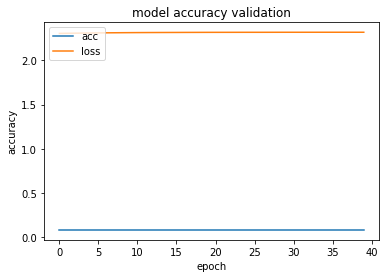

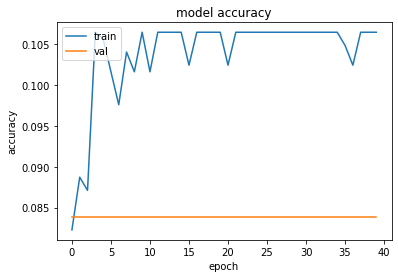

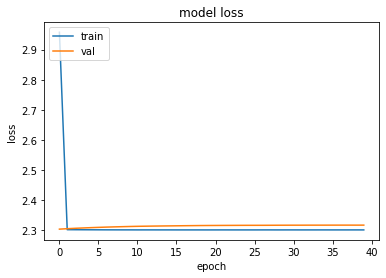

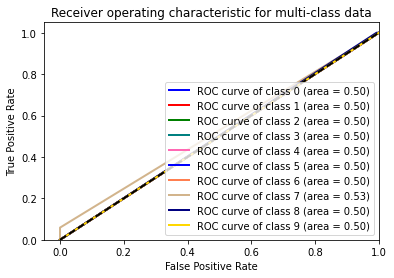

relu relu


Singal=theta layer=relu optimizer=adadelta
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_____________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 25s - loss: 2.1485 - acc: 0.3266 - val_loss: 2.3657 - val_acc: 0.3161
Epoch 3/100
1240/1240 - 25s - loss: 1.6202 - acc: 0.4395 - val_loss: 2.0978 - val_acc: 0.3484
Epoch 4/100
1240/1240 - 25s - loss: 1.3005 - acc: 0.5403 - val_loss: 1.9005 - val_acc: 0.3742
Epoch 5/100
1240/1240 - 25s - loss: 1.0905 - acc: 0.6210 - val_loss: 1.7214 - val_acc: 0.4000
Epoch 6/100
1240/1240 - 25s - loss: 0.9440 - acc: 0.6895 - val_loss: 1.6003 - val_acc: 0.4323
Epoch 7/100
1240/1240 - 25s - loss: 0.8338 - acc: 0.7371 - val_loss: 1.4815 - val_acc: 0.4581
Epoch 8/100
1240/1240 - 25s - loss: 0.7398 - acc: 0.7653 - val_loss: 1.3972 - val_acc: 0.5032
Epoch 9/100
1240/1240 - 25s - loss: 0.6693 - acc: 0.7968 - val_loss: 1.3114 - val_acc: 0.5419
Epoch 10/100
1240/1240 - 25s - loss: 0.6098 - acc: 0.8194 - val_loss: 1.2455 - val_acc: 0.5742
Epoch 11/100
1240/1240 - 25s - loss: 0.5604 - acc: 0.8379 - val_loss: 1.1756 - val_acc: 0.5935
Epoch 12/100
1240/1240 - 25s - loss: 0.5173 - acc: 0.8621 

Epoch 89/100
1240/1240 - 25s - loss: 0.0266 - acc: 0.9984 - val_loss: 0.4354 - val_acc: 0.8839
Epoch 90/100
1240/1240 - 25s - loss: 0.0259 - acc: 0.9984 - val_loss: 0.4371 - val_acc: 0.8839
Epoch 91/100
1240/1240 - 25s - loss: 0.0253 - acc: 0.9984 - val_loss: 0.4426 - val_acc: 0.8774
Epoch 92/100
1240/1240 - 25s - loss: 0.0247 - acc: 0.9984 - val_loss: 0.4385 - val_acc: 0.8839
Epoch 93/100
1240/1240 - 25s - loss: 0.0243 - acc: 0.9992 - val_loss: 0.4390 - val_acc: 0.8839
Epoch 94/100
1240/1240 - 25s - loss: 0.0237 - acc: 0.9992 - val_loss: 0.4366 - val_acc: 0.8839
Epoch 95/100
1240/1240 - 25s - loss: 0.0231 - acc: 0.9992 - val_loss: 0.4281 - val_acc: 0.8839
Epoch 96/100
1240/1240 - 25s - loss: 0.0226 - acc: 0.9992 - val_loss: 0.4327 - val_acc: 0.8839
Epoch 97/100
1240/1240 - 25s - loss: 0.0220 - acc: 0.9992 - val_loss: 0.4356 - val_acc: 0.8839
Epoch 98/100
1240/1240 - 25s - loss: 0.0216 - acc: 0.9992 - val_loss: 0.4373 - val_acc: 0.8839
Epoch 99/100
1240/1240 - 25s - loss: 0.0211 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


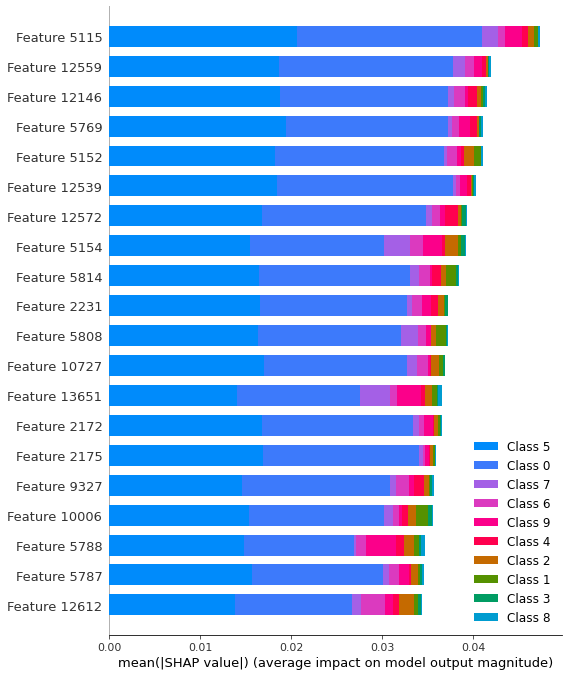

   class  sensitivity  specificity
0    1.0     0.917241     0.000000
1    2.0     0.904412     0.052632
2    3.0     0.903448     0.000000
3    4.0     0.892857     0.000000
4    5.0     0.814286     0.066667
5    6.0     0.878788     0.043478
6    7.0     0.888889     0.000000
7    8.0     0.911765     0.000000
8    9.0     0.876812     0.058824
9   10.0     1.000000     0.000000
class          5.50000
sensitivity    0.89885
specificity    0.02216
dtype: float64


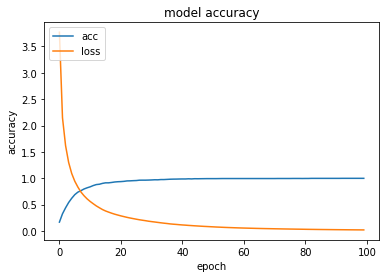

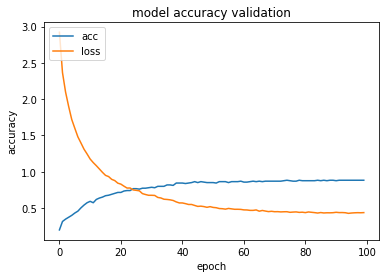

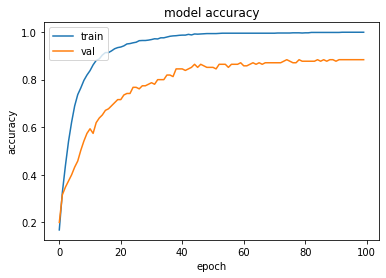

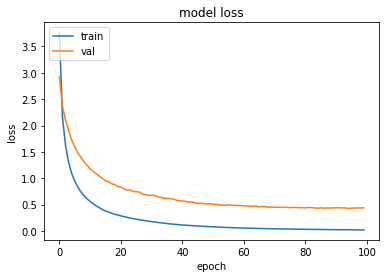

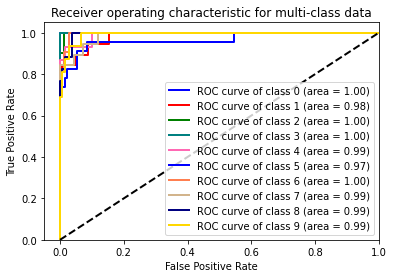

relu relu


Singal=theta layer=relu optimizer=adagrad
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 18s - loss: 0.3809 - acc: 0.9194 - val_loss: 0.3583 - val_acc: 0.9032
Epoch 3/100
1240/1240 - 17s - loss: 0.1439 - acc: 0.9839 - val_loss: 0.3033 - val_acc: 0.9419
Epoch 4/100
1240/1240 - 15s - loss: 0.0767 - acc: 0.9952 - val_loss: 0.2492 - val_acc: 0.9290
Epoch 5/100
1240/1240 - 15s - loss: 0.0499 - acc: 0.9992 - val_loss: 0.2366 - val_acc: 0.9484
Epoch 6/100
1240/1240 - 15s - loss: 0.0369 - acc: 0.9992 - val_loss: 0.2282 - val_acc: 0.9484
Epoch 7/100
1240/1240 - 15s - loss: 0.0282 - acc: 1.0000 - val_loss: 0.2228 - val_acc: 0.9484
Epoch 8/100
1240/1240 - 15s - loss: 0.0227 - acc: 1.0000 - val_loss: 0.2194 - val_acc: 0.9484
Epoch 9/100
1240/1240 - 15s - loss: 0.0190 - acc: 1.0000 - val_loss: 0.2168 - val_acc: 0.9484
Epoch 10/100
1240/1240 - 15s - loss: 0.0163 - acc: 1.0000 - val_loss: 0.2146 - val_acc: 0.9484
Epoch 11/100
1240/1240 - 15s - loss: 0.0140 - acc: 1.0000 - val_loss: 0.2130 - val_acc: 0.9484
Epoch 12/100
1240/1240 - 15s - loss: 0.0122 - acc: 1.0000 

Epoch 88/100
1240/1240 - 15s - loss: 7.6340e-04 - acc: 1.0000 - val_loss: 0.1959 - val_acc: 0.9290
Epoch 89/100
1240/1240 - 15s - loss: 7.5271e-04 - acc: 1.0000 - val_loss: 0.1953 - val_acc: 0.9290
Epoch 90/100
1240/1240 - 15s - loss: 7.4203e-04 - acc: 1.0000 - val_loss: 0.1955 - val_acc: 0.9290
Epoch 91/100
1240/1240 - 15s - loss: 7.3075e-04 - acc: 1.0000 - val_loss: 0.1953 - val_acc: 0.9290
Epoch 92/100
1240/1240 - 15s - loss: 7.2043e-04 - acc: 1.0000 - val_loss: 0.1952 - val_acc: 0.9290
Epoch 93/100
1240/1240 - 15s - loss: 7.1037e-04 - acc: 1.0000 - val_loss: 0.1951 - val_acc: 0.9290
Epoch 94/100
1240/1240 - 15s - loss: 7.0060e-04 - acc: 1.0000 - val_loss: 0.1950 - val_acc: 0.9290
Epoch 95/100
1240/1240 - 15s - loss: 6.9048e-04 - acc: 1.0000 - val_loss: 0.1950 - val_acc: 0.9290
Epoch 96/100
1240/1240 - 15s - loss: 6.8114e-04 - acc: 1.0000 - val_loss: 0.1948 - val_acc: 0.9290
Epoch 97/100
1240/1240 - 15s - loss: 6.7279e-04 - acc: 1.0000 - val_loss: 0.1948 - val_acc: 0.9290
Epoch 98/1

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


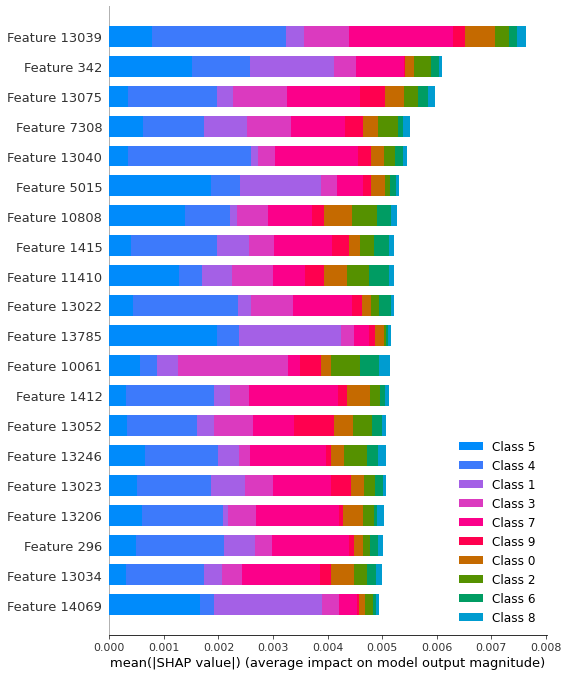

   class  sensitivity  specificity
0    1.0     0.851064          0.0
1    2.0     0.884615          0.0
2    3.0     0.871429          0.0
3    4.0     0.893617          0.0
4    5.0     0.864286          0.0
5    6.0     0.912409          0.0
6    7.0     0.909091          0.0
7    8.0     0.907801          0.0
8    9.0     0.907801          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.900211
specificity    0.000000
dtype: float64


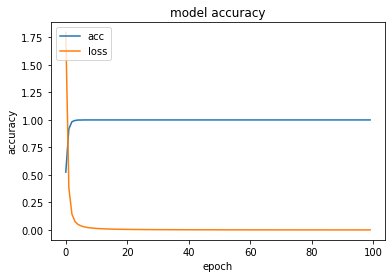

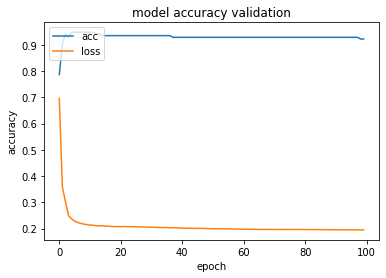

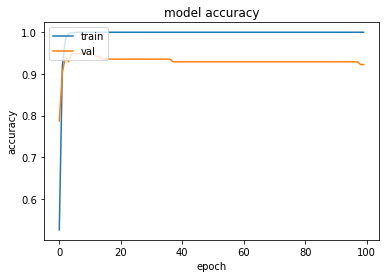

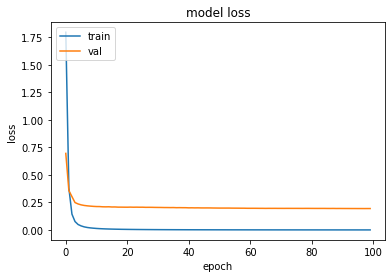

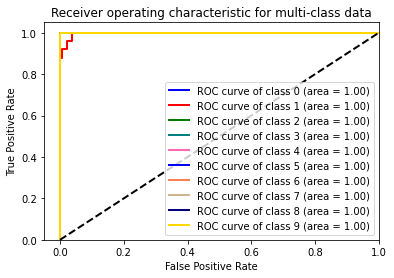

relu relu


Singal=theta layer=relu optimizer=adamax
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


1240/1240 - 21s - loss: 3.4698 - acc: 0.2226 - val_loss: 1.7676 - val_acc: 0.3484
Epoch 2/100
1240/1240 - 21s - loss: 1.6941 - acc: 0.3823 - val_loss: 1.4314 - val_acc: 0.4452
Epoch 3/100
1240/1240 - 21s - loss: 1.4334 - acc: 0.4887 - val_loss: 1.2143 - val_acc: 0.5677
Epoch 4/100
1240/1240 - 21s - loss: 1.3960 - acc: 0.5540 - val_loss: 1.0541 - val_acc: 0.6645
Epoch 5/100
1240/1240 - 21s - loss: 1.2117 - acc: 0.6081 - val_loss: 0.9921 - val_acc: 0.6452
Epoch 6/100
1240/1240 - 21s - loss: 1.0194 - acc: 0.6629 - val_loss: 0.8451 - val_acc: 0.6968
Epoch 7/100
1240/1240 - 21s - loss: 0.9302 - acc: 0.6911 - val_loss: 0.7399 - val_acc: 0.7548
Epoch 8/100
1240/1240 - 21s - loss: 0.8293 - acc: 0.7250 - val_loss: 0.6583 - val_acc: 0.7871
Epoch 9/100
1240/1240 - 21s - loss: 0.8352 - acc: 0.7306 - val_loss: 0.7685 - val_acc: 0.7355
Epoch 10/100
1240/1240 - 21s - loss: 0.7772 - acc: 0.7419 - val_loss: 0.5788 - val_acc: 0.8065
Epoch 11/100
1240/1240 - 21s - loss: 0.7458 - acc: 0.7444 - val_loss: 0

Epoch 88/100
1240/1240 - 21s - loss: 0.0026 - acc: 1.0000 - val_loss: 0.1366 - val_acc: 0.9935
Epoch 89/100
1240/1240 - 21s - loss: 0.0013 - acc: 1.0000 - val_loss: 0.1393 - val_acc: 0.9935
Epoch 90/100
1240/1240 - 21s - loss: 0.0012 - acc: 1.0000 - val_loss: 0.1433 - val_acc: 0.9935
Epoch 91/100
1240/1240 - 21s - loss: 0.0011 - acc: 1.0000 - val_loss: 0.1459 - val_acc: 0.9935
Epoch 92/100
1240/1240 - 21s - loss: 0.0011 - acc: 1.0000 - val_loss: 0.1478 - val_acc: 0.9871
Epoch 93/100
1240/1240 - 21s - loss: 0.0011 - acc: 1.0000 - val_loss: 0.1495 - val_acc: 0.9871
Epoch 94/100
1240/1240 - 21s - loss: 0.0010 - acc: 1.0000 - val_loss: 0.1507 - val_acc: 0.9871
Epoch 95/100
1240/1240 - 21s - loss: 0.0034 - acc: 0.9976 - val_loss: 0.1565 - val_acc: 0.9742
Epoch 96/100
1240/1240 - 21s - loss: 0.0013 - acc: 1.0000 - val_loss: 0.1186 - val_acc: 0.9742
Epoch 97/100
1240/1240 - 21s - loss: 5.5077e-04 - acc: 1.0000 - val_loss: 0.1316 - val_acc: 0.9742
Epoch 98/100
1240/1240 - 21s - loss: 1.4953e-0

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


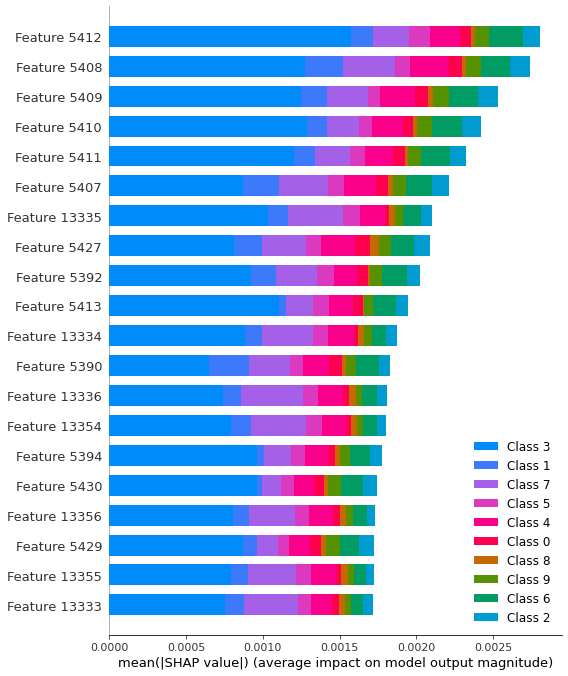

   class  sensitivity  specificity
0    1.0     0.851064     0.000000
1    2.0     0.902256     0.045455
2    3.0     0.881119     0.000000
3    4.0     0.897810     0.000000
4    5.0     0.886525     0.000000
5    6.0     0.920863     0.000000
6    7.0     0.875000     0.000000
7    8.0     0.890511     0.000000
8    9.0     0.893617     0.000000
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.899876
specificity    0.004545
dtype: float64


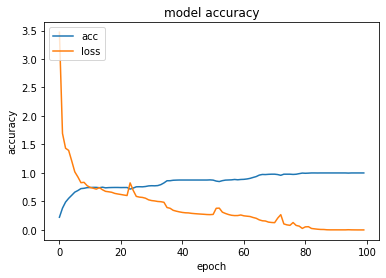

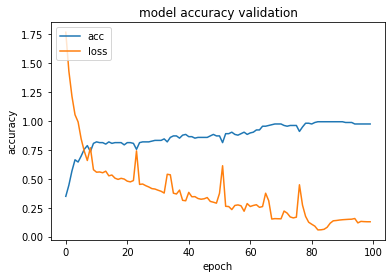

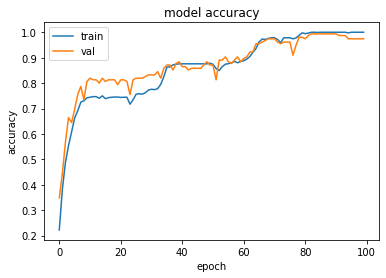

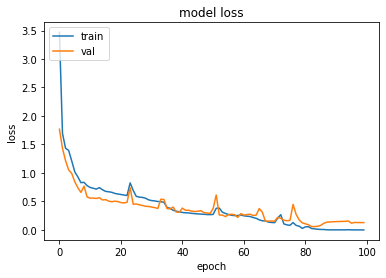

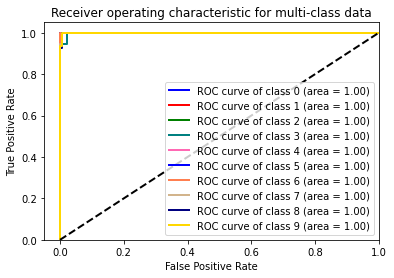

relu relu


Singal=theta layer=relu optimizer=ftrl
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 25s - loss: 2.3026 - acc: 0.1040 - val_loss: 2.3028 - val_acc: 0.0710
Epoch 3/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1048 - val_loss: 2.3029 - val_acc: 0.0710
Epoch 4/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1040 - val_loss: 2.3029 - val_acc: 0.0710
Epoch 5/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3030 - val_acc: 0.0710
Epoch 6/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3030 - val_acc: 0.0710
Epoch 7/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0710
Epoch 8/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0710
Epoch 9/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0710
Epoch 10/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0710
Epoch 11/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0710
Epoch 12/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 

Epoch 89/100
1240/1240 - 25s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3044 - val_acc: 0.0710
Epoch 90/100
1240/1240 - 25s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3044 - val_acc: 0.0710
Epoch 91/100
1240/1240 - 25s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3044 - val_acc: 0.0710
Epoch 92/100
1240/1240 - 25s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3044 - val_acc: 0.0710
Epoch 93/100
1240/1240 - 25s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3044 - val_acc: 0.0710
Epoch 94/100
1240/1240 - 25s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 95/100
1240/1240 - 25s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 96/100
1240/1240 - 25s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 97/100
1240/1240 - 25s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 98/100
1240/1240 - 25s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0710
Epoch 99/100
1240/1240 - 25s - loss: 2.3019 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


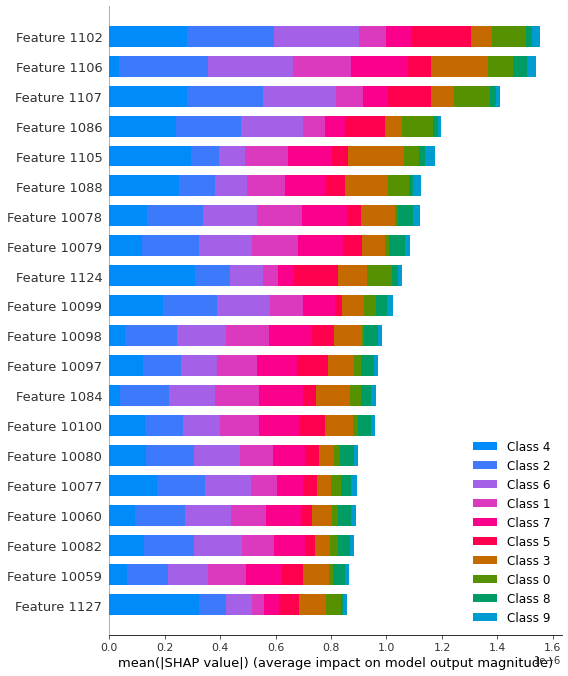

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


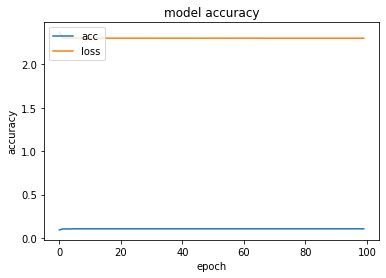

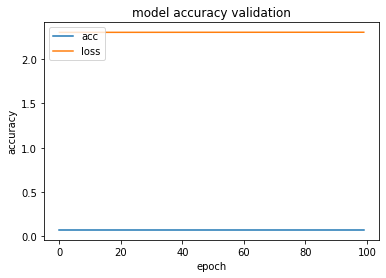

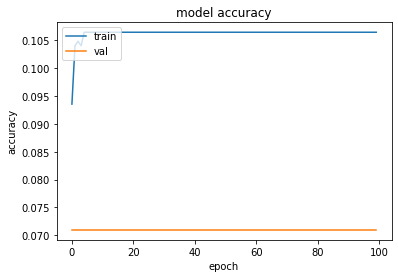

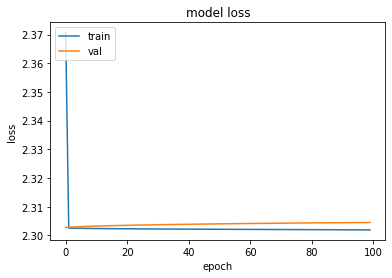

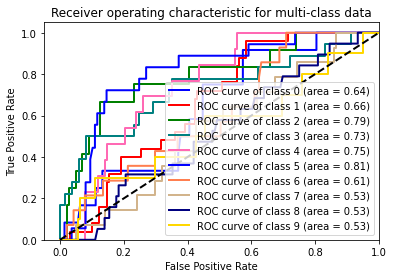

tanh relu


Singal=theta layer=tanh optimizer=rmsprop
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 38s - loss: 0.4349 - acc: 0.9460 - val_loss: 0.4826 - val_acc: 0.9032
Epoch 3/100
1240/1240 - 38s - loss: 0.1841 - acc: 0.9806 - val_loss: 0.2335 - val_acc: 0.9419
Epoch 4/100
1240/1240 - 38s - loss: 0.0763 - acc: 0.9919 - val_loss: 0.0765 - val_acc: 0.9935
Epoch 5/100
1240/1240 - 38s - loss: 0.0208 - acc: 0.9992 - val_loss: 0.0926 - val_acc: 0.9806
Epoch 6/100
1240/1240 - 38s - loss: 0.0067 - acc: 1.0000 - val_loss: 0.1450 - val_acc: 0.9742
Epoch 7/100
1240/1240 - 39s - loss: 0.0023 - acc: 1.0000 - val_loss: 0.1856 - val_acc: 0.9742
Epoch 8/100
1240/1240 - 38s - loss: 8.4207e-04 - acc: 1.0000 - val_loss: 0.2042 - val_acc: 0.9742
Epoch 9/100
1240/1240 - 38s - loss: 3.0405e-04 - acc: 1.0000 - val_loss: 0.2287 - val_acc: 0.9742
Epoch 10/100
1240/1240 - 38s - loss: 1.1000e-04 - acc: 1.0000 - val_loss: 0.2540 - val_acc: 0.9742
Epoch 11/100
1240/1240 - 38s - loss: 4.0622e-05 - acc: 1.0000 - val_loss: 0.2776 - val_acc: 0.9742
Epoch 12/100
1240/1240 - 38s - loss: 1.512

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


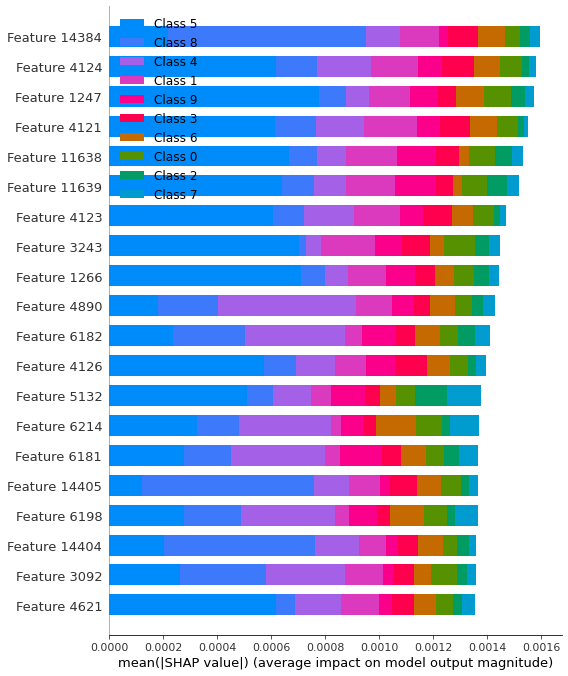

   class  sensitivity  specificity
0    1.0     0.859155          0.0
1    2.0     0.919708          0.0
2    3.0     0.881119          0.0
3    4.0     0.869565          0.0
4    5.0     0.888889          0.0
5    6.0     0.884892          0.0
6    7.0     0.928571          0.0
7    8.0     0.868966          0.0
8    9.0     0.882353          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.898322
specificity    0.000000
dtype: float64


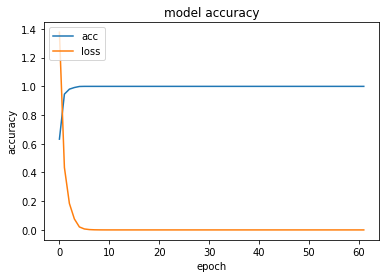

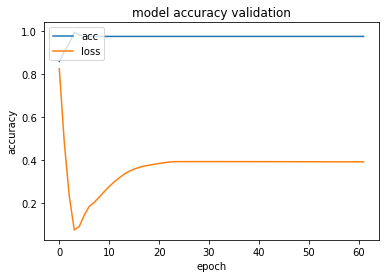

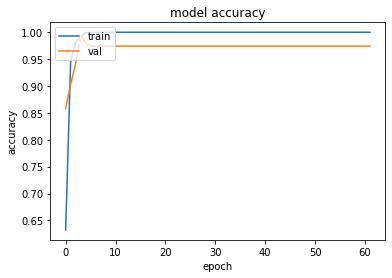

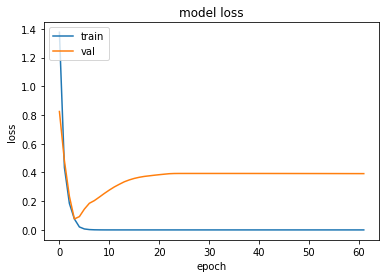

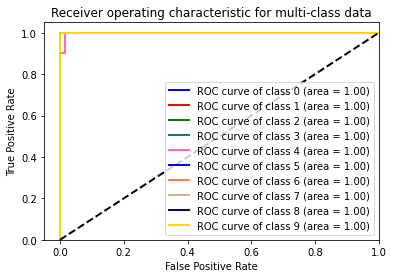

tanh relu


Singal=theta layer=tanh optimizer=adam
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


1240/1240 - 17s - loss: 1.4048 - acc: 0.6355 - val_loss: 0.7777 - val_acc: 0.9032
Epoch 2/100
1240/1240 - 17s - loss: 0.4777 - acc: 0.9419 - val_loss: 0.3410 - val_acc: 0.9548
Epoch 3/100
1240/1240 - 17s - loss: 0.2355 - acc: 0.9702 - val_loss: 0.3564 - val_acc: 0.9161
Epoch 4/100
1240/1240 - 17s - loss: 0.1854 - acc: 0.9726 - val_loss: 0.3012 - val_acc: 0.9226
Epoch 5/100
1240/1240 - 17s - loss: 0.1962 - acc: 0.9613 - val_loss: 0.4086 - val_acc: 0.9032
Epoch 6/100
1240/1240 - 17s - loss: 0.1136 - acc: 0.9790 - val_loss: 0.1229 - val_acc: 0.9742
Epoch 7/100
1240/1240 - 17s - loss: 0.0802 - acc: 0.9895 - val_loss: 0.1578 - val_acc: 0.9548
Epoch 8/100
1240/1240 - 17s - loss: 0.0339 - acc: 0.9992 - val_loss: 0.1192 - val_acc: 0.9742
Epoch 9/100
1240/1240 - 17s - loss: 0.0232 - acc: 1.0000 - val_loss: 0.1100 - val_acc: 0.9742
Epoch 10/100
1240/1240 - 17s - loss: 0.0193 - acc: 1.0000 - val_loss: 0.1128 - val_acc: 0.9677
Epoch 11/100
1240/1240 - 17s - loss: 0.0162 - acc: 1.0000 - val_loss: 0

Epoch 86/100
1240/1240 - 17s - loss: 5.4330e-05 - acc: 1.0000 - val_loss: 0.1311 - val_acc: 0.9806
Epoch 87/100
1240/1240 - 17s - loss: 5.1080e-05 - acc: 1.0000 - val_loss: 0.1317 - val_acc: 0.9806
Epoch 88/100
1240/1240 - 17s - loss: 4.8015e-05 - acc: 1.0000 - val_loss: 0.1324 - val_acc: 0.9806
Epoch 89/100
1240/1240 - 17s - loss: 4.5148e-05 - acc: 1.0000 - val_loss: 0.1331 - val_acc: 0.9806
Epoch 90/100
1240/1240 - 17s - loss: 4.2434e-05 - acc: 1.0000 - val_loss: 0.1338 - val_acc: 0.9806
Epoch 91/100
1240/1240 - 17s - loss: 3.9899e-05 - acc: 1.0000 - val_loss: 0.1344 - val_acc: 0.9806
Epoch 92/100
1240/1240 - 17s - loss: 3.7506e-05 - acc: 1.0000 - val_loss: 0.1351 - val_acc: 0.9806
Epoch 93/100
1240/1240 - 17s - loss: 3.5263e-05 - acc: 1.0000 - val_loss: 0.1358 - val_acc: 0.9806
Epoch 94/100
1240/1240 - 17s - loss: 3.3154e-05 - acc: 1.0000 - val_loss: 0.1365 - val_acc: 0.9806
Epoch 95/100
1240/1240 - 17s - loss: 3.1165e-05 - acc: 1.0000 - val_loss: 0.1371 - val_acc: 0.9806
Epoch 96/1

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


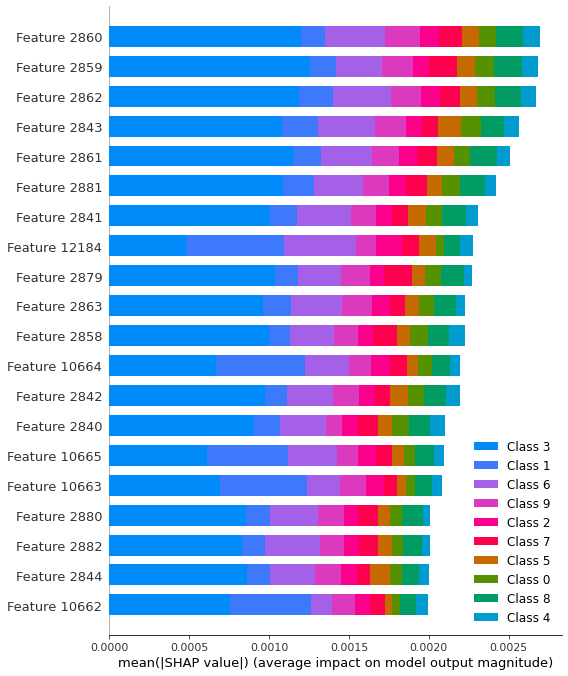

   class  sensitivity  specificity
0    1.0     0.825175     0.000000
1    2.0     0.883721     0.038462
2    3.0     0.858156     0.000000
3    4.0     0.925373     0.000000
4    5.0     0.897260     0.000000
5    6.0     0.921429     0.000000
6    7.0     0.888889     0.000000
7    8.0     0.897810     0.000000
8    9.0     0.887324     0.000000
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.898514
specificity    0.003846
dtype: float64


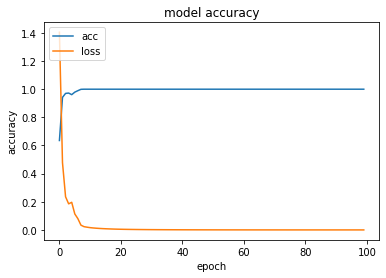

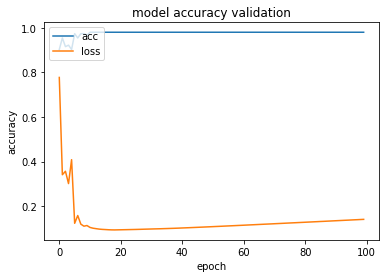

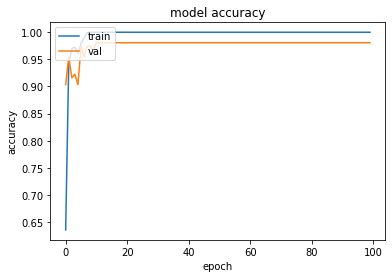

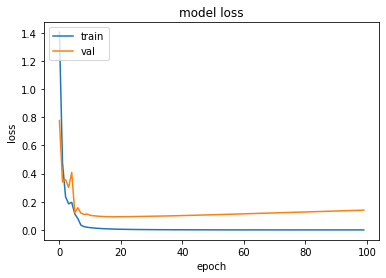

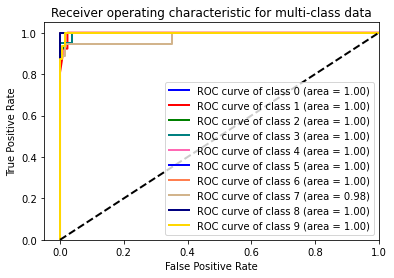

tanh relu


Singal=theta layer=tanh optimizer=nadam
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 65s - loss: 0.3855 - acc: 0.9532 - val_loss: 0.4358 - val_acc: 0.9161
Epoch 3/100
1240/1240 - 66s - loss: 0.2455 - acc: 0.9605 - val_loss: 0.2088 - val_acc: 0.9548
Epoch 4/100
1240/1240 - 65s - loss: 0.1783 - acc: 0.9718 - val_loss: 0.2093 - val_acc: 0.9548
Epoch 5/100
1240/1240 - 65s - loss: 0.1388 - acc: 0.9742 - val_loss: 0.1982 - val_acc: 0.9677
Epoch 6/100
1240/1240 - 65s - loss: 0.0639 - acc: 0.9944 - val_loss: 0.1945 - val_acc: 0.9613
Epoch 7/100
1240/1240 - 65s - loss: 0.0332 - acc: 1.0000 - val_loss: 0.1318 - val_acc: 0.9806
Epoch 8/100
1240/1240 - 66s - loss: 0.0250 - acc: 1.0000 - val_loss: 0.1307 - val_acc: 0.9806
Epoch 9/100
1240/1240 - 66s - loss: 0.0205 - acc: 1.0000 - val_loss: 0.1294 - val_acc: 0.9806
Epoch 10/100
1240/1240 - 65s - loss: 0.0171 - acc: 1.0000 - val_loss: 0.1289 - val_acc: 0.9806
Epoch 11/100
1240/1240 - 66s - loss: 0.0145 - acc: 1.0000 - val_loss: 0.1289 - val_acc: 0.9806
Epoch 12/100
1240/1240 - 65s - loss: 0.0125 - acc: 1.0000 

Epoch 87/100
1240/1240 - 65s - loss: 4.5787e-05 - acc: 1.0000 - val_loss: 0.2167 - val_acc: 0.9806
Epoch 88/100
1240/1240 - 65s - loss: 4.3028e-05 - acc: 1.0000 - val_loss: 0.2178 - val_acc: 0.9806
Epoch 89/100
1240/1240 - 65s - loss: 4.0429e-05 - acc: 1.0000 - val_loss: 0.2190 - val_acc: 0.9806
Epoch 90/100
1240/1240 - 65s - loss: 3.7992e-05 - acc: 1.0000 - val_loss: 0.2202 - val_acc: 0.9806
Epoch 91/100
1240/1240 - 66s - loss: 3.5701e-05 - acc: 1.0000 - val_loss: 0.2214 - val_acc: 0.9806
Epoch 92/100
1240/1240 - 65s - loss: 3.3534e-05 - acc: 1.0000 - val_loss: 0.2226 - val_acc: 0.9806
Epoch 93/100
1240/1240 - 65s - loss: 3.1520e-05 - acc: 1.0000 - val_loss: 0.2238 - val_acc: 0.9806
Epoch 94/100
1240/1240 - 66s - loss: 2.9622e-05 - acc: 1.0000 - val_loss: 0.2250 - val_acc: 0.9806
Epoch 95/100
1240/1240 - 65s - loss: 2.7840e-05 - acc: 1.0000 - val_loss: 0.2262 - val_acc: 0.9806
Epoch 96/100
1240/1240 - 65s - loss: 2.6153e-05 - acc: 1.0000 - val_loss: 0.2274 - val_acc: 0.9806
Epoch 97/1

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


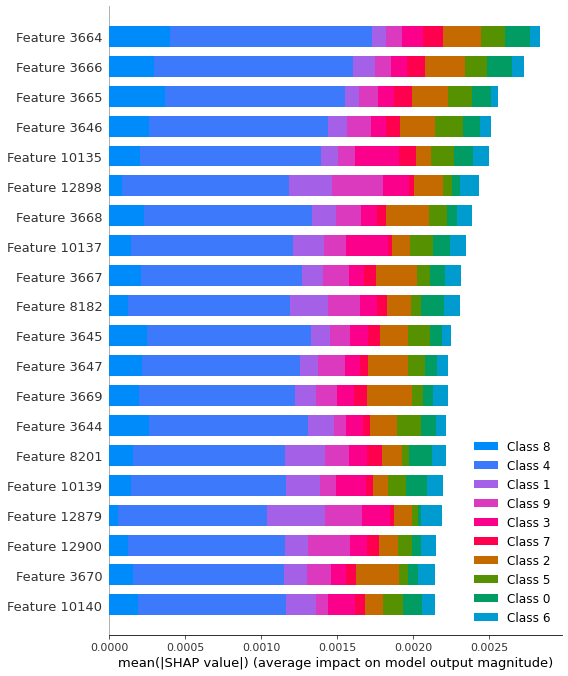

   class  sensitivity  specificity
0    1.0     0.866197       0.0000
1    2.0     0.918519       0.0000
2    3.0     0.855172       0.0000
3    4.0     0.888060       0.0000
4    5.0     0.907143       0.0000
5    6.0     0.916084       0.0000
6    7.0     0.895105       0.0000
7    8.0     0.863309       0.0625
8    9.0     0.881481       0.0000
9   10.0     1.000000       0.0000
class          5.500000
sensitivity    0.899107
specificity    0.006250
dtype: float64


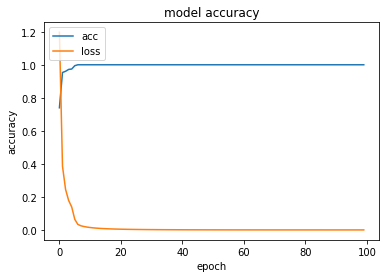

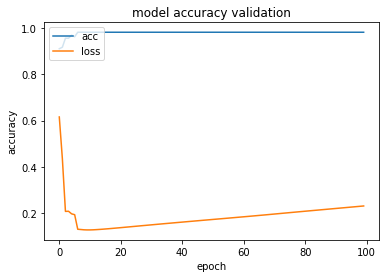

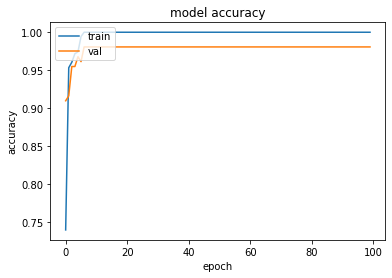

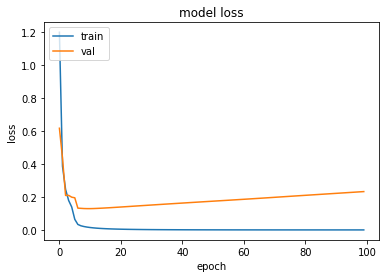

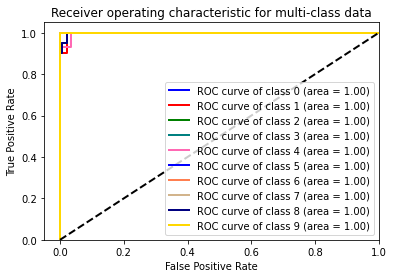

tanh relu


Singal=theta layer=tanh optimizer=sgd
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________


`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 10s - loss: 0.6136 - acc: 0.9887 - val_loss: 0.5564 - val_acc: 0.9742
Epoch 3/100
1240/1240 - 10s - loss: 0.3272 - acc: 1.0000 - val_loss: 0.3937 - val_acc: 0.9742
Epoch 4/100
1240/1240 - 10s - loss: 0.2159 - acc: 1.0000 - val_loss: 0.3151 - val_acc: 0.9677
Epoch 5/100
1240/1240 - 10s - loss: 0.1617 - acc: 1.0000 - val_loss: 0.2666 - val_acc: 0.9742
Epoch 6/100
1240/1240 - 10s - loss: 0.1293 - acc: 1.0000 - val_loss: 0.2342 - val_acc: 0.9806
Epoch 7/100
1240/1240 - 10s - loss: 0.1076 - acc: 1.0000 - val_loss: 0.2108 - val_acc: 0.9806
Epoch 8/100
1240/1240 - 10s - loss: 0.0920 - acc: 1.0000 - val_loss: 0.1933 - val_acc: 0.9806
Epoch 9/100
1240/1240 - 10s - loss: 0.0802 - acc: 1.0000 - val_loss: 0.1793 - val_acc: 0.9806
Epoch 10/100
1240/1240 - 10s - loss: 0.0711 - acc: 1.0000 - val_loss: 0.1679 - val_acc: 0.9806
Epoch 11/100
1240/1240 - 10s - loss: 0.0637 - acc: 1.0000 - val_loss: 0.1585 - val_acc: 0.9806
Epoch 12/100
1240/1240 - 10s - loss: 0.0577 - acc: 1.0000 

Epoch 89/100
1240/1240 - 10s - loss: 0.0067 - acc: 1.0000 - val_loss: 0.0831 - val_acc: 0.9806
Epoch 90/100
1240/1240 - 10s - loss: 0.0066 - acc: 1.0000 - val_loss: 0.0830 - val_acc: 0.9806
Epoch 91/100
1240/1240 - 10s - loss: 0.0065 - acc: 1.0000 - val_loss: 0.0830 - val_acc: 0.9806
Epoch 92/100
1240/1240 - 10s - loss: 0.0064 - acc: 1.0000 - val_loss: 0.0829 - val_acc: 0.9806
Epoch 93/100
1240/1240 - 10s - loss: 0.0064 - acc: 1.0000 - val_loss: 0.0828 - val_acc: 0.9806
Epoch 94/100
1240/1240 - 10s - loss: 0.0063 - acc: 1.0000 - val_loss: 0.0827 - val_acc: 0.9806
Epoch 95/100
1240/1240 - 10s - loss: 0.0062 - acc: 1.0000 - val_loss: 0.0826 - val_acc: 0.9806
Epoch 96/100
1240/1240 - 10s - loss: 0.0062 - acc: 1.0000 - val_loss: 0.0826 - val_acc: 0.9806
Epoch 97/100
1240/1240 - 10s - loss: 0.0061 - acc: 1.0000 - val_loss: 0.0825 - val_acc: 0.9806
Epoch 98/100
1240/1240 - 10s - loss: 0.0060 - acc: 1.0000 - val_loss: 0.0824 - val_acc: 0.9806
Epoch 99/100
1240/1240 - 10s - loss: 0.0060 - acc:

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


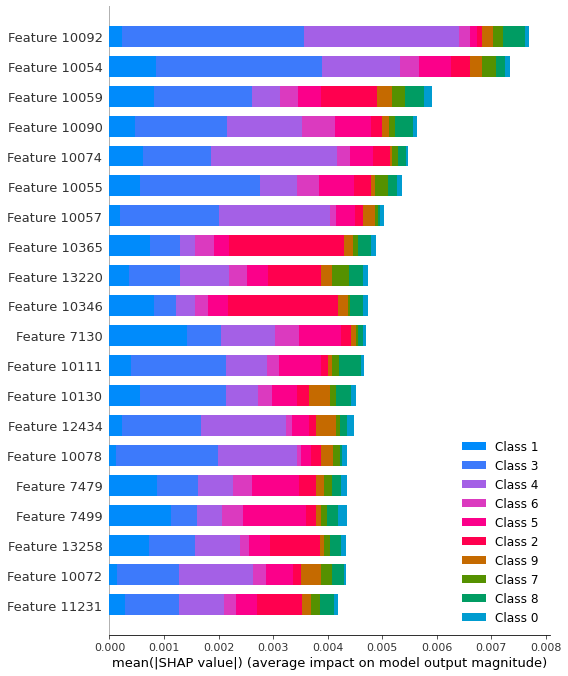

   class  sensitivity  specificity
0    1.0     0.841379          0.0
1    2.0     0.879699          0.0
2    3.0     0.864286          0.0
3    4.0     0.897059          0.0
4    5.0     0.872340          0.0
5    6.0     0.898551          0.0
6    7.0     0.900709          0.0
7    8.0     0.892857          0.0
8    9.0     0.913043          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.895992
specificity    0.000000
dtype: float64


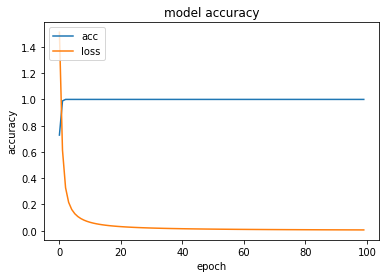

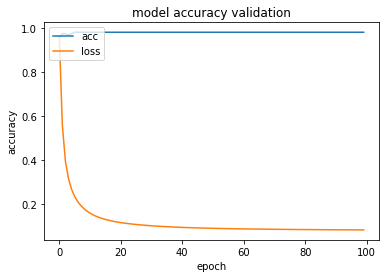

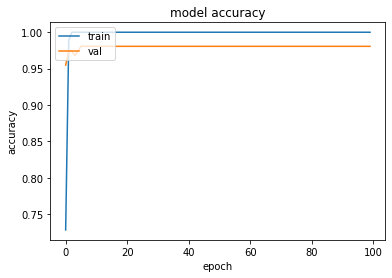

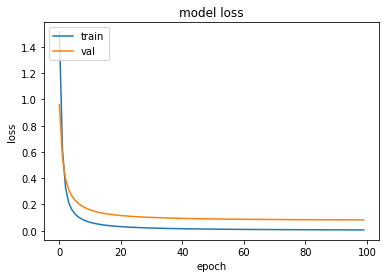

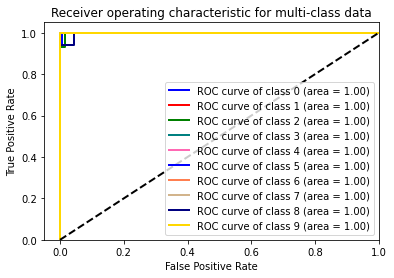

tanh relu


Singal=theta layer=tanh optimizer=adadelta
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_____________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 21s - loss: 2.1745 - acc: 0.2298 - val_loss: 2.2655 - val_acc: 0.1677
Epoch 3/100
1240/1240 - 21s - loss: 2.0783 - acc: 0.3282 - val_loss: 2.2324 - val_acc: 0.1742
Epoch 4/100
1240/1240 - 21s - loss: 1.9998 - acc: 0.4210 - val_loss: 2.2006 - val_acc: 0.2000
Epoch 5/100
1240/1240 - 21s - loss: 1.9328 - acc: 0.5129 - val_loss: 2.1704 - val_acc: 0.2129
Epoch 6/100
1240/1240 - 21s - loss: 1.8746 - acc: 0.5532 - val_loss: 2.1429 - val_acc: 0.2258
Epoch 7/100
1240/1240 - 21s - loss: 1.8231 - acc: 0.5903 - val_loss: 2.1168 - val_acc: 0.2710
Epoch 8/100
1240/1240 - 21s - loss: 1.7780 - acc: 0.6137 - val_loss: 2.0910 - val_acc: 0.2903
Epoch 9/100
1240/1240 - 21s - loss: 1.7376 - acc: 0.6411 - val_loss: 2.0668 - val_acc: 0.3032
Epoch 10/100
1240/1240 - 21s - loss: 1.7003 - acc: 0.6637 - val_loss: 2.0427 - val_acc: 0.3161
Epoch 11/100
1240/1240 - 21s - loss: 1.6665 - acc: 0.6798 - val_loss: 2.0209 - val_acc: 0.3419
Epoch 12/100
1240/1240 - 21s - loss: 1.6355 - acc: 0.7008 

Epoch 89/100
1240/1240 - 21s - loss: 0.7932 - acc: 0.8992 - val_loss: 1.1357 - val_acc: 0.8194
Epoch 90/100
1240/1240 - 21s - loss: 0.7882 - acc: 0.9000 - val_loss: 1.1293 - val_acc: 0.8194
Epoch 91/100
1240/1240 - 21s - loss: 0.7833 - acc: 0.9024 - val_loss: 1.1232 - val_acc: 0.8194
Epoch 92/100
1240/1240 - 21s - loss: 0.7785 - acc: 0.9016 - val_loss: 1.1176 - val_acc: 0.8194
Epoch 93/100
1240/1240 - 21s - loss: 0.7738 - acc: 0.9032 - val_loss: 1.1111 - val_acc: 0.8194
Epoch 94/100
1240/1240 - 21s - loss: 0.7693 - acc: 0.9056 - val_loss: 1.1056 - val_acc: 0.8194
Epoch 95/100
1240/1240 - 21s - loss: 0.7648 - acc: 0.9073 - val_loss: 1.0997 - val_acc: 0.8194
Epoch 96/100
1240/1240 - 21s - loss: 0.7602 - acc: 0.9081 - val_loss: 1.0940 - val_acc: 0.8194
Epoch 97/100
1240/1240 - 21s - loss: 0.7560 - acc: 0.9121 - val_loss: 1.0881 - val_acc: 0.8194
Epoch 98/100
1240/1240 - 21s - loss: 0.7516 - acc: 0.9137 - val_loss: 1.0831 - val_acc: 0.8194
Epoch 99/100
1240/1240 - 21s - loss: 0.7475 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


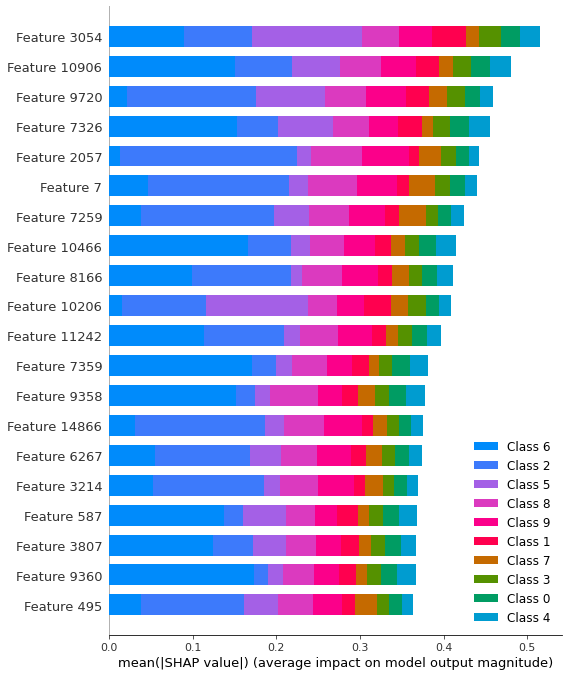

   class  sensitivity  specificity
0    1.0     0.881119          0.0
1    2.0     0.914286          0.0
2    3.0     0.853147          0.0
3    4.0     0.880597          0.0
4    5.0     0.858156          0.0
5    6.0     0.992806          0.0
6    7.0     0.904762          0.0
7    8.0     0.864286          0.0
8    9.0     0.857143          0.0
9   10.0     1.000000          0.0
class          5.50000
sensitivity    0.90063
specificity    0.00000
dtype: float64


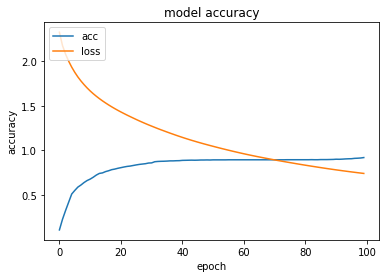

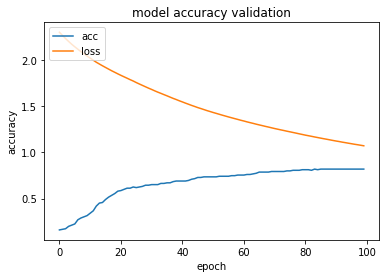

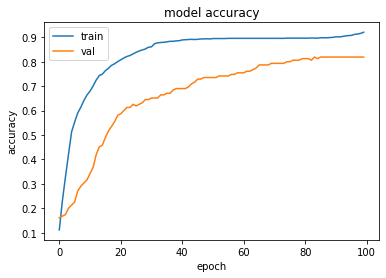

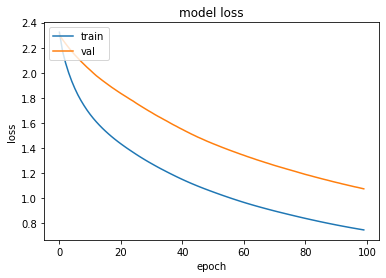

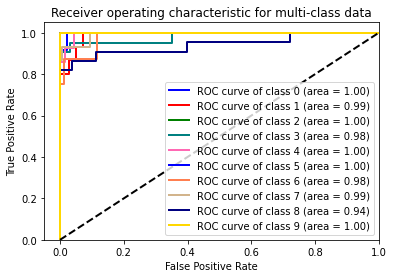

tanh relu


Singal=theta layer=tanh optimizer=adagrad
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 14s - loss: 1.3606 - acc: 0.8839 - val_loss: 1.3386 - val_acc: 0.8903
Epoch 3/100
1240/1240 - 14s - loss: 1.0909 - acc: 0.9621 - val_loss: 1.1819 - val_acc: 0.9290
Epoch 4/100
1240/1240 - 14s - loss: 0.9333 - acc: 0.9879 - val_loss: 1.0755 - val_acc: 0.9419
Epoch 5/100
1240/1240 - 14s - loss: 0.8278 - acc: 0.9935 - val_loss: 0.9915 - val_acc: 0.9484
Epoch 6/100
1240/1240 - 14s - loss: 0.7513 - acc: 0.9984 - val_loss: 0.9266 - val_acc: 0.9548
Epoch 7/100
1240/1240 - 14s - loss: 0.6928 - acc: 0.9992 - val_loss: 0.8737 - val_acc: 0.9548
Epoch 8/100
1240/1240 - 14s - loss: 0.6457 - acc: 1.0000 - val_loss: 0.8280 - val_acc: 0.9548
Epoch 9/100
1240/1240 - 14s - loss: 0.6069 - acc: 1.0000 - val_loss: 0.7906 - val_acc: 0.9548
Epoch 10/100
1240/1240 - 14s - loss: 0.5741 - acc: 1.0000 - val_loss: 0.7571 - val_acc: 0.9548
Epoch 11/100
1240/1240 - 14s - loss: 0.5460 - acc: 1.0000 - val_loss: 0.7268 - val_acc: 0.9548
Epoch 12/100
1240/1240 - 14s - loss: 0.5215 - acc: 1.0000 

Epoch 89/100
1240/1240 - 14s - loss: 0.1529 - acc: 1.0000 - val_loss: 0.2819 - val_acc: 0.9613
Epoch 90/100
1240/1240 - 14s - loss: 0.1517 - acc: 1.0000 - val_loss: 0.2804 - val_acc: 0.9613
Epoch 91/100
1240/1240 - 14s - loss: 0.1505 - acc: 1.0000 - val_loss: 0.2790 - val_acc: 0.9613
Epoch 92/100
1240/1240 - 14s - loss: 0.1494 - acc: 1.0000 - val_loss: 0.2776 - val_acc: 0.9613
Epoch 93/100
1240/1240 - 14s - loss: 0.1482 - acc: 1.0000 - val_loss: 0.2762 - val_acc: 0.9613
Epoch 94/100
1240/1240 - 14s - loss: 0.1471 - acc: 1.0000 - val_loss: 0.2747 - val_acc: 0.9613
Epoch 95/100
1240/1240 - 14s - loss: 0.1460 - acc: 1.0000 - val_loss: 0.2733 - val_acc: 0.9613
Epoch 96/100
1240/1240 - 14s - loss: 0.1449 - acc: 1.0000 - val_loss: 0.2720 - val_acc: 0.9613
Epoch 97/100
1240/1240 - 14s - loss: 0.1438 - acc: 1.0000 - val_loss: 0.2707 - val_acc: 0.9613
Epoch 98/100
1240/1240 - 14s - loss: 0.1428 - acc: 1.0000 - val_loss: 0.2694 - val_acc: 0.9613
Epoch 99/100
1240/1240 - 14s - loss: 0.1417 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


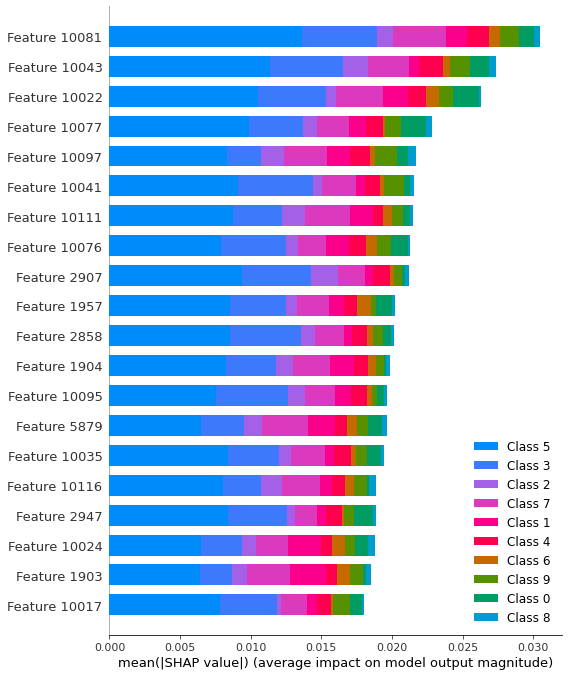

   class  sensitivity  specificity
0    1.0     0.862069          0.0
1    2.0     0.911111          0.0
2    3.0     0.825175          0.0
3    4.0     0.893130          0.0
4    5.0     0.880282          0.0
5    6.0     0.905109          0.0
6    7.0     0.859155          0.0
7    8.0     0.905109          0.0
8    9.0     0.921986          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.896313
specificity    0.000000
dtype: float64


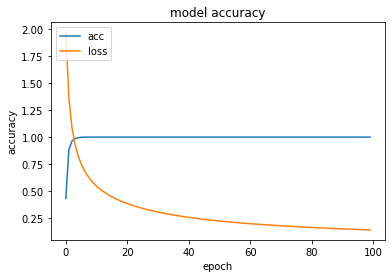

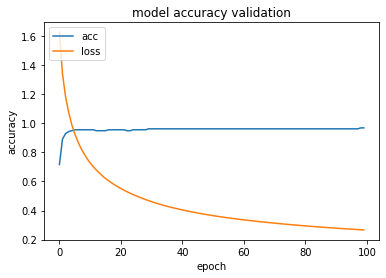

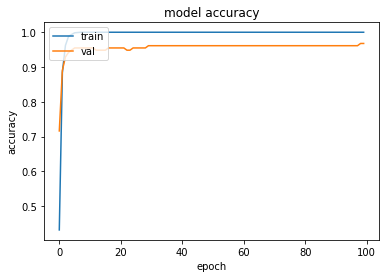

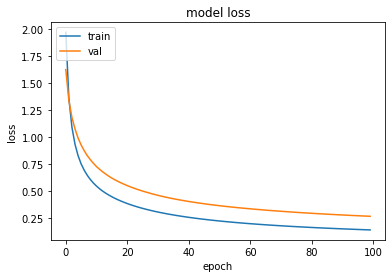

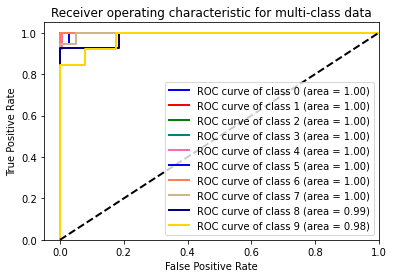

tanh relu


Singal=theta layer=tanh optimizer=adamax
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 22s - loss: 0.5277 - acc: 0.9887 - val_loss: 0.4290 - val_acc: 0.9806
Epoch 3/100
1240/1240 - 22s - loss: 0.2846 - acc: 1.0000 - val_loss: 0.2823 - val_acc: 0.9806
Epoch 4/100
1240/1240 - 22s - loss: 0.1921 - acc: 1.0000 - val_loss: 0.2176 - val_acc: 0.9806
Epoch 5/100
1240/1240 - 22s - loss: 0.1431 - acc: 1.0000 - val_loss: 0.1785 - val_acc: 0.9806
Epoch 6/100
1240/1240 - 22s - loss: 0.1115 - acc: 1.0000 - val_loss: 0.1509 - val_acc: 0.9806
Epoch 7/100
1240/1240 - 22s - loss: 0.0893 - acc: 1.0000 - val_loss: 0.1304 - val_acc: 0.9806
Epoch 8/100
1240/1240 - 22s - loss: 0.0728 - acc: 1.0000 - val_loss: 0.1154 - val_acc: 0.9806
Epoch 9/100
1240/1240 - 22s - loss: 0.0603 - acc: 1.0000 - val_loss: 0.1041 - val_acc: 0.9806
Epoch 10/100
1240/1240 - 22s - loss: 0.0504 - acc: 1.0000 - val_loss: 0.0954 - val_acc: 0.9806
Epoch 11/100
1240/1240 - 22s - loss: 0.0425 - acc: 1.0000 - val_loss: 0.0886 - val_acc: 0.9806
Epoch 12/100
1240/1240 - 22s - loss: 0.0361 - acc: 1.0000 

Epoch 87/100
1240/1240 - 19s - loss: 2.5853e-06 - acc: 1.0000 - val_loss: 0.0858 - val_acc: 0.9806
Epoch 88/100
1240/1240 - 19s - loss: 2.2761e-06 - acc: 1.0000 - val_loss: 0.0864 - val_acc: 0.9806
Epoch 89/100
1240/1240 - 19s - loss: 2.0052e-06 - acc: 1.0000 - val_loss: 0.0870 - val_acc: 0.9806
Epoch 90/100
1240/1240 - 19s - loss: 1.7638e-06 - acc: 1.0000 - val_loss: 0.0876 - val_acc: 0.9806
Epoch 91/100
1240/1240 - 19s - loss: 1.5729e-06 - acc: 1.0000 - val_loss: 0.0882 - val_acc: 0.9806
Epoch 92/100
1240/1240 - 19s - loss: 1.3843e-06 - acc: 1.0000 - val_loss: 0.0887 - val_acc: 0.9806
Epoch 93/100
1240/1240 - 19s - loss: 1.2326e-06 - acc: 1.0000 - val_loss: 0.0892 - val_acc: 0.9806
Epoch 94/100
1240/1240 - 19s - loss: 1.0951e-06 - acc: 1.0000 - val_loss: 0.0895 - val_acc: 0.9806
Epoch 95/100
1240/1240 - 19s - loss: 9.7867e-07 - acc: 1.0000 - val_loss: 0.0901 - val_acc: 0.9806
Epoch 96/100
1240/1240 - 19s - loss: 8.5773e-07 - acc: 1.0000 - val_loss: 0.0909 - val_acc: 0.9806
Epoch 97/1

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


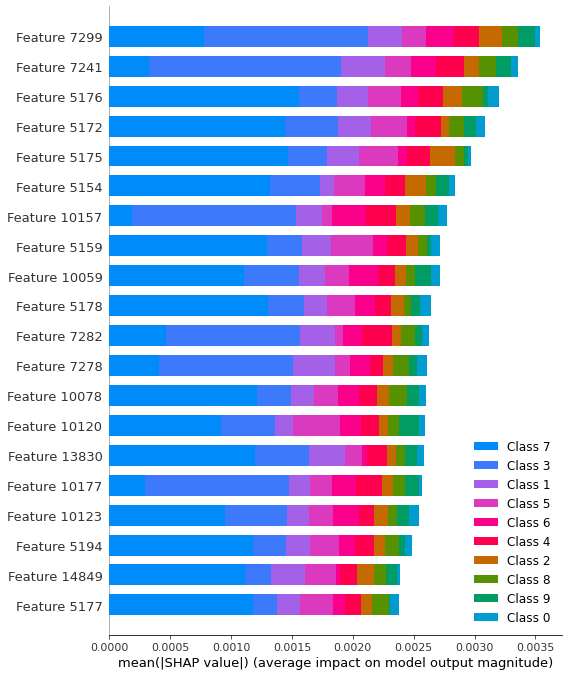

   class  sensitivity  specificity
0    1.0     0.858108          0.0
1    2.0     0.902985          0.0
2    3.0     0.866197          0.0
3    4.0     0.883212          0.0
4    5.0     0.841727          0.0
5    6.0     0.864662          0.0
6    7.0     0.883212          0.0
7    8.0     0.906475          0.0
8    9.0     0.929078          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.893565
specificity    0.000000
dtype: float64


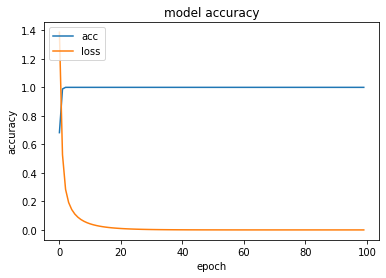

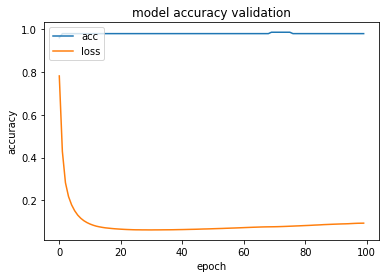

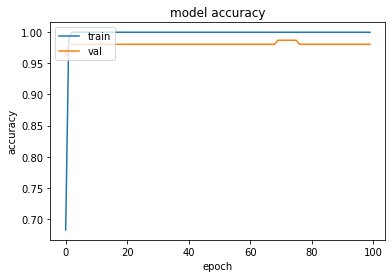

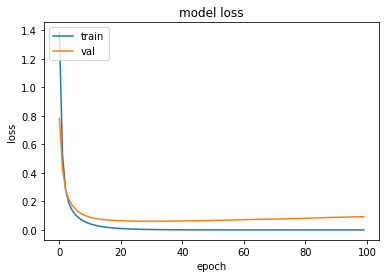

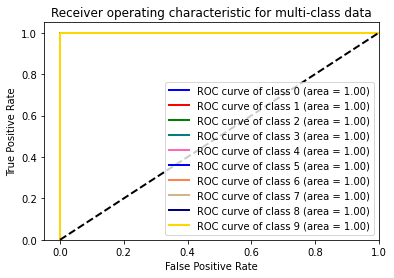

tanh relu


Singal=theta layer=tanh optimizer=ftrl
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 21s - loss: 2.3026 - acc: 0.0911 - val_loss: 2.3028 - val_acc: 0.0516
Epoch 3/100
1240/1240 - 21s - loss: 2.3025 - acc: 0.1056 - val_loss: 2.3029 - val_acc: 0.0516
Epoch 4/100
1240/1240 - 21s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3030 - val_acc: 0.0516
Epoch 5/100
1240/1240 - 21s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3030 - val_acc: 0.0516
Epoch 6/100
1240/1240 - 21s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0516
Epoch 7/100
1240/1240 - 21s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0516
Epoch 8/100
1240/1240 - 21s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0516
Epoch 9/100
1240/1240 - 21s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0516
Epoch 10/100
1240/1240 - 21s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0516
Epoch 11/100
1240/1240 - 21s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3033 - val_acc: 0.0516
Epoch 12/100
1240/1240 - 21s - loss: 2.3024 - acc: 0.1065 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


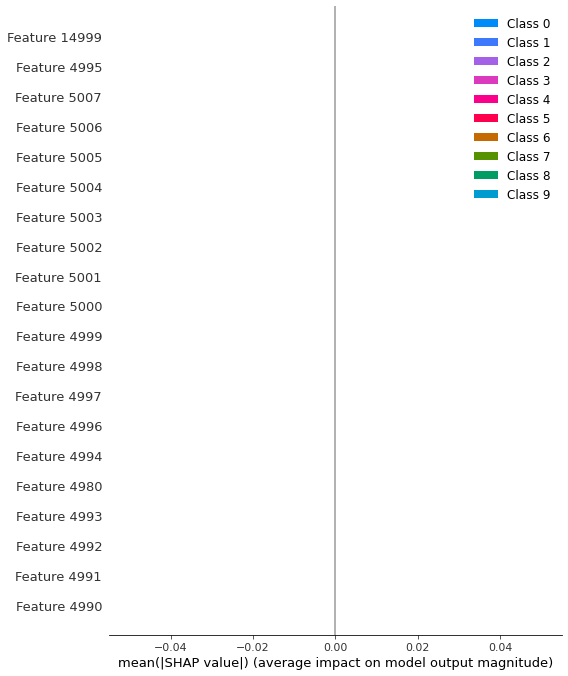

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


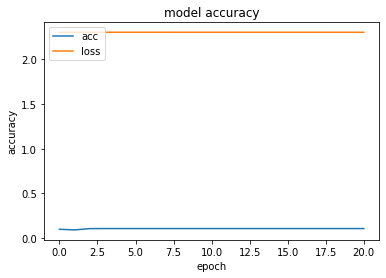

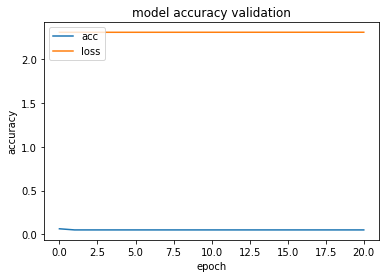

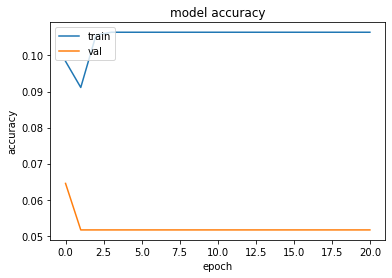

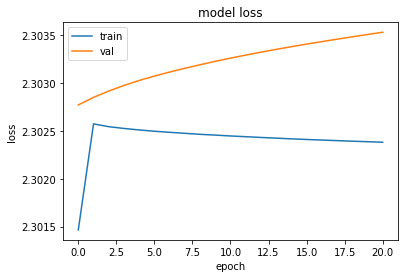

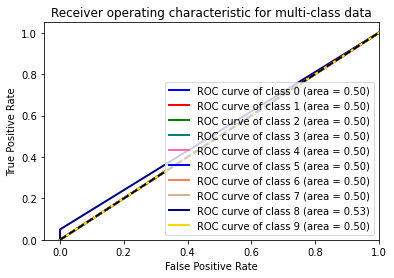

relu tanh


Singal=theta layer=relu optimizer=rmsprop
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 38s - loss: 2.3037 - acc: 0.1056 - val_loss: 2.3050 - val_acc: 0.0774
Epoch 3/100
1240/1240 - 38s - loss: 2.3026 - acc: 0.1065 - val_loss: 2.3059 - val_acc: 0.0774
Epoch 4/100
1240/1240 - 38s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3068 - val_acc: 0.0774
Epoch 5/100
1240/1240 - 38s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3075 - val_acc: 0.0774
Epoch 6/100
1240/1240 - 38s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3083 - val_acc: 0.0774
Epoch 7/100
1240/1240 - 38s - loss: 2.3021 - acc: 0.1032 - val_loss: 2.3090 - val_acc: 0.0774
Epoch 8/100
1240/1240 - 38s - loss: 2.3020 - acc: 0.1065 - val_loss: 2.3097 - val_acc: 0.0774
Epoch 9/100
1240/1240 - 38s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3103 - val_acc: 0.0774
Epoch 10/100
1240/1240 - 38s - loss: 2.3019 - acc: 0.0895 - val_loss: 2.3108 - val_acc: 0.0774
Epoch 11/100
1240/1240 - 38s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3113 - val_acc: 0.0774
Epoch 12/100
1240/1240 - 38s - loss: 2.3019 - acc: 0.1065 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


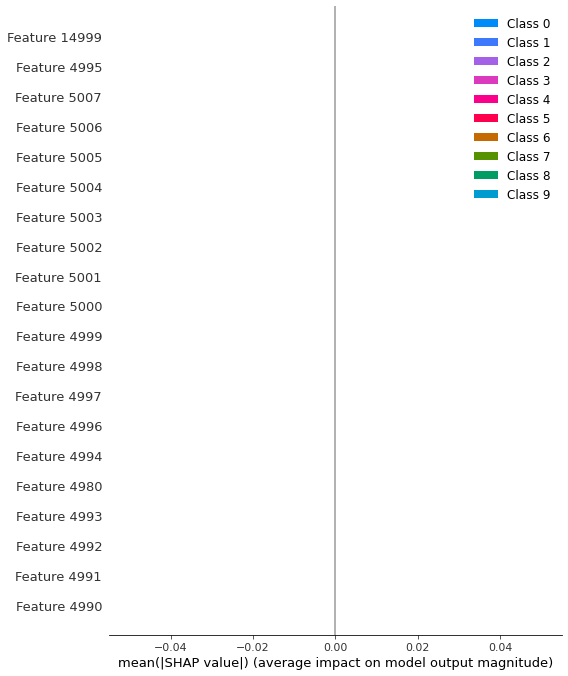

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


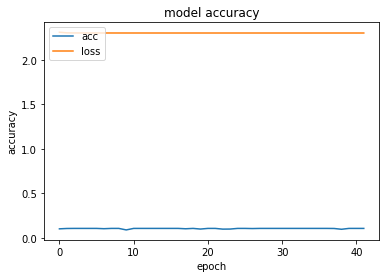

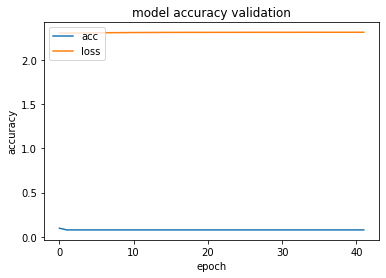

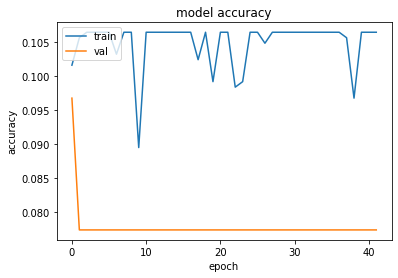

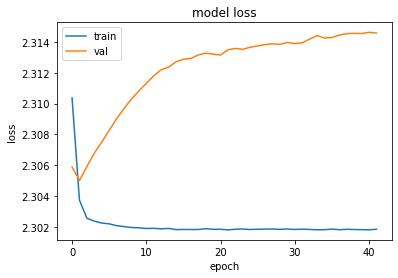

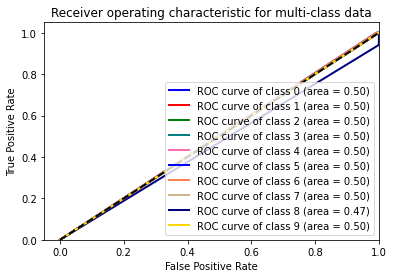

relu tanh


Singal=theta layer=relu optimizer=adam
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 15s - loss: 2.3026 - acc: 0.0960 - val_loss: 2.3042 - val_acc: 0.0968
Epoch 3/100
1240/1240 - 15s - loss: 2.3023 - acc: 0.1016 - val_loss: 2.3051 - val_acc: 0.0968
Epoch 4/100
1240/1240 - 15s - loss: 2.3022 - acc: 0.1000 - val_loss: 2.3054 - val_acc: 0.0968
Epoch 5/100
1240/1240 - 15s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3060 - val_acc: 0.0968
Epoch 6/100
1240/1240 - 16s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3067 - val_acc: 0.0968
Epoch 7/100
1240/1240 - 15s - loss: 2.3019 - acc: 0.0968 - val_loss: 2.3069 - val_acc: 0.0968
Epoch 8/100
1240/1240 - 16s - loss: 2.3018 - acc: 0.1065 - val_loss: 2.3074 - val_acc: 0.0968
Epoch 9/100
1240/1240 - 15s - loss: 2.3021 - acc: 0.0952 - val_loss: 2.3078 - val_acc: 0.0968
Epoch 10/100
1240/1240 - 15s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3079 - val_acc: 0.0968
Epoch 11/100
1240/1240 - 15s - loss: 2.3018 - acc: 0.1065 - val_loss: 2.3081 - val_acc: 0.0968
Epoch 12/100
1240/1240 - 15s - loss: 2.3018 - acc: 0.1065 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


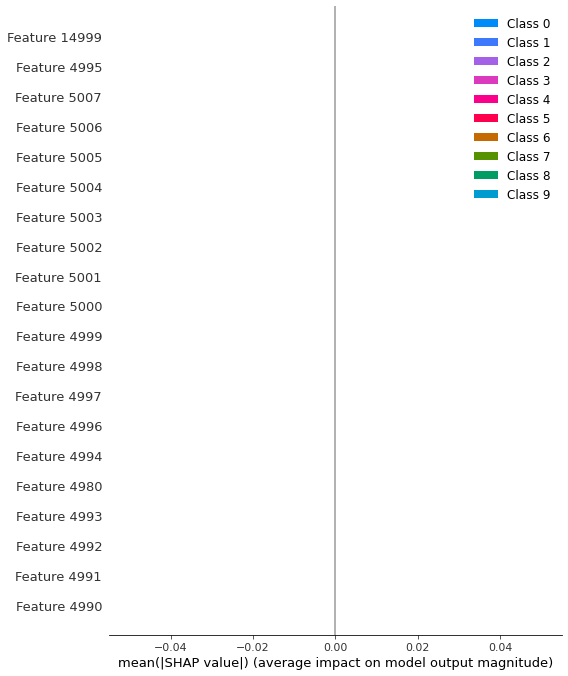

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


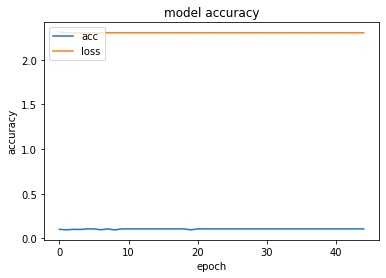

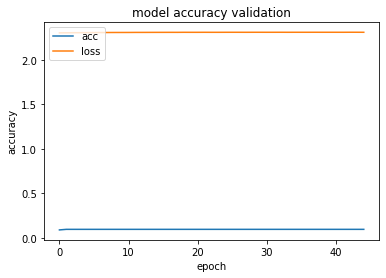

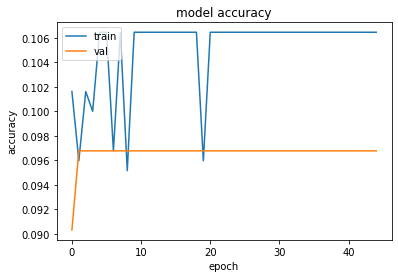

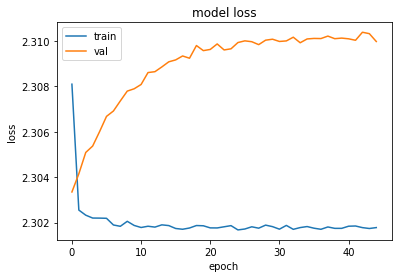

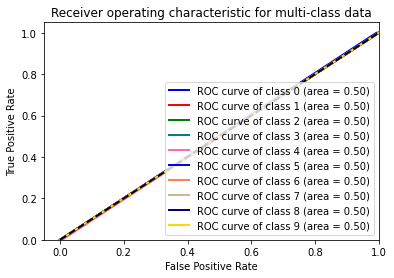

relu tanh


Singal=theta layer=relu optimizer=nadam
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 65s - loss: 2.3093 - acc: 0.1081 - val_loss: 2.3048 - val_acc: 0.0710
Epoch 3/100
1240/1240 - 65s - loss: 2.3027 - acc: 0.1024 - val_loss: 2.3058 - val_acc: 0.0710
Epoch 4/100
1240/1240 - 65s - loss: 2.3025 - acc: 0.1024 - val_loss: 2.3066 - val_acc: 0.0710
Epoch 5/100
1240/1240 - 65s - loss: 2.3024 - acc: 0.1024 - val_loss: 2.3074 - val_acc: 0.0710
Epoch 6/100
1240/1240 - 65s - loss: 2.3022 - acc: 0.1024 - val_loss: 2.3081 - val_acc: 0.0710
Epoch 7/100
1240/1240 - 65s - loss: 2.3021 - acc: 0.1024 - val_loss: 2.3087 - val_acc: 0.0710
Epoch 8/100
1240/1240 - 65s - loss: 2.3020 - acc: 0.0911 - val_loss: 2.3092 - val_acc: 0.0839
Epoch 9/100
1240/1240 - 66s - loss: 2.3020 - acc: 0.0968 - val_loss: 2.3095 - val_acc: 0.0839
Epoch 10/100
1240/1240 - 65s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3100 - val_acc: 0.0839
Epoch 11/100
1240/1240 - 65s - loss: 2.3019 - acc: 0.1065 - val_loss: 2.3101 - val_acc: 0.0839
Epoch 12/100
1240/1240 - 65s - loss: 2.3019 - acc: 0.1065 

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


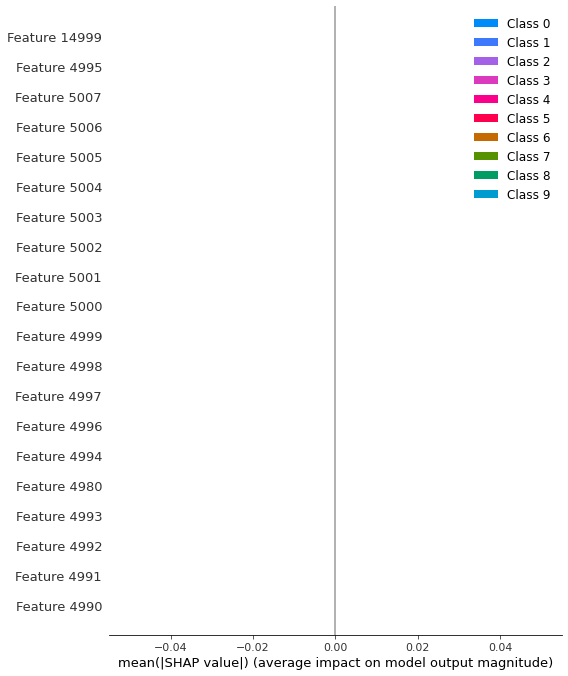

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


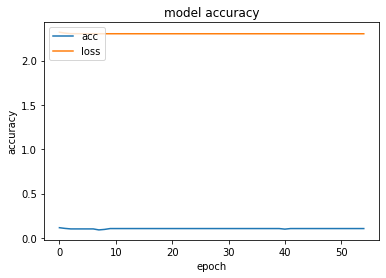

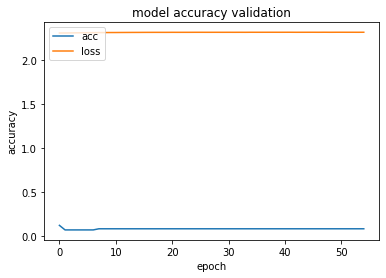

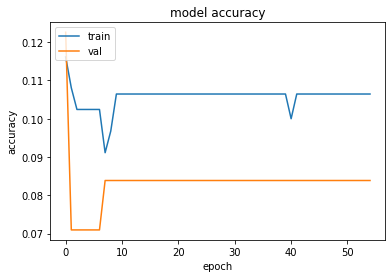

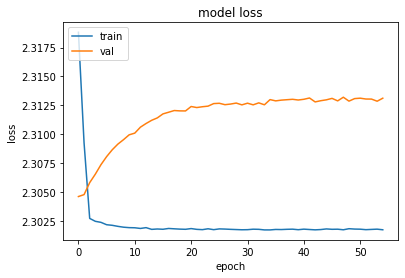

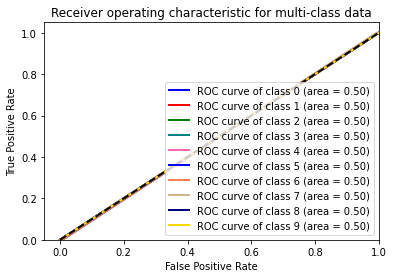

relu tanh


Singal=theta layer=relu optimizer=sgd
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________


`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 10s - loss: 1.2489 - acc: 0.7048 - val_loss: 0.9996 - val_acc: 0.8065
Epoch 3/100
1240/1240 - 10s - loss: 0.5801 - acc: 0.9597 - val_loss: 0.4571 - val_acc: 0.9935
Epoch 4/100
1240/1240 - 10s - loss: 0.2428 - acc: 0.9992 - val_loss: 0.2291 - val_acc: 0.9871
Epoch 5/100
1240/1240 - 10s - loss: 0.1188 - acc: 1.0000 - val_loss: 0.1465 - val_acc: 0.9871
Epoch 6/100
1240/1240 - 10s - loss: 0.0744 - acc: 1.0000 - val_loss: 0.1114 - val_acc: 0.9871
Epoch 7/100
1240/1240 - 10s - loss: 0.0539 - acc: 1.0000 - val_loss: 0.0981 - val_acc: 0.9871
Epoch 8/100
1240/1240 - 10s - loss: 0.0423 - acc: 1.0000 - val_loss: 0.0857 - val_acc: 0.9871
Epoch 9/100
1240/1240 - 10s - loss: 0.0347 - acc: 1.0000 - val_loss: 0.0784 - val_acc: 0.9871
Epoch 10/100
1240/1240 - 10s - loss: 0.0293 - acc: 1.0000 - val_loss: 0.0720 - val_acc: 0.9871
Epoch 11/100
1240/1240 - 10s - loss: 0.0254 - acc: 1.0000 - val_loss: 0.0668 - val_acc: 0.9871
Epoch 12/100
1240/1240 - 10s - loss: 0.0223 - acc: 1.0000 

Epoch 89/100
1240/1240 - 10s - loss: 0.0018 - acc: 1.0000 - val_loss: 0.0292 - val_acc: 0.9871
Epoch 90/100
1240/1240 - 10s - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0291 - val_acc: 0.9871
Epoch 91/100
1240/1240 - 10s - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0290 - val_acc: 0.9871
Epoch 92/100
1240/1240 - 10s - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0290 - val_acc: 0.9871
Epoch 93/100
1240/1240 - 10s - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0289 - val_acc: 0.9871
Epoch 94/100
1240/1240 - 10s - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0288 - val_acc: 0.9871
Epoch 95/100
1240/1240 - 10s - loss: 0.0016 - acc: 1.0000 - val_loss: 0.0288 - val_acc: 0.9871
Epoch 96/100
1240/1240 - 10s - loss: 0.0016 - acc: 1.0000 - val_loss: 0.0287 - val_acc: 0.9871
Epoch 97/100
1240/1240 - 10s - loss: 0.0016 - acc: 1.0000 - val_loss: 0.0286 - val_acc: 0.9871
Epoch 98/100
1240/1240 - 10s - loss: 0.0016 - acc: 1.0000 - val_loss: 0.0286 - val_acc: 0.9871
Epoch 99/100
1240/1240 - 10s - loss: 0.0016 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


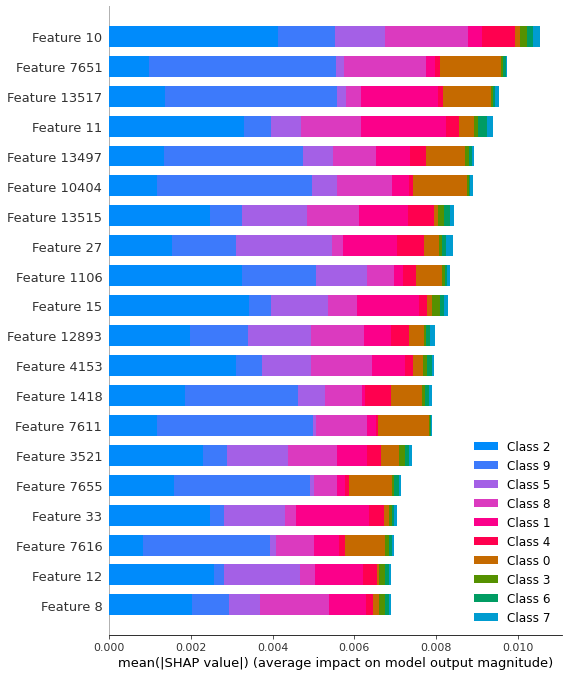

   class  sensitivity  specificity
0    1.0     0.906475          0.0
1    2.0     0.893617          0.0
2    3.0     0.892086          0.0
3    4.0     0.864286          0.0
4    5.0     0.904412          0.0
5    6.0     0.901408          0.0
6    7.0     0.893617          0.0
7    8.0     0.835714          0.0
8    9.0     0.910448          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.900206
specificity    0.000000
dtype: float64


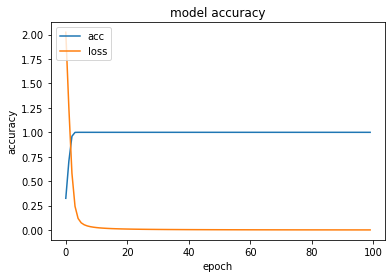

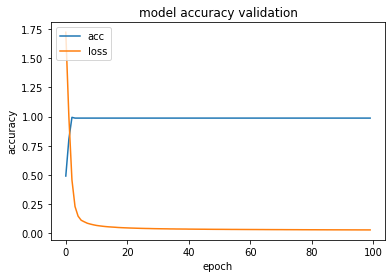

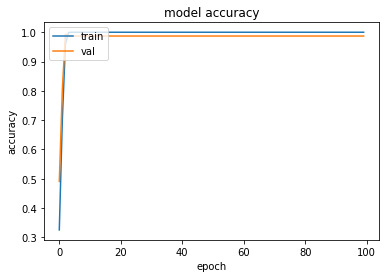

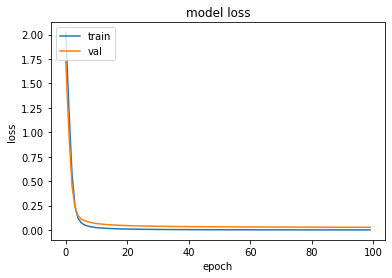

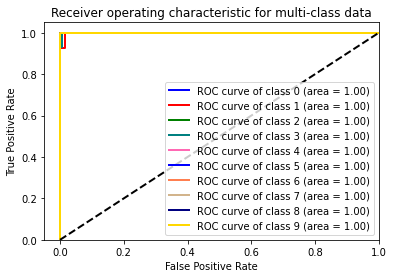

relu tanh


Singal=theta layer=relu optimizer=adadelta
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_____________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 21s - loss: 2.1646 - acc: 0.1992 - val_loss: 2.2447 - val_acc: 0.1355
Epoch 3/100
1240/1240 - 21s - loss: 2.0372 - acc: 0.2806 - val_loss: 2.1959 - val_acc: 0.1484
Epoch 4/100
1240/1240 - 21s - loss: 1.9422 - acc: 0.3548 - val_loss: 2.1547 - val_acc: 0.1935
Epoch 5/100
1240/1240 - 21s - loss: 1.8648 - acc: 0.4355 - val_loss: 2.1199 - val_acc: 0.2000
Epoch 6/100
1240/1240 - 21s - loss: 1.8005 - acc: 0.5081 - val_loss: 2.0885 - val_acc: 0.2258
Epoch 7/100
1240/1240 - 21s - loss: 1.7442 - acc: 0.5718 - val_loss: 2.0558 - val_acc: 0.2258
Epoch 8/100
1240/1240 - 21s - loss: 1.6954 - acc: 0.6274 - val_loss: 2.0268 - val_acc: 0.2516
Epoch 9/100
1240/1240 - 21s - loss: 1.6510 - acc: 0.6774 - val_loss: 1.9976 - val_acc: 0.2645
Epoch 10/100
1240/1240 - 21s - loss: 1.6115 - acc: 0.7274 - val_loss: 1.9700 - val_acc: 0.2839
Epoch 11/100
1240/1240 - 21s - loss: 1.5738 - acc: 0.7581 - val_loss: 1.9468 - val_acc: 0.2968
Epoch 12/100
1240/1240 - 21s - loss: 1.5403 - acc: 0.7726 

Epoch 89/100
1240/1240 - 20s - loss: 0.8182 - acc: 0.9968 - val_loss: 1.2158 - val_acc: 0.7935
Epoch 90/100
1240/1240 - 20s - loss: 0.8134 - acc: 0.9976 - val_loss: 1.2120 - val_acc: 0.7935
Epoch 91/100
1240/1240 - 20s - loss: 0.8088 - acc: 0.9976 - val_loss: 1.2060 - val_acc: 0.7935
Epoch 92/100
1240/1240 - 20s - loss: 0.8043 - acc: 0.9960 - val_loss: 1.2014 - val_acc: 0.7871
Epoch 93/100
1240/1240 - 20s - loss: 0.7999 - acc: 0.9960 - val_loss: 1.1957 - val_acc: 0.7871
Epoch 94/100
1240/1240 - 20s - loss: 0.7951 - acc: 0.9960 - val_loss: 1.1907 - val_acc: 0.8065
Epoch 95/100
1240/1240 - 20s - loss: 0.7905 - acc: 0.9976 - val_loss: 1.1874 - val_acc: 0.7935
Epoch 96/100
1240/1240 - 20s - loss: 0.7865 - acc: 0.9968 - val_loss: 1.1818 - val_acc: 0.7935
Epoch 97/100
1240/1240 - 21s - loss: 0.7818 - acc: 0.9976 - val_loss: 1.1774 - val_acc: 0.8000
Epoch 98/100
1240/1240 - 20s - loss: 0.7777 - acc: 0.9984 - val_loss: 1.1734 - val_acc: 0.8000
Epoch 99/100
1240/1240 - 20s - loss: 0.7732 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


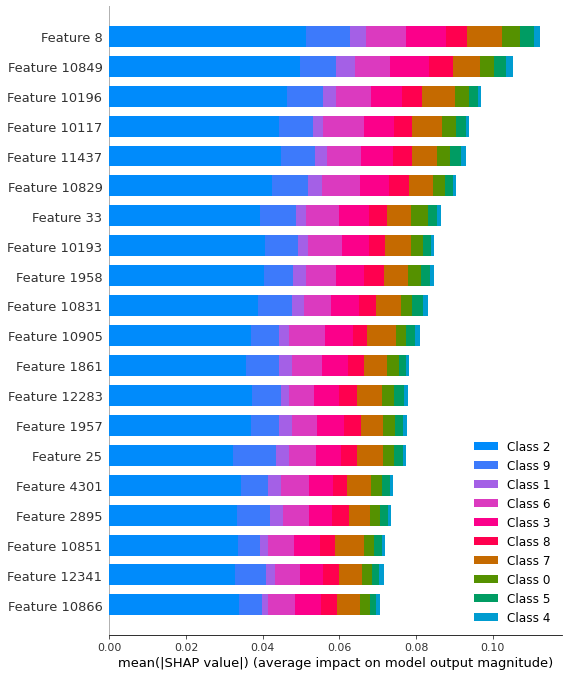

   class  sensitivity  specificity
0    1.0     0.913669     0.062500
1    2.0     0.934783     0.000000
2    3.0     0.784722     0.000000
3    4.0     0.918519     0.000000
4    5.0     0.892857     0.000000
5    6.0     0.856115     0.000000
6    7.0     0.928571     0.000000
7    8.0     0.907143     0.000000
8    9.0     0.855072     0.176471
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.899145
specificity    0.023897
dtype: float64


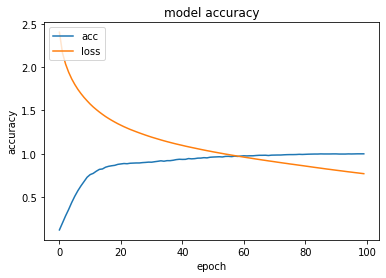

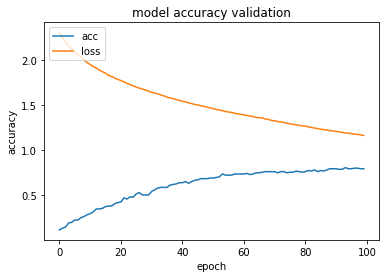

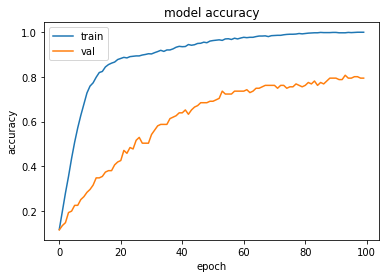

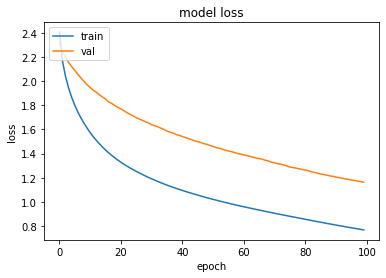

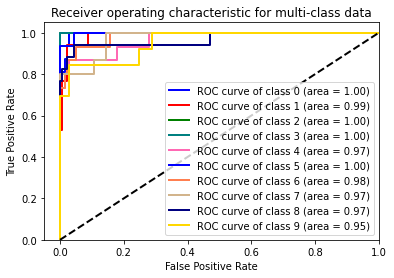

relu tanh


Singal=theta layer=relu optimizer=adagrad
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 18s - loss: 1.6565 - acc: 0.4734 - val_loss: 1.5488 - val_acc: 0.5290
Epoch 3/100
1240/1240 - 19s - loss: 1.3879 - acc: 0.6694 - val_loss: 1.3710 - val_acc: 0.6581
Epoch 4/100
1240/1240 - 19s - loss: 1.2161 - acc: 0.7734 - val_loss: 1.2553 - val_acc: 0.7419
Epoch 5/100
1240/1240 - 18s - loss: 1.0901 - acc: 0.8258 - val_loss: 1.1422 - val_acc: 0.8129
Epoch 6/100
1240/1240 - 19s - loss: 0.9911 - acc: 0.8694 - val_loss: 1.0654 - val_acc: 0.8258
Epoch 7/100
1240/1240 - 19s - loss: 0.9127 - acc: 0.8927 - val_loss: 1.0023 - val_acc: 0.8452
Epoch 8/100
1240/1240 - 19s - loss: 0.8455 - acc: 0.8935 - val_loss: 0.9387 - val_acc: 0.8710
Epoch 9/100
1240/1240 - 18s - loss: 0.7875 - acc: 0.8960 - val_loss: 0.8835 - val_acc: 0.8903
Epoch 10/100
1240/1240 - 19s - loss: 0.7343 - acc: 0.8984 - val_loss: 0.8345 - val_acc: 0.8839
Epoch 11/100
1240/1240 - 19s - loss: 0.6861 - acc: 0.9040 - val_loss: 0.7929 - val_acc: 0.8774
Epoch 12/100
1240/1240 - 19s - loss: 0.6420 - acc: 0.9105 

Epoch 89/100
1240/1240 - 19s - loss: 0.0889 - acc: 1.0000 - val_loss: 0.1867 - val_acc: 0.9677
Epoch 90/100
1240/1240 - 19s - loss: 0.0877 - acc: 1.0000 - val_loss: 0.1853 - val_acc: 0.9742
Epoch 91/100
1240/1240 - 19s - loss: 0.0866 - acc: 1.0000 - val_loss: 0.1836 - val_acc: 0.9742
Epoch 92/100
1240/1240 - 19s - loss: 0.0855 - acc: 1.0000 - val_loss: 0.1822 - val_acc: 0.9806
Epoch 93/100
1240/1240 - 19s - loss: 0.0844 - acc: 1.0000 - val_loss: 0.1810 - val_acc: 0.9742
Epoch 94/100
1240/1240 - 18s - loss: 0.0833 - acc: 1.0000 - val_loss: 0.1793 - val_acc: 0.9806
Epoch 95/100
1240/1240 - 19s - loss: 0.0822 - acc: 1.0000 - val_loss: 0.1781 - val_acc: 0.9742
Epoch 96/100
1240/1240 - 18s - loss: 0.0812 - acc: 1.0000 - val_loss: 0.1765 - val_acc: 0.9806
Epoch 97/100
1240/1240 - 18s - loss: 0.0802 - acc: 1.0000 - val_loss: 0.1752 - val_acc: 0.9806
Epoch 98/100
1240/1240 - 19s - loss: 0.0792 - acc: 1.0000 - val_loss: 0.1743 - val_acc: 0.9806
Epoch 99/100
1240/1240 - 19s - loss: 0.0783 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


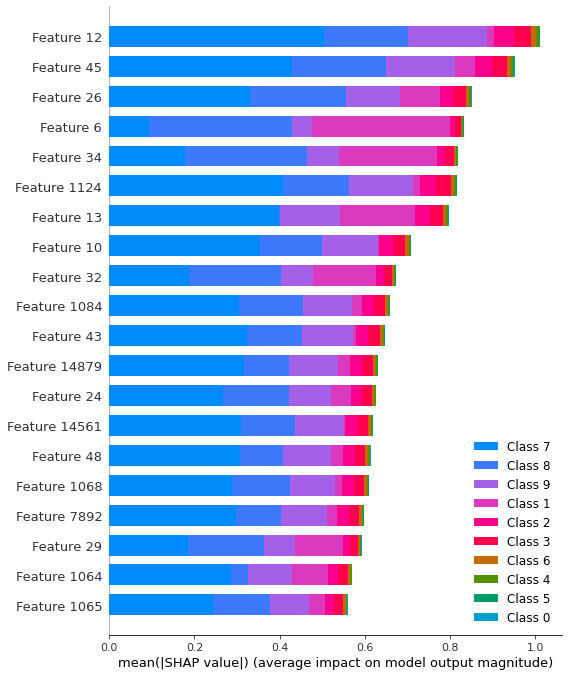

   class  sensitivity  specificity
0    1.0     0.873239          0.0
1    2.0     0.927007          0.0
2    3.0     0.834483          0.0
3    4.0     0.931298          0.0
4    5.0     0.896552          0.0
5    6.0     0.885714          0.0
6    7.0     0.920863          0.0
7    8.0     0.855172          0.0
8    9.0     0.864662          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.898899
specificity    0.000000
dtype: float64


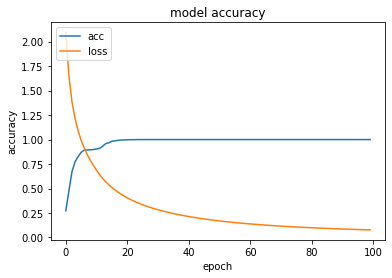

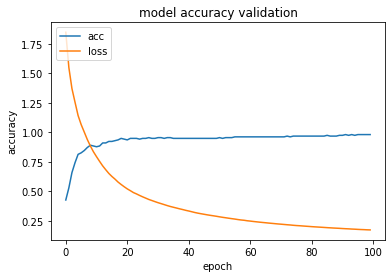

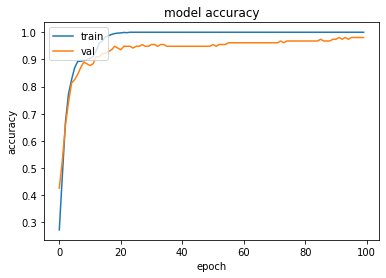

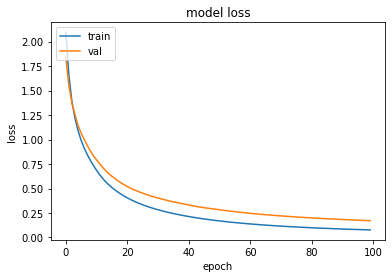

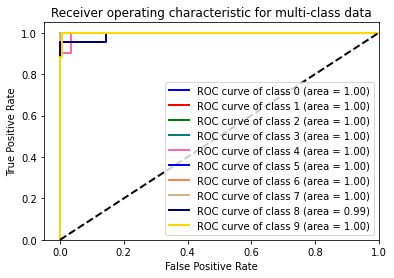

relu tanh


Singal=theta layer=relu optimizer=adamax
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 21s - loss: 1.8580 - acc: 0.3419 - val_loss: 1.6475 - val_acc: 0.4968
Epoch 3/100
1240/1240 - 22s - loss: 1.4083 - acc: 0.5363 - val_loss: 1.1425 - val_acc: 0.6968
Epoch 4/100
1240/1240 - 22s - loss: 1.0440 - acc: 0.6790 - val_loss: 1.0098 - val_acc: 0.6774
Epoch 5/100
1240/1240 - 22s - loss: 0.8109 - acc: 0.8024 - val_loss: 0.7736 - val_acc: 0.8387
Epoch 6/100
1240/1240 - 22s - loss: 0.6691 - acc: 0.8613 - val_loss: 0.5750 - val_acc: 0.8774
Epoch 7/100
1240/1240 - 22s - loss: 0.5086 - acc: 0.9202 - val_loss: 0.4294 - val_acc: 0.9290
Epoch 8/100
1240/1240 - 22s - loss: 0.3713 - acc: 0.9573 - val_loss: 0.3279 - val_acc: 0.9484
Epoch 9/100
1240/1240 - 22s - loss: 0.2613 - acc: 0.9742 - val_loss: 0.2860 - val_acc: 0.9419
Epoch 10/100
1240/1240 - 21s - loss: 0.1910 - acc: 0.9815 - val_loss: 0.2736 - val_acc: 0.9290
Epoch 11/100
1240/1240 - 22s - loss: 0.1412 - acc: 0.9911 - val_loss: 0.2146 - val_acc: 0.9613
Epoch 12/100
1240/1240 - 22s - loss: 0.1160 - acc: 0.9855 

Epoch 87/100
1240/1240 - 19s - loss: 1.9746e-06 - acc: 1.0000 - val_loss: 0.1032 - val_acc: 0.9871
Epoch 88/100
1240/1240 - 19s - loss: 1.7279e-06 - acc: 1.0000 - val_loss: 0.1068 - val_acc: 0.9871
Epoch 89/100
1240/1240 - 19s - loss: 1.5108e-06 - acc: 1.0000 - val_loss: 0.1070 - val_acc: 0.9871
Epoch 90/100
1240/1240 - 19s - loss: 1.3210e-06 - acc: 1.0000 - val_loss: 0.1090 - val_acc: 0.9871
Epoch 91/100
1240/1240 - 19s - loss: 1.1526e-06 - acc: 1.0000 - val_loss: 0.1107 - val_acc: 0.9871
Epoch 92/100
1240/1240 - 19s - loss: 1.0048e-06 - acc: 1.0000 - val_loss: 0.1075 - val_acc: 0.9871
Epoch 93/100
1240/1240 - 19s - loss: 8.8407e-07 - acc: 1.0000 - val_loss: 0.1147 - val_acc: 0.9871
Epoch 94/100
1240/1240 - 19s - loss: 7.6621e-07 - acc: 1.0000 - val_loss: 0.1080 - val_acc: 0.9871
Epoch 95/100
1240/1240 - 19s - loss: 6.7065e-07 - acc: 1.0000 - val_loss: 0.1107 - val_acc: 0.9871
Epoch 96/100
1240/1240 - 19s - loss: 5.9057e-07 - acc: 1.0000 - val_loss: 0.1123 - val_acc: 0.9871
Epoch 97/1

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


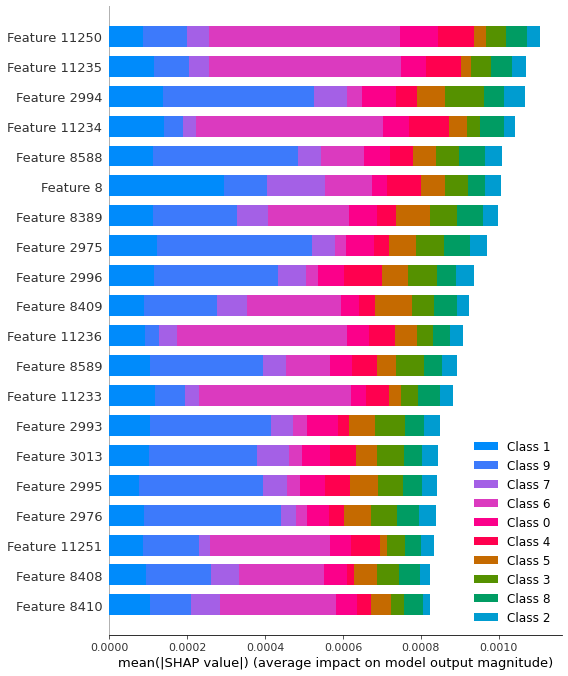

   class  sensitivity  specificity
0    1.0     0.852113          0.0
1    2.0     0.896296          0.0
2    3.0     0.878571          0.0
3    4.0     0.891304          0.0
4    5.0     0.871429          0.0
5    6.0     0.927536          0.0
6    7.0     0.889655          0.0
7    8.0     0.884892          0.0
8    9.0     0.912409          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.900421
specificity    0.000000
dtype: float64


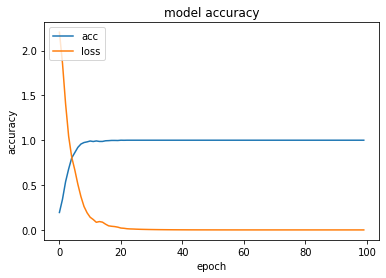

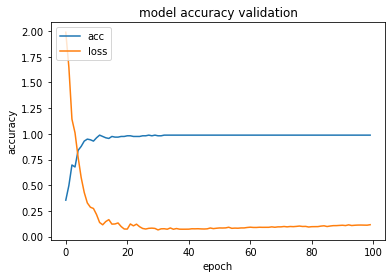

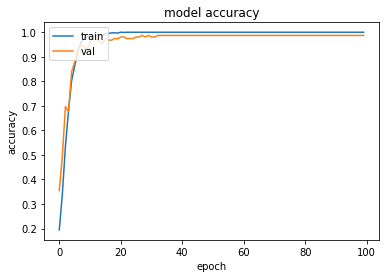

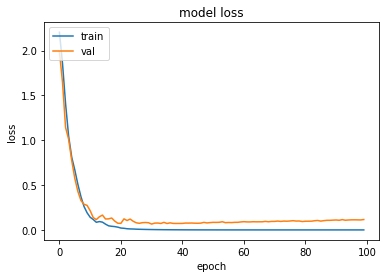

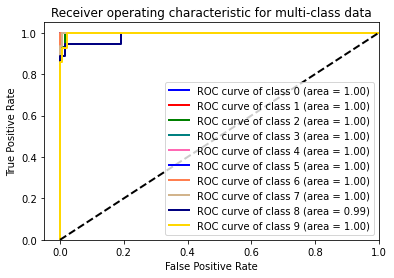

relu tanh


Singal=theta layer=relu optimizer=ftrl
theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 25s - loss: 2.3026 - acc: 0.1065 - val_loss: 2.3028 - val_acc: 0.0839
Epoch 3/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3029 - val_acc: 0.0839
Epoch 4/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3030 - val_acc: 0.0839
Epoch 5/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3030 - val_acc: 0.0839
Epoch 6/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0839
Epoch 7/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0839
Epoch 8/100
1240/1240 - 25s - loss: 2.3025 - acc: 0.1065 - val_loss: 2.3031 - val_acc: 0.0839
Epoch 9/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0839
Epoch 10/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0839
Epoch 11/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 - val_loss: 2.3032 - val_acc: 0.0839
Epoch 12/100
1240/1240 - 25s - loss: 2.3024 - acc: 0.1065 

Epoch 89/100
1240/1240 - 23s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3044 - val_acc: 0.0839
Epoch 90/100
1240/1240 - 23s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3044 - val_acc: 0.0839
Epoch 91/100
1240/1240 - 23s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3044 - val_acc: 0.0839
Epoch 92/100
1240/1240 - 23s - loss: 2.3022 - acc: 0.1065 - val_loss: 2.3044 - val_acc: 0.0839
Epoch 93/100
1240/1240 - 23s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0839
Epoch 94/100
1240/1240 - 23s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0839
Epoch 95/100
1240/1240 - 23s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0839
Epoch 96/100
1240/1240 - 23s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0839
Epoch 97/100
1240/1240 - 23s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0839
Epoch 98/100
1240/1240 - 23s - loss: 2.3021 - acc: 0.1065 - val_loss: 2.3045 - val_acc: 0.0839
Epoch 99/100
1240/1240 - 23s - loss: 2.3021 - acc:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


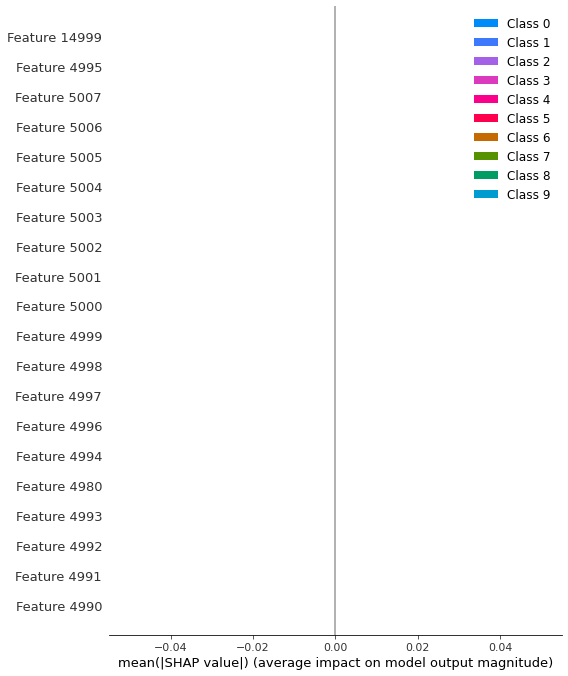

   class  sensitivity  specificity
0    1.0          1.0          0.0
1    2.0          0.0          1.0
2    3.0          1.0          0.0
3    4.0          1.0          0.0
4    5.0          1.0          0.0
5    6.0          1.0          0.0
6    7.0          1.0          0.0
7    8.0          1.0          0.0
8    9.0          1.0          0.0
9   10.0          1.0          0.0
class          5.5
sensitivity    0.9
specificity    0.1
dtype: float64


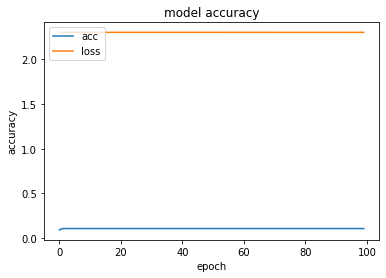

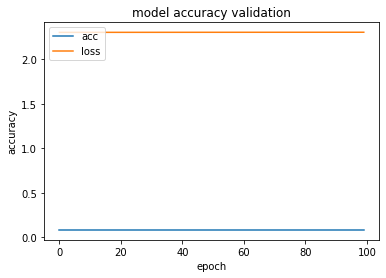

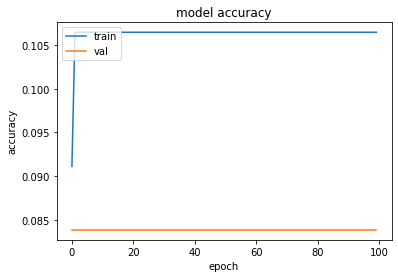

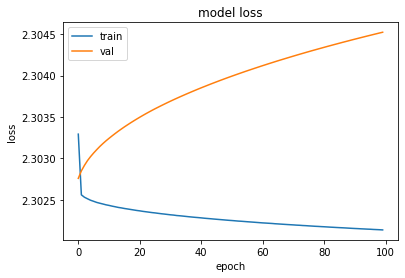

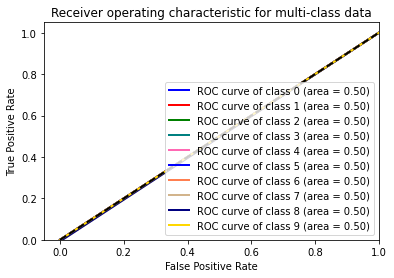

tanh tanh


Singal=alpha layer=tanh optimizer=rmsprop
alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
______________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 38s - loss: 0.6009 - acc: 0.9113 - val_loss: 0.6255 - val_acc: 0.8774
Epoch 3/100
1240/1240 - 38s - loss: 0.3264 - acc: 0.9500 - val_loss: 0.4078 - val_acc: 0.8968
Epoch 4/100
1240/1240 - 38s - loss: 0.1714 - acc: 0.9726 - val_loss: 0.3375 - val_acc: 0.9226
Epoch 5/100
1240/1240 - 38s - loss: 0.1001 - acc: 0.9823 - val_loss: 0.2300 - val_acc: 0.9290
Epoch 6/100
1240/1240 - 38s - loss: 0.0607 - acc: 0.9919 - val_loss: 0.2451 - val_acc: 0.9355
Epoch 7/100
1240/1240 - 38s - loss: 0.0489 - acc: 0.9927 - val_loss: 0.2661 - val_acc: 0.9419
Epoch 8/100
1240/1240 - 38s - loss: 0.0197 - acc: 0.9952 - val_loss: 0.2745 - val_acc: 0.9419
Epoch 9/100
1240/1240 - 38s - loss: 0.0155 - acc: 0.9976 - val_loss: 0.2373 - val_acc: 0.9548
Epoch 10/100
1240/1240 - 38s - loss: 0.0145 - acc: 0.9952 - val_loss: 0.2382 - val_acc: 0.9355
Epoch 11/100
1240/1240 - 38s - loss: 0.0014 - acc: 1.0000 - val_loss: 0.2125 - val_acc: 0.9484
Epoch 12/100
1240/1240 - 38s - loss: 5.3462e-04 - acc: 1.0

Epoch 86/100
1240/1240 - 38s - loss: 5.7682e-10 - acc: 1.0000 - val_loss: 0.2918 - val_acc: 0.9613
Epoch 87/100
1240/1240 - 38s - loss: 7.6909e-10 - acc: 1.0000 - val_loss: 0.2917 - val_acc: 0.9613
Epoch 88/100
1240/1240 - 38s - loss: 7.6909e-10 - acc: 1.0000 - val_loss: 0.2915 - val_acc: 0.9613
Epoch 89/100
1240/1240 - 38s - loss: 5.7682e-10 - acc: 1.0000 - val_loss: 0.2914 - val_acc: 0.9613
Epoch 90/100
1240/1240 - 38s - loss: 7.6909e-10 - acc: 1.0000 - val_loss: 0.2913 - val_acc: 0.9613
Epoch 91/100
1240/1240 - 38s - loss: 4.8068e-10 - acc: 1.0000 - val_loss: 0.2912 - val_acc: 0.9613
Epoch 92/100
1240/1240 - 38s - loss: 5.7682e-10 - acc: 1.0000 - val_loss: 0.2910 - val_acc: 0.9613
Epoch 93/100
1240/1240 - 38s - loss: 5.7682e-10 - acc: 1.0000 - val_loss: 0.2909 - val_acc: 0.9613
Epoch 94/100
1240/1240 - 38s - loss: 6.7296e-10 - acc: 1.0000 - val_loss: 0.2908 - val_acc: 0.9613
Epoch 95/100
1240/1240 - 38s - loss: 4.8068e-10 - acc: 1.0000 - val_loss: 0.2908 - val_acc: 0.9613
Epoch 96/1

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


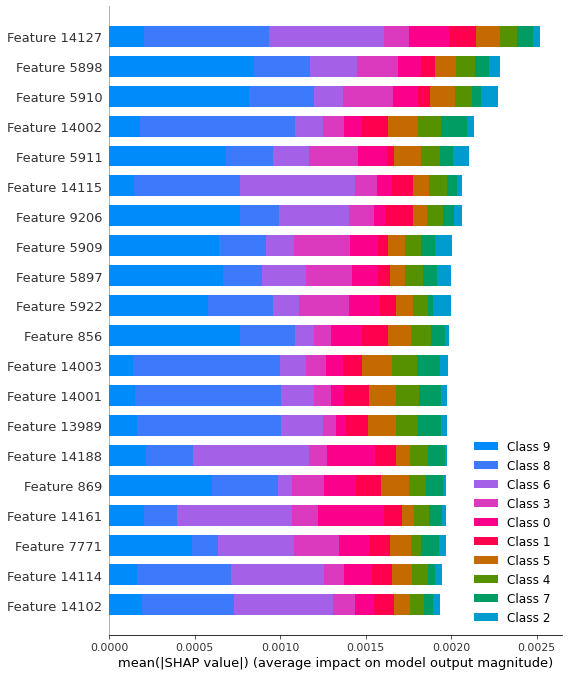

   class  sensitivity  specificity
0    1.0     0.879433          0.0
1    2.0     0.926471          0.0
2    3.0     0.881944          0.0
3    4.0     0.905797          0.0
4    5.0     0.901408          0.0
5    6.0     0.893617          0.0
6    7.0     0.884892          0.0
7    8.0     0.850000          0.0
8    9.0     0.881481          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.900504
specificity    0.000000
dtype: float64


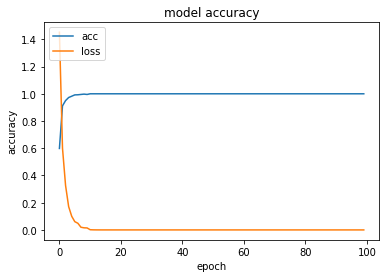

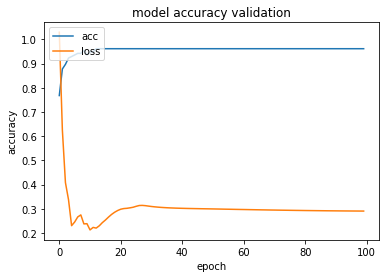

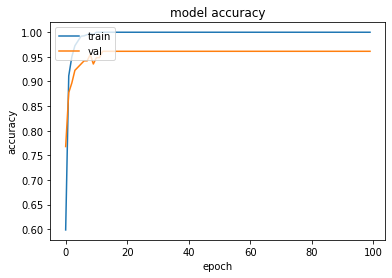

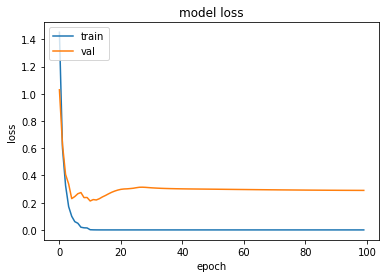

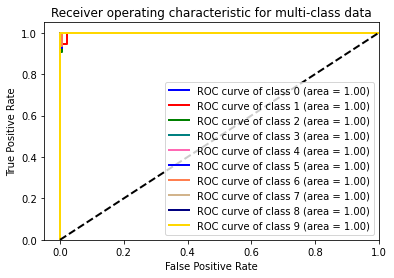

tanh tanh


Singal=alpha layer=tanh optimizer=adam
alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 17s - loss: 0.6046 - acc: 0.9024 - val_loss: 0.5915 - val_acc: 0.8774
Epoch 3/100
1240/1240 - 17s - loss: 0.3377 - acc: 0.9492 - val_loss: 0.4268 - val_acc: 0.9161
Epoch 4/100
1240/1240 - 17s - loss: 0.1937 - acc: 0.9766 - val_loss: 0.3544 - val_acc: 0.9032
Epoch 5/100
1240/1240 - 17s - loss: 0.1088 - acc: 0.9911 - val_loss: 0.2395 - val_acc: 0.9419
Epoch 6/100
1240/1240 - 17s - loss: 0.0746 - acc: 0.9927 - val_loss: 0.3340 - val_acc: 0.9161
Epoch 7/100
1240/1240 - 17s - loss: 0.0925 - acc: 0.9839 - val_loss: 0.3645 - val_acc: 0.9032
Epoch 8/100
1240/1240 - 17s - loss: 0.1506 - acc: 0.9677 - val_loss: 0.5258 - val_acc: 0.8581
Epoch 9/100
1240/1240 - 17s - loss: 0.1221 - acc: 0.9726 - val_loss: 0.2598 - val_acc: 0.9355
Epoch 10/100
1240/1240 - 17s - loss: 0.0657 - acc: 0.9863 - val_loss: 0.2986 - val_acc: 0.9097
Epoch 11/100
1240/1240 - 17s - loss: 0.0334 - acc: 0.9960 - val_loss: 0.3105 - val_acc: 0.9226
Epoch 12/100
1240/1240 - 17s - loss: 0.0170 - acc: 0.9992 

Epoch 87/100
1240/1240 - 17s - loss: 5.7142e-05 - acc: 1.0000 - val_loss: 0.3444 - val_acc: 0.9355
Epoch 88/100
1240/1240 - 17s - loss: 5.3709e-05 - acc: 1.0000 - val_loss: 0.3459 - val_acc: 0.9355
Epoch 89/100
1240/1240 - 17s - loss: 5.0465e-05 - acc: 1.0000 - val_loss: 0.3474 - val_acc: 0.9355
Epoch 90/100
1240/1240 - 17s - loss: 4.7425e-05 - acc: 1.0000 - val_loss: 0.3488 - val_acc: 0.9355
Epoch 91/100
1240/1240 - 17s - loss: 4.4581e-05 - acc: 1.0000 - val_loss: 0.3504 - val_acc: 0.9355
Epoch 92/100
1240/1240 - 17s - loss: 4.1893e-05 - acc: 1.0000 - val_loss: 0.3519 - val_acc: 0.9355
Epoch 93/100
1240/1240 - 17s - loss: 3.9373e-05 - acc: 1.0000 - val_loss: 0.3533 - val_acc: 0.9355
Epoch 94/100
1240/1240 - 17s - loss: 3.7002e-05 - acc: 1.0000 - val_loss: 0.3547 - val_acc: 0.9355
Epoch 95/100
1240/1240 - 17s - loss: 3.4790e-05 - acc: 1.0000 - val_loss: 0.3562 - val_acc: 0.9355
Epoch 96/100
1240/1240 - 17s - loss: 3.2695e-05 - acc: 1.0000 - val_loss: 0.3576 - val_acc: 0.9355
Epoch 97/1

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


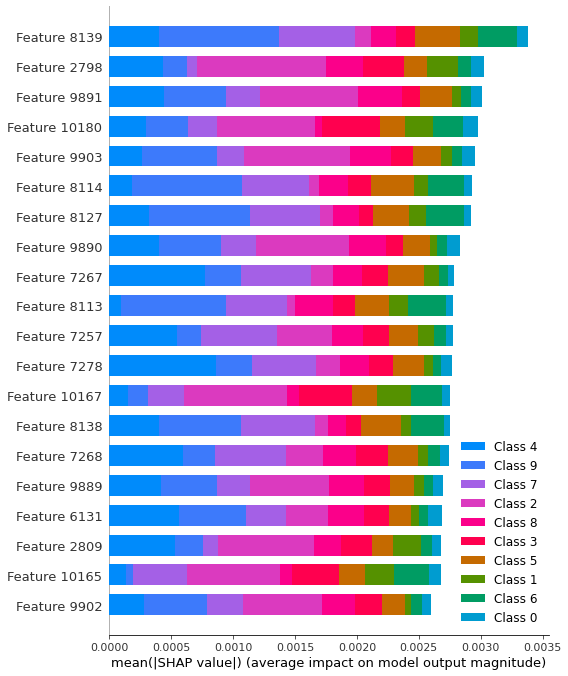

   class  sensitivity  specificity
0    1.0     0.896552          0.0
1    2.0     0.919708          0.0
2    3.0     0.883562          0.0
3    4.0     0.921986          0.0
4    5.0     0.867133          0.0
5    6.0     0.897059          0.0
6    7.0     0.871429          0.0
7    8.0     0.805755          0.0
8    9.0     0.897638          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.896082
specificity    0.000000
dtype: float64


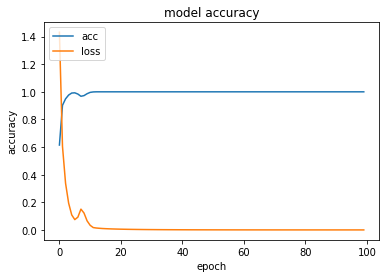

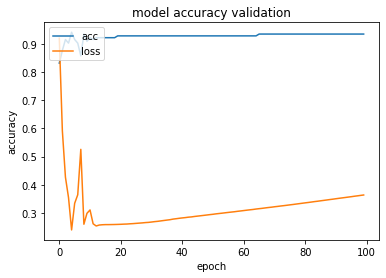

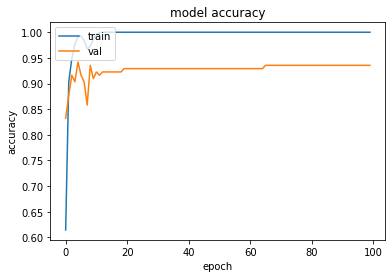

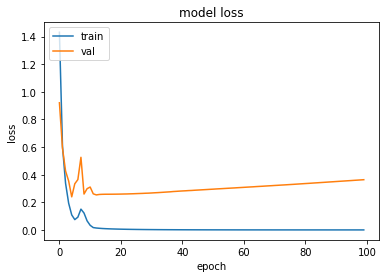

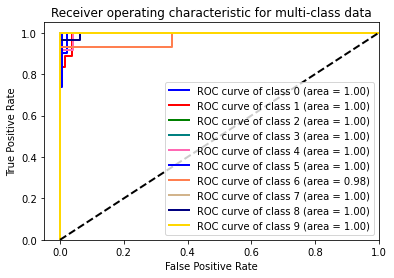

tanh tanh


Singal=alpha layer=tanh optimizer=nadam
alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
________________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 65s - loss: 0.5206 - acc: 0.9169 - val_loss: 0.4939 - val_acc: 0.9097
Epoch 3/100
1240/1240 - 65s - loss: 0.3113 - acc: 0.9444 - val_loss: 0.4199 - val_acc: 0.8903
Epoch 4/100
1240/1240 - 65s - loss: 0.2626 - acc: 0.9484 - val_loss: 0.3249 - val_acc: 0.9226
Epoch 5/100
1240/1240 - 66s - loss: 0.1494 - acc: 0.9774 - val_loss: 0.2388 - val_acc: 0.9290
Epoch 6/100
1240/1240 - 65s - loss: 0.1048 - acc: 0.9863 - val_loss: 0.2947 - val_acc: 0.9290
Epoch 7/100
1240/1240 - 65s - loss: 0.0840 - acc: 0.9855 - val_loss: 0.1866 - val_acc: 0.9677
Epoch 8/100
1240/1240 - 65s - loss: 0.0452 - acc: 0.9952 - val_loss: 0.1874 - val_acc: 0.9548
Epoch 9/100
1240/1240 - 66s - loss: 0.0555 - acc: 0.9911 - val_loss: 0.1604 - val_acc: 0.9613
Epoch 10/100
1240/1240 - 65s - loss: 0.0237 - acc: 0.9992 - val_loss: 0.1297 - val_acc: 0.9742
Epoch 11/100
1240/1240 - 65s - loss: 0.0170 - acc: 1.0000 - val_loss: 0.1321 - val_acc: 0.9742
Epoch 12/100
1240/1240 - 65s - loss: 0.0134 - acc: 1.0000 

Epoch 87/100
1240/1240 - 65s - loss: 4.7161e-05 - acc: 1.0000 - val_loss: 0.1534 - val_acc: 0.9677
Epoch 88/100
1240/1240 - 65s - loss: 4.4310e-05 - acc: 1.0000 - val_loss: 0.1540 - val_acc: 0.9677
Epoch 89/100
1240/1240 - 66s - loss: 4.1624e-05 - acc: 1.0000 - val_loss: 0.1547 - val_acc: 0.9677
Epoch 90/100
1240/1240 - 66s - loss: 3.9106e-05 - acc: 1.0000 - val_loss: 0.1554 - val_acc: 0.9677
Epoch 91/100
1240/1240 - 65s - loss: 3.6745e-05 - acc: 1.0000 - val_loss: 0.1560 - val_acc: 0.9677
Epoch 92/100
1240/1240 - 65s - loss: 3.4527e-05 - acc: 1.0000 - val_loss: 0.1567 - val_acc: 0.9677
Epoch 93/100
1240/1240 - 65s - loss: 3.2443e-05 - acc: 1.0000 - val_loss: 0.1574 - val_acc: 0.9677
Epoch 94/100
1240/1240 - 65s - loss: 3.0492e-05 - acc: 1.0000 - val_loss: 0.1580 - val_acc: 0.9677
Epoch 95/100
1240/1240 - 66s - loss: 2.8644e-05 - acc: 1.0000 - val_loss: 0.1587 - val_acc: 0.9677
Epoch 96/100
1240/1240 - 65s - loss: 2.6910e-05 - acc: 1.0000 - val_loss: 0.1593 - val_acc: 0.9677
Epoch 97/1

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


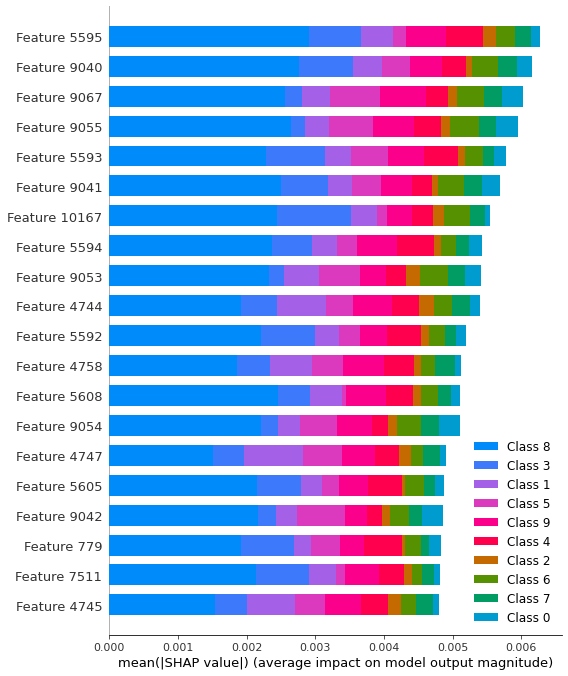

   class  sensitivity  specificity
0    1.0     0.864865     0.000000
1    2.0     0.902985     0.047619
2    3.0     0.833333     0.000000
3    4.0     0.880597     0.000000
4    5.0     0.891304     0.000000
5    6.0     0.914286     0.000000
6    7.0     0.900709     0.000000
7    8.0     0.893617     0.000000
8    9.0     0.876812     0.000000
9   10.0     1.000000     0.000000
class          5.500000
sensitivity    0.895851
specificity    0.004762
dtype: float64


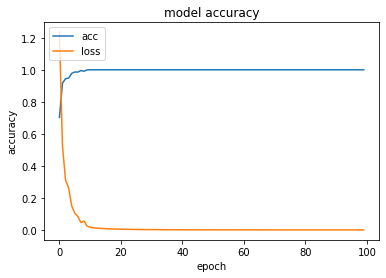

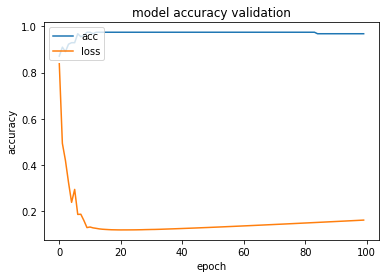

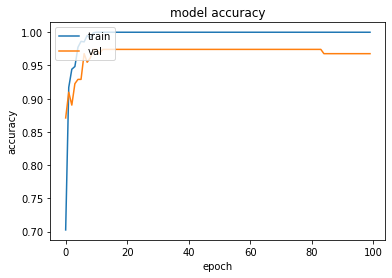

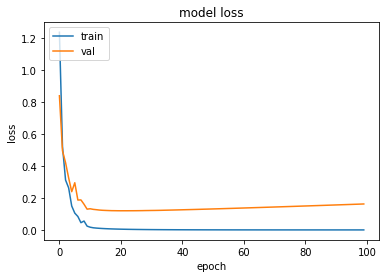

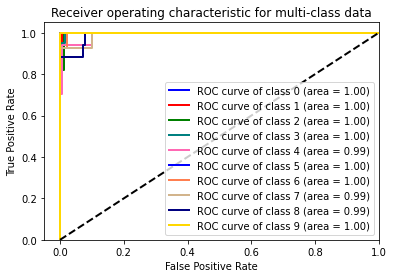

tanh tanh


Singal=alpha layer=tanh optimizer=sgd
alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________


`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 10s - loss: 0.6014 - acc: 0.9935 - val_loss: 0.6454 - val_acc: 0.9677
Epoch 3/100
1240/1240 - 10s - loss: 0.3618 - acc: 1.0000 - val_loss: 0.4933 - val_acc: 0.9742
Epoch 4/100
1240/1240 - 10s - loss: 0.2529 - acc: 1.0000 - val_loss: 0.4110 - val_acc: 0.9742
Epoch 5/100
1240/1240 - 10s - loss: 0.1933 - acc: 1.0000 - val_loss: 0.3573 - val_acc: 0.9742
Epoch 6/100
1240/1240 - 10s - loss: 0.1556 - acc: 1.0000 - val_loss: 0.3198 - val_acc: 0.9742
Epoch 7/100
1240/1240 - 10s - loss: 0.1295 - acc: 1.0000 - val_loss: 0.2919 - val_acc: 0.9742
Epoch 8/100
1240/1240 - 10s - loss: 0.1106 - acc: 1.0000 - val_loss: 0.2705 - val_acc: 0.9742
Epoch 9/100
1240/1240 - 10s - loss: 0.0962 - acc: 1.0000 - val_loss: 0.2536 - val_acc: 0.9742
Epoch 10/100
1240/1240 - 10s - loss: 0.0850 - acc: 1.0000 - val_loss: 0.2399 - val_acc: 0.9677
Epoch 11/100
1240/1240 - 10s - loss: 0.0760 - acc: 1.0000 - val_loss: 0.2286 - val_acc: 0.9677
Epoch 12/100
1240/1240 - 10s - loss: 0.0687 - acc: 1.0000 

Epoch 89/100
1240/1240 - 10s - loss: 0.0072 - acc: 1.0000 - val_loss: 0.1323 - val_acc: 0.9677
Epoch 90/100
1240/1240 - 10s - loss: 0.0071 - acc: 1.0000 - val_loss: 0.1322 - val_acc: 0.9677
Epoch 91/100
1240/1240 - 10s - loss: 0.0071 - acc: 1.0000 - val_loss: 0.1321 - val_acc: 0.9677
Epoch 92/100
1240/1240 - 10s - loss: 0.0070 - acc: 1.0000 - val_loss: 0.1320 - val_acc: 0.9677
Epoch 93/100
1240/1240 - 10s - loss: 0.0069 - acc: 1.0000 - val_loss: 0.1319 - val_acc: 0.9677
Epoch 94/100
1240/1240 - 10s - loss: 0.0068 - acc: 1.0000 - val_loss: 0.1318 - val_acc: 0.9677
Epoch 95/100
1240/1240 - 10s - loss: 0.0067 - acc: 1.0000 - val_loss: 0.1317 - val_acc: 0.9677
Epoch 96/100
1240/1240 - 10s - loss: 0.0067 - acc: 1.0000 - val_loss: 0.1316 - val_acc: 0.9677
Epoch 97/100
1240/1240 - 10s - loss: 0.0066 - acc: 1.0000 - val_loss: 0.1315 - val_acc: 0.9677
Epoch 98/100
1240/1240 - 10s - loss: 0.0065 - acc: 1.0000 - val_loss: 0.1314 - val_acc: 0.9677
Epoch 99/100
1240/1240 - 10s - loss: 0.0064 - acc:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


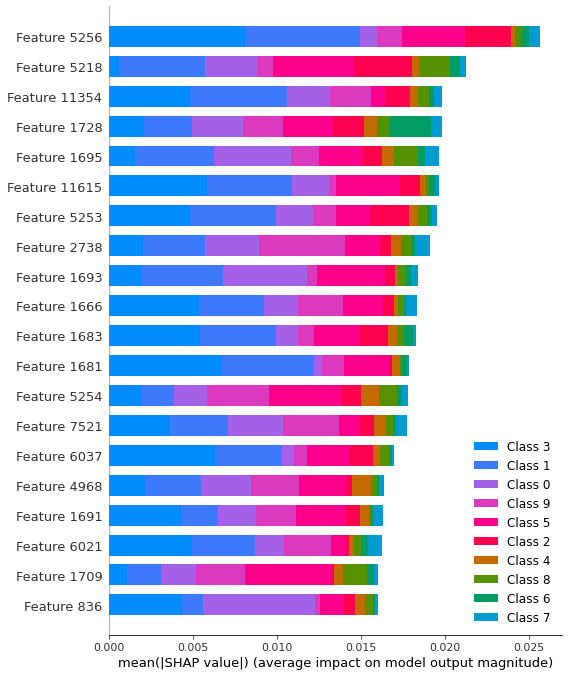

   class  sensitivity  specificity
0    1.0     0.841379          0.0
1    2.0     0.930769          0.0
2    3.0     0.869863          0.0
3    4.0     0.876812          0.0
4    5.0     0.890511          0.0
5    6.0     0.908451          0.0
6    7.0     0.907801          0.0
7    8.0     0.845070          0.0
8    9.0     0.894737          0.0
9   10.0     1.000000          0.0
class          5.500000
sensitivity    0.896539
specificity    0.000000
dtype: float64


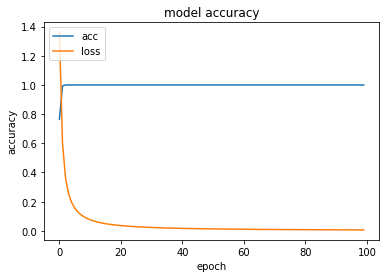

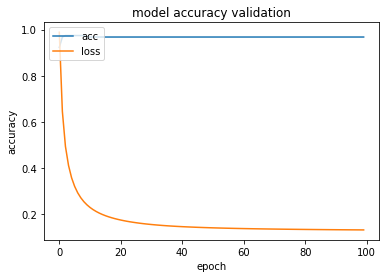

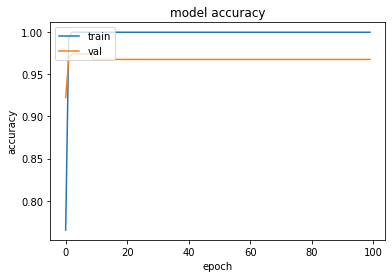

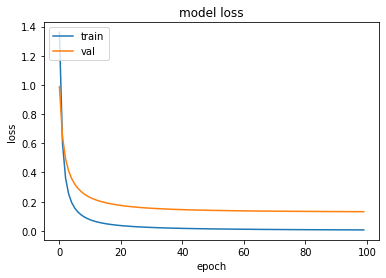

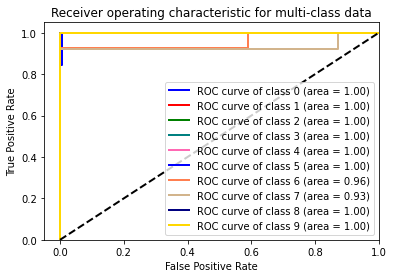

tanh tanh


Singal=alpha layer=tanh optimizer=adadelta
alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_____________________________________________________________

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Epoch 2/100
1240/1240 - 21s - loss: 2.0826 - acc: 0.2790 - val_loss: 2.1658 - val_acc: 0.1935
Epoch 3/100
1240/1240 - 21s - loss: 1.9355 - acc: 0.4218 - val_loss: 2.1044 - val_acc: 0.2645
Epoch 4/100
1240/1240 - 21s - loss: 1.8168 - acc: 0.5484 - val_loss: 2.0493 - val_acc: 0.3097
Epoch 5/100
1240/1240 - 21s - loss: 1.7176 - acc: 0.6645 - val_loss: 1.9991 - val_acc: 0.3613
Epoch 6/100
1240/1240 - 21s - loss: 1.6336 - acc: 0.7403 - val_loss: 1.9529 - val_acc: 0.4129
Epoch 7/100
1240/1240 - 21s - loss: 1.5614 - acc: 0.8016 - val_loss: 1.9101 - val_acc: 0.4581
Epoch 8/100
1240/1240 - 21s - loss: 1.4985 - acc: 0.8452 - val_loss: 1.8705 - val_acc: 0.5032
Epoch 9/100
1240/1240 - 21s - loss: 1.4432 - acc: 0.8815 - val_loss: 1.8334 - val_acc: 0.5355
Epoch 10/100
1240/1240 - 21s - loss: 1.3940 - acc: 0.9097 - val_loss: 1.7988 - val_acc: 0.6000
Epoch 11/100
1240/1240 - 21s - loss: 1.3500 - acc: 0.9331 - val_loss: 1.7668 - val_acc: 0.6452
Epoch 12/100
1240/1240 - 21s - loss: 1.3107 - acc: 0.9548 

In [ ]:
for s in sig:
    for l in layer:
        for o in optimizer:
            modelidea(s,l,o)
